# Exploratory Descriptive Analysis
## Hearth Disease Failure
----------------------------------

### Project 7:
### Team 7
### Authors: Juan Maya - Mario Palomino - Sandaru Welikala
----------------------------------------------------------

## Introduction
***"A problem is a chance for you to do your best."*** *Duke Ellington*

In this report we will be looking and handling data about patients that had been admitted to the ICU, with problems related to hearth deceased. The scope of the study is to explore the data, recognize and clean the data in order to obtain a clean input to make a further selection or manipulation in the features that can give us the most information to run a machine learning model in the phase 2.

**Remember to answer the 5W questions: What? When? Where? How? Why?**
---------------------------------------------------------------------

---------------------------------------------------------------------

**LIBRARIES**

In [1]:
import pandas as pd
import numpy as np
from scipy.stats import shapiro, kstest, normaltest, chi2_contingency, mannwhitneyu, norm, ttest_rel, wilcoxon, pearsonr, spearmanr
import matplotlib.pyplot as plt
import seaborn as sns

import pprint
import warnings

In [2]:
pp = pprint.PrettyPrinter(indent=4)
warnings.filterwarnings("ignore")

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

**LOADING DATA**

In [3]:
mimic_iv = pd.read_csv("MIMIC-IV-data-extraced.csv")
mimic_iv.head(5)

,subject_id,gender,age,mortality,ethnicity,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Arterial Blood Pressure systolic,Non Invasive Blood Pressure systolic,Arterial Blood Pressure diastolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,Respiratory Rate (Set),Respiratory Rate (spontaneous),Respiratory Rate (Total),SpO2 Desat Limit,INR,Prothrombin time,Anion gap,Creatinine (serum),Temperature,"Potassium, Whole Blood-2",Potassium (whole blood),Sodium (whole blood),"Sodium, Whole Blood","Chloride, Whole Blood",Chloride (whole blood),Bicarbonate,Glucose (whole blood),GCS - Eye Opening,Hemoglobin,Hemoglobin-2,Hematocrit,Platelet Count,"Acute myocardial infarction of anterolateral wall, episode of c","Acute myocardial infarction of anterolateral wall, initial epis","Acute myocardial infarction of anterolateral wall, subsequent e","Acute myocardial infarction of other anterior wall, episode of","Acute myocardial infarction of other anterior wall, initial epi","Acute myocardial infarction of other anterior wall, subsequent","Acute myocardial infarction of inferolateral wall, episode of c","Acute myocardial infarction of inferolateral wall, initial epis","Acute myocardial infarction of inferolateral wall, subsequent e","Acute myocardial infarction of inferoposterior wall, episode of","Acute myocardial infarction of inferoposterior wall, initial ep","Acute myocardial infarction of inferoposterior wall, subsequent","Acute myocardial infarction of other inferior wall, episode of","Acute myocardial infarction of other inferior wall, initial epi","Acute myocardial infarction of other inferior wall, subsequent","Acute myocardial infarction of other lateral wall, episode of c","Acute myocardial infarction of other lateral wall, initial epis","Acute myocardial infarction of other lateral wall, subsequent e","Acute myocardial infarction of other specified sites, episode o","Acute myocardial infarction of other specified sites, initial e","Acute myocardial infarction of other specified sites, subsequen","Acute myocardial infarction of unspecified site, episode of car","Acute myocardial infarction of unspecified site, initial episod","Acute myocardial infarction of unspecified site, subsequent epi",Postmyocardial infarction syndrome,Acute coronary occlusion without myocardial infarction,Old myocardial infarction,"Certain sequelae of myocardial infarction, not elsewhere classi",Acute myocardial infarction,ST elevation (STEMI) myocardial infarction of anterior wall,ST elevation (STEMI) myocardial infarction involving left main,ST elevation (STEMI) myocardial infarction involving left anter,ST elevation (STEMI) myocardial infarction involving other coro,ST elevation (STEMI) myocardial infarction of inferior wall,ST elevation (STEMI) myocardial infarction involving right coro,ST elevation (STEMI) myocardial infarction involving other coro-2,ST elevation (STEMI) myocardial infarction of other sites,ST elevation (STEMI) myocardial infarction involving left circu,ST elevation (STEMI) myocardial infarction involving other site,ST elevation (STEMI) myocardial infarction of unspecified site,Non-ST elevation (NSTEMI) myocardial infarction,"Acute myocardial infarction, unspecified",Other type of myocardial infarction,Myocardial infarction type 2,Other myocardial infarction type,Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m,Subsequent ST elevation (STEMI) myocardial infarction of anteri,Subsequent ST elevation (STEMI) myocardial infarction of inferi,Subsequent non-ST elevation (NSTEMI) myocardial infarction,Subsequent ST elevation (STEMI) myocardial infarction of other,Subsequent ST elevation (STEMI) myocardial infarction of unspec,Certain current complications following ST elevation (STEMI) an,Hemopericardium as current complication following acute myocard,Atrial septal defect as current complication following acute my,Ventricular septal defect as current complication following acu,Rupture of cardiac wall without hemo

In [4]:
print(type(mimic_iv))

<class 'pandas.core.frame.DataFrame'>


# PART 1: Assessing the data

## **DATASET DIMENSIONS**

In [5]:
mimic_iv.shape

(6377, 207)

The dataset MIMIC IV has 6377 observations and 207 columns/variables.

---

## **VARIABLES NAMES**

In [6]:
mimic_iv.columns

Index(['subject_id', 'gender', 'age', 'mortality', 'ethnicity', 'Heart Rate',
       'Heart rate Alarm - High', 'Heart Rate Alarm - Low',
       'Arterial Blood Pressure systolic',
       'Non Invasive Blood Pressure systolic',
       ...
       'Inhalant abuse with inhalant-induced dementia',
       'Inhalant dependence with inhalant-induced dementia',
       'Inhalant use, unspecified with inhalant-induced persisting deme',
       'Other psychoactive substance abuse with psychoactive substance-',
       'Other psychoactive substance dependence with psychoactive subst',
       'Other psychoactive substance use, unspecified with psychoactive',
       'Frontotemporal dementia', 'Other frontotemporal dementia-2',
       'Dementia with Lewy bodies', 'Age Group'],
      dtype='object', length=207)

The variable make reference for demographical information, vital signs, lab test and medical history of the patients in the dataset.

---

## **VARIABLES TYPES**

In [7]:
mimic_iv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6377 entries, 0 to 6376
Columns: 207 entries, subject_id to Age Group
dtypes: float64(27), int64(177), object(3)
memory usage: 10.1+ MB


In [8]:
print(mimic_iv.dtypes)

subject_id                                                             int64
gender                                                                object
age                                                                    int64
mortality                                                              int64
ethnicity                                                             object
Heart Rate                                                             int64
Heart rate Alarm - High                                              float64
Heart Rate Alarm - Low                                               float64
Arterial Blood Pressure systolic                                     float64
Non Invasive Blood Pressure systolic                                 float64
Arterial Blood Pressure diastolic                                    float64
Non Invasive Blood Pressure diastolic                                float64
Respiratory Rate                                                     float64

We need to transform some of the variables because they are categorical variables.

In [9]:
mimic_iv['mortality'] = mimic_iv['mortality'].astype('object')

mimic_iv['GCS - Eye Opening'] = mimic_iv['GCS - Eye Opening'].astype('object')

for col in mimic_iv.columns[35:207]:
    # mimic_iv[col] = pd.factorize(mimic_iv[col], sort=True)[0]
    mimic_iv[col] = mimic_iv[col].astype('object')

In [10]:
print(mimic_iv.dtypes)

subject_id                                                             int64
gender                                                                object
age                                                                    int64
mortality                                                             object
ethnicity                                                             object
Heart Rate                                                             int64
Heart rate Alarm - High                                              float64
Heart Rate Alarm - Low                                               float64
Arterial Blood Pressure systolic                                     float64
Non Invasive Blood Pressure systolic                                 float64
Arterial Blood Pressure diastolic                                    float64
Non Invasive Blood Pressure diastolic                                float64
Respiratory Rate                                                     float64

In this way we ensure that the variables are treated in the right way.

---

**UNIQUE VALUES PER VARIABLE**

In [11]:
def get_unique_value_counts(data):
    """
    Calculate the number of unique values for each column in a DataFrame.

    Args:
    data (pandas.DataFrame): The input DataFrame.

    Returns:
    pandas.DataFrame: A DataFrame containing the number of unique values for each column.
    """
    unique_values = {}
    for col_name in data.columns:
        try:
            unique_values[col_name] = len(data[col_name].unique())
        except TypeError:
            # Handle TypeError in case of non-numeric or non-hashable types
            unique_values[col_name] = 'TypeError: Unsupported Type'
    
    unique_values_df = pd.DataFrame.from_dict(unique_values, orient="index", columns=['Unique Values'])
    return unique_values_df

# Get DataFrame of unique value counts
unique_values_mimic_iv = get_unique_value_counts(mimic_iv)
print(unique_values_mimic_iv)

                                                    Unique Values
subject_id                                                   6377
gender                                                          2
age                                                            72
mortality                                                       2
ethnicity                                                      33
Heart Rate                                                    158
Heart rate Alarm - High                                        66
Heart Rate Alarm - Low                                         48
Arterial Blood Pressure systolic                              185
Non Invasive Blood Pressure systolic                          174
Arterial Blood Pressure diastolic                             189
Non Invasive Blood Pressure diastolic                         196
Respiratory Rate                                              106
Respiratory Rate (Set)                                         40
Respirator

## **MOST FREQUENT VALUES PER VARIABLE**

In [12]:
def get_mode_and_count(df):
    """
    Return the most frequent value, its count, and the percentage of count among total rows for each column in a DataFrame.

    Args:
    df (pandas.DataFrame): The input DataFrame.

    Returns:
    pandas.DataFrame: A DataFrame containing the most frequent value, its count, and the percentage of count among total rows for each column.
    """
    mode_and_count = {}
    for col_name in df.columns:
        try:
            values, counts = np.unique(df[col_name], return_counts=True, equal_nan=True)
            max_idx = np.argmax(counts)
            mode_value = values[max_idx]
            count = counts[max_idx]
            total_rows = df[col_name].count()
            percentage = (count / total_rows) * 100 if total_rows != 0 else 0
            mode_and_count[col_name] = mode_value, count, percentage
        except TypeError:
            # Handle TypeError in case of non-numeric or non-hashable types
            mode_and_count[col_name] = ('TypeError: Unsupported Type', np.nan, np.nan)

    mode_and_count_df = pd.DataFrame.from_dict(mode_and_count, orient="index", columns=["Mode Value", "Count", "Percentage"])
    return mode_and_count_df


# Get DataFrame of mode value and count
mode_and_count_mimic_iv = get_mode_and_count(mimic_iv)
print(mode_and_count_mimic_iv)

                                                   Mode Value  Count  \
subject_id                                           10002430      1   
gender                                                      M   3981   
age                                                        91    320   
mortality                                                   0   5408   
ethnicity                                               WHITE   4263   
Heart Rate                                                 88    147   
Heart rate Alarm - High                                 130.0   2633   
Heart Rate Alarm - Low                                   60.0   4205   
Arterial Blood Pressure systolic                          NaN   2478   
Non Invasive Blood Pressure systolic                    143.0    103   
Arterial Blood Pressure diastolic                         NaN   2477   
Non Invasive Blood Pressure diastolic                    96.0    128   
Respiratory Rate                                         28.0   

## **MISSING VALUES**

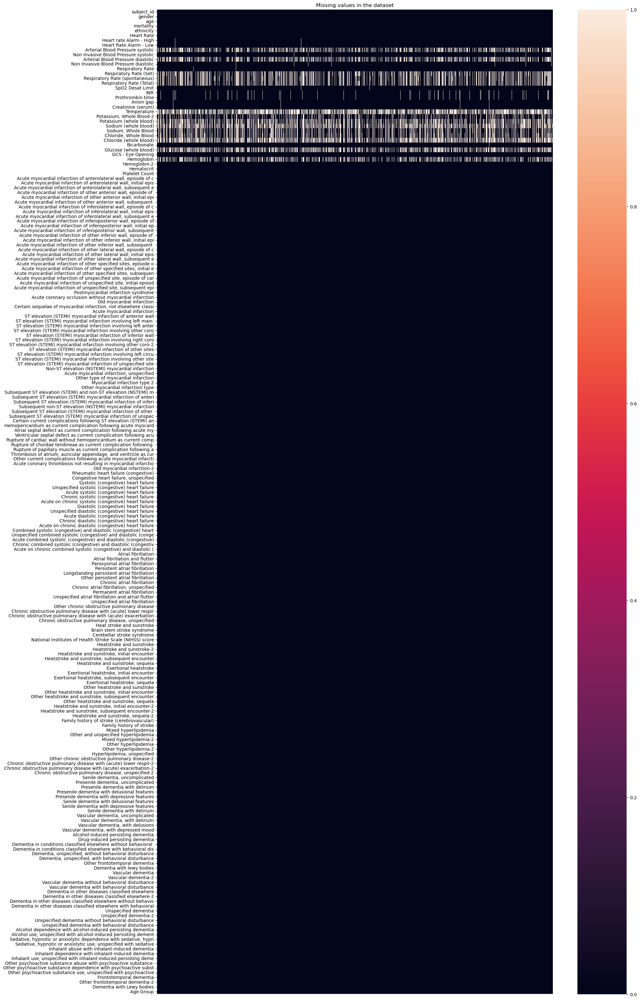

In [13]:
plt.figure(figsize=(20, 40))
ax = sns.heatmap(mimic_iv.transpose().isnull())
plt.title("Missing values in the dataset")
ax.set_xticks([])
plt.show()

In the last heatmap we can see that there are some variables that have a great number of missing values, we need to treat those columns to continue with our analysis.

In [14]:
# missing values column-wise
na_count = mimic_iv.isnull().sum() # total count
na_pct = (na_count/len(mimic_iv))*100 # percentage

na_mimic_iv = pd.DataFrame({'Count': na_count.values,
                      'Percentage (%)': na_pct}).reset_index().rename(columns = {'index': 'Feature'})

print(f'The total number of missing values is: {na_count.sum()}')
print(na_mimic_iv.sort_values(by='Percentage (%)', ascending=False))

The total number of missing values is: 37341
                                               Feature  Count  Percentage (%)
21                                         Temperature   3840       60.216403
27                              Chloride (whole blood)   3569       55.966756
24                                Sodium (whole blood)   3362       52.720715
29                               Glucose (whole blood)   2953       46.307041
23                             Potassium (whole blood)   2802       43.939156
8                     Arterial Blood Pressure systolic   2478       38.858397
10                   Arterial Blood Pressure diastolic   2477       38.842716
13                              Respiratory Rate (Set)   2470       38.732947
31                                          Hemoglobin   2357       36.960953
14                      Respiratory Rate (spontaneous)   2300       36.067116
15                            Respiratory Rate (Total)   2286       35.847577
26                 

In the last list we can see that some of the variables with missing values have more than 30% among the total number of observations, for this reason we need to come up with a solution, the imputation is possible but that could lead to changes on the distribution of those variables.

# PART 2: Descriptive Statistics for Variables

## Categorical Variables

### **LEVELS**

In [15]:
# Assuming 'mimic_iv' is your DataFrame containing categorical columns
mimic_iv_cat = mimic_iv.select_dtypes(include=['object', 'category'])

# Iterate over each column in the categorical DataFrame
for col in mimic_iv_cat.columns:
    # Get the unique values for the current column, dropping NaN values
    unique_values = mimic_iv_cat[col].dropna().unique()
    # Print the column name and its unique values
    print(f"Column: {col}")
    print(unique_values)

Column: gender
['M' 'F']
Column: mortality
[0 1]
Column: ethnicity
['WHITE' 'ASIAN - SOUTH EAST ASIAN' 'OTHER' 'BLACK/AFRICAN AMERICAN'
 'UNKNOWN' 'ASIAN - ASIAN INDIAN' 'WHITE - EASTERN EUROPEAN'
 'HISPANIC/LATINO - PUERTO RICAN' 'WHITE - OTHER EUROPEAN'
 'ASIAN - CHINESE' 'WHITE - RUSSIAN' 'HISPANIC/LATINO - GUATEMALAN'
 'BLACK/CARIBBEAN ISLAND' 'UNABLE TO OBTAIN' 'HISPANIC/LATINO - MEXICAN'
 'WHITE - BRAZILIAN' 'PATIENT DECLINED TO ANSWER' 'PORTUGUESE'
 'HISPANIC/LATINO - DOMINICAN' 'ASIAN' 'ASIAN - KOREAN' 'BLACK/AFRICAN'
 'BLACK/CAPE VERDEAN' 'HISPANIC/LATINO - HONDURAN' 'SOUTH AMERICAN'
 'HISPANIC OR LATINO' 'AMERICAN INDIAN/ALASKA NATIVE'
 'NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER' 'MULTIPLE RACE/ETHNICITY'
 'HISPANIC/LATINO - CENTRAL AMERICAN' 'HISPANIC/LATINO - CUBAN'
 'HISPANIC/LATINO - SALVADORAN' 'HISPANIC/LATINO - COLUMBIAN']
Column: GCS - Eye Opening
[4 2 3 1]
Column: Acute myocardial infarction of anterolateral wall, episode of c
[0]
Column: Acute myocardial infarction 

In [16]:
# Assuming 'df' is your DataFrame containing categorical variables
categorical_df = mimic_iv.select_dtypes(include=['object', 'category'])

# Iterate over each categorical column in the DataFrame
for column in categorical_df.columns:
    # Count the frequency of each level in the current column
    level_counts = categorical_df[column].value_counts()
    
    # Calculate the number of distinct values
    num_distinct_values = len(level_counts)
    
    # Print the results
    print(f"Column: {column}")
    print(f"a) Number of distinct values: {num_distinct_values}")
    print("b) Frequency of each level:")
    print(level_counts)
    print()


Column: gender
a) Number of distinct values: 2
b) Frequency of each level:
gender
M    3981
F    2396
Name: count, dtype: int64

Column: mortality
a) Number of distinct values: 2
b) Frequency of each level:
mortality
0    5408
1     969
Name: count, dtype: int64

Column: ethnicity
a) Number of distinct values: 33
b) Frequency of each level:
ethnicity
WHITE                                        4263
UNKNOWN                                       693
BLACK/AFRICAN AMERICAN                        428
OTHER                                         180
WHITE - OTHER EUROPEAN                        165
WHITE - RUSSIAN                               102
HISPANIC/LATINO - PUERTO RICAN                 77
ASIAN - CHINESE                                64
ASIAN                                          51
UNABLE TO OBTAIN                               50
HISPANIC/LATINO - DOMINICAN                    40
PATIENT DECLINED TO ANSWER                     39
BLACK/CARIBBEAN ISLAND                         

## Numerical Variables

### **STATISTICS**

In [17]:
mimic_iv_num = mimic_iv.select_dtypes(include=['int64', 'float64'])

mimic_iv_num = mimic_iv_num.iloc[:, 1:]

mimic_iv_num.describe()

,age,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Arterial Blood Pressure systolic,Non Invasive Blood Pressure systolic,Arterial Blood Pressure diastolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,Respiratory Rate (Set),Respiratory Rate (spontaneous),Respiratory Rate (Total),SpO2 Desat Limit,INR,Prothrombin time,Anion gap,Creatinine (serum),Temperature,"Potassium, Whole Blood-2",Potassium (whole blood),Sodium (whole blood),"Sodium, Whole Blood","Chloride, Whole Blood",Chloride (whole blood),Bicarbonate,Glucose (whole blood),Hemoglobin,Hemoglobin-2,Hematocrit,Platelet Count
count,6377.000000,6377.000000,6374.000000,6373.000000,3899.000000,6332.000000,3900.000000,6332.000000,6375.000000,3907.000000,4077.000000,4091.000000,6364.000000,6141.000000,6141.000000,6360.000000,6363.000000,2537.000000,4936.000000,3575.000000,3015.000000,4256.000000,4110.000000,2808.000000,6374.000000,3.424000e+03,4020.000000,6377.000000,6377.000000,6377.000000
mean,69.313157,113.117767,260.787575,168.810309,154.507053,160.847285,174.744359,215.886292,34.783686,20.020220,20.813834,25.742606,89.376996,5049.946255,4905.797069,174.542453,944.929593,37.391210,5.123602,1403.598853,800.324046,138.336701,106.143552,462.731838,30.702855,2.311856e+03,12.021866,13.524557,41.140254,339.921907
std,13.154244,24.498357,3955.804690,2388.104217,29.238841,294.861135,2312.412261,2786.237760,35.494195,34.022791,36.118656,57.922742,39.766331,70875.551022,69727.423807,12539.018181,30695.353796,0.931146,2.164168,37376.721593,25747.752384,4.779916,5.564448,18869.253297,4.474367,4.715157e+04,2.692671,1.860455,5.303291,164.069124
min,19.000000,43.000000,60.000000,40.000000,0.000000,56.000000,1.000000,41.000000,15.000000,0.000000,0.000000,0.000000,85.000000,0.900000,9.300000,7.000000,0.300000,32.200000,1.800000,2.100000,118.000000,115.000000,71.000000,11.000000,13.000000,3.500000e+01,0.000000,5.100000,18.100000,9.000000
25%,61.000000,95.000000,120.000000,50.000000,136.000000,135.000000,69.000000,82.000000,27.000000,16.000000,13.000000,18.000000,85.000000,1.200000,13.500000,14.000000,0.900000,36.800000,4.400000,4.300000,135.000000,136.000000,103.000000,104.000000,28.000000,1.470000e+02,10.700000,12.300000,37.600000,231.000000
50%,70.000000,109.000000,130.000000,60.000000,150.000000,153.000000,78.000000,98.000000,32.000000,18.000000,21.000000,23.000000,88.000000,1.400000,15.600000,16.000000,1.200000,37.200000,5.000000,4.900000,137.000000,138.000000,106.000000,107.000000,30.000000,1.730000e+02,12.100000,13.600000,41.400000,304.000000
75%,79.000000,128.000000,133.750000,60.000000,168.000000,171.000000,92.000000,115.000000,38.000000,20.000000,28.000000,29.000000,88.000000,1.800000,19.900000,20.000000,2.100000,37.900000,5.600000,5.500000,139.000000,140.000000,109.000000,109.000000,33.000000,2.100000e+02,13.400000,14.800000,44.600000,408.000000
max,91.000000,295.000000,165130.000000,60120.000000,742.000000,15878.000000,91100.000000,105125.000000,2037.000000,1618.000000,1918.000000,3634.000000,920.000000,999999.000000,999999.000000,999999.000000,999999.000000,40.700000,134.000000,999999.000000,999999.000000,187.000000,139.000000,999999.000000,51.000000,1.276100e+06,97.000000,22.600000,69.700000,2660.000000


### **DISTRIBUTIONS**

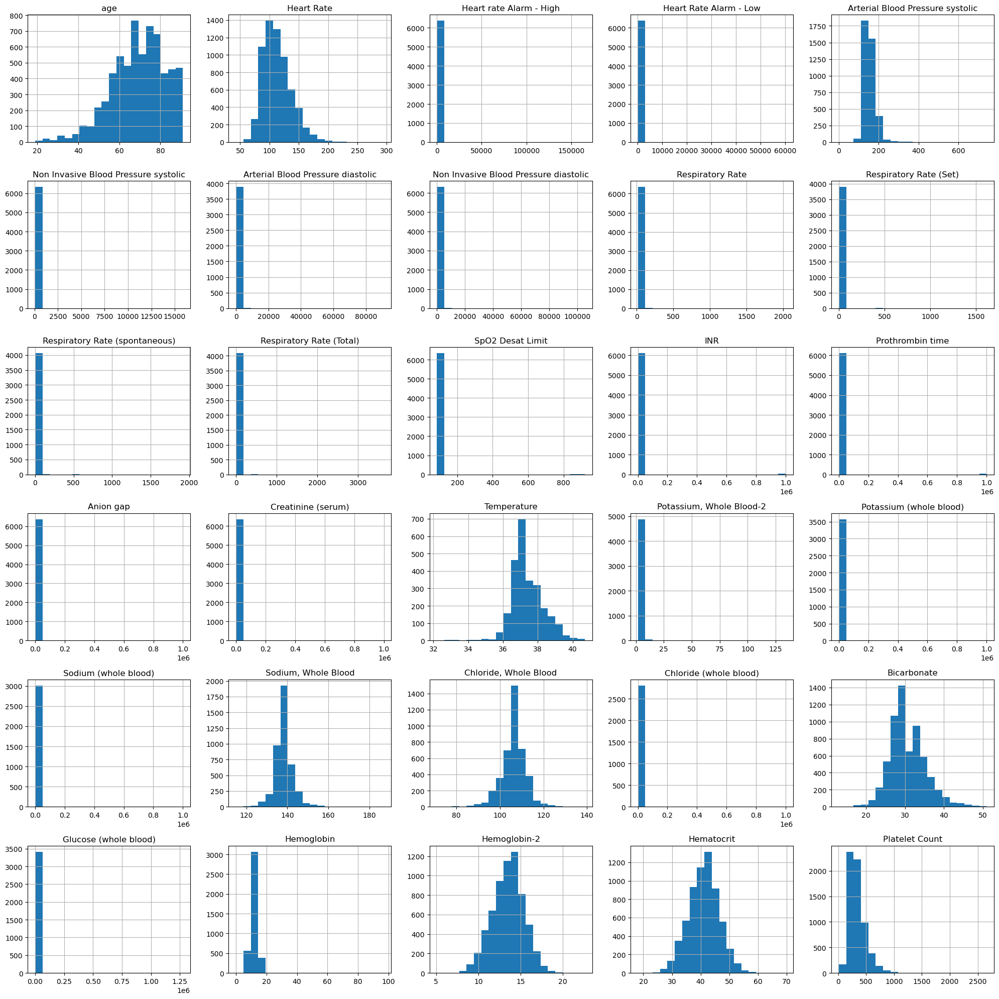

In [18]:
mimic_iv_num.hist(bins=20, figsize=(20, 20))

plt.tight_layout()
plt.show()

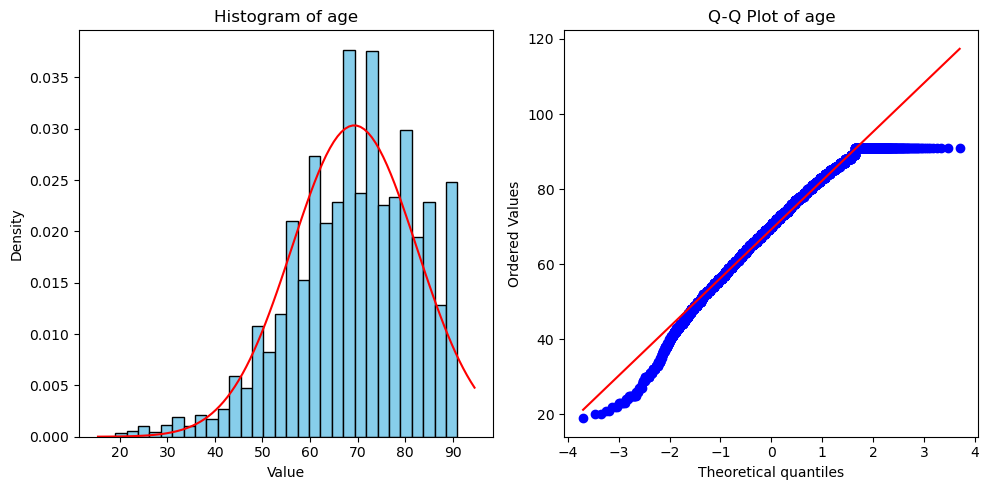

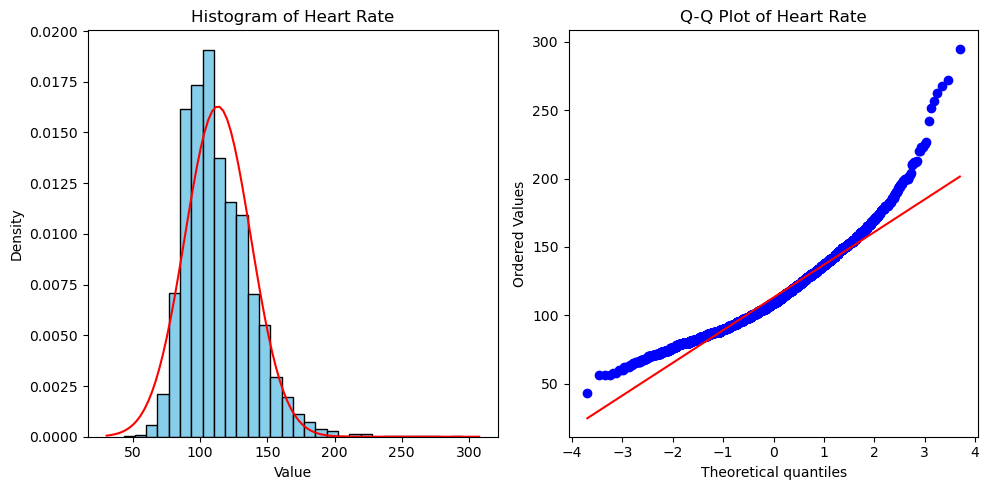

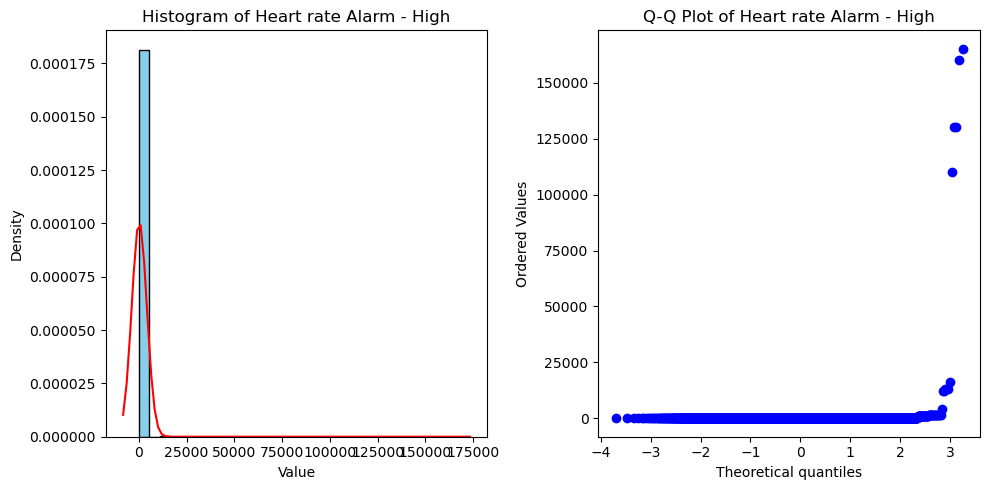

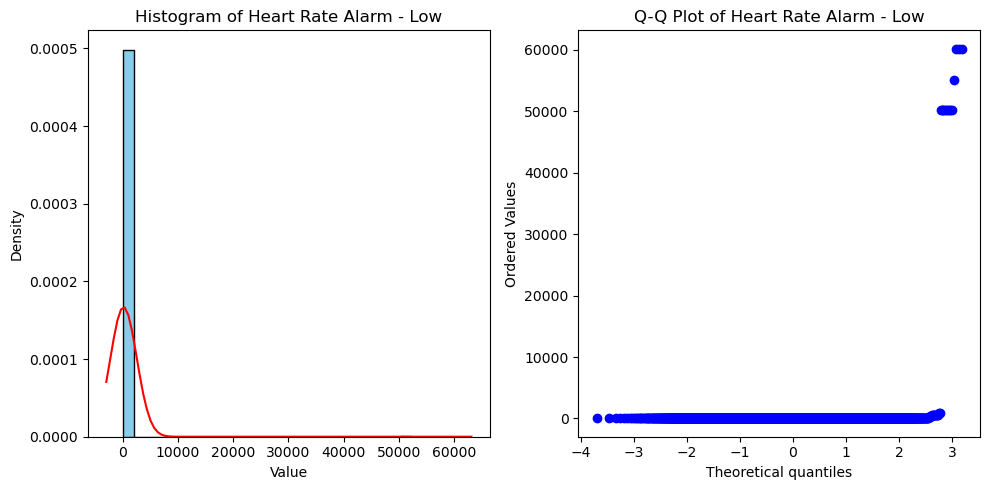

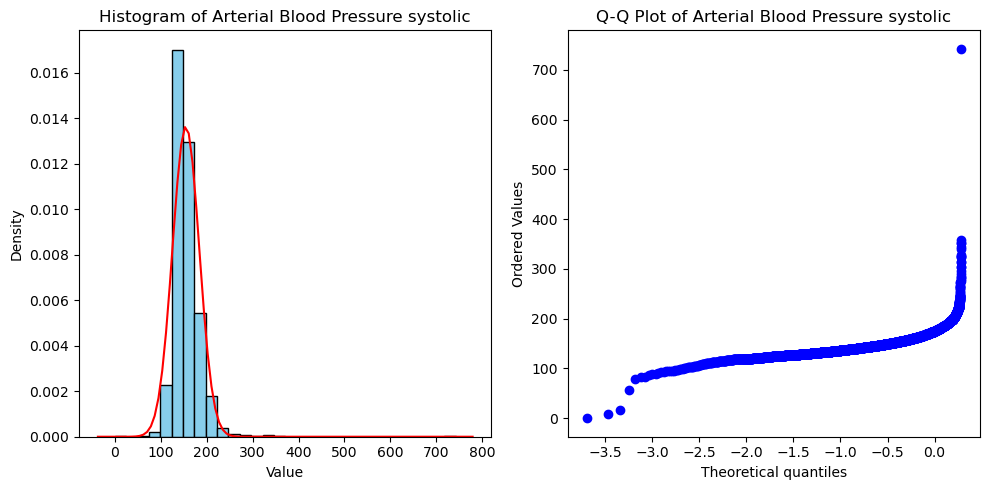

...

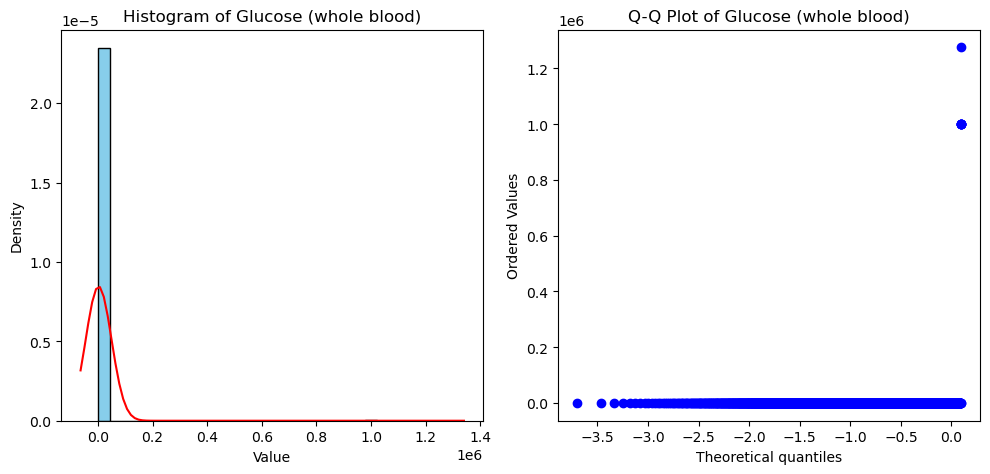

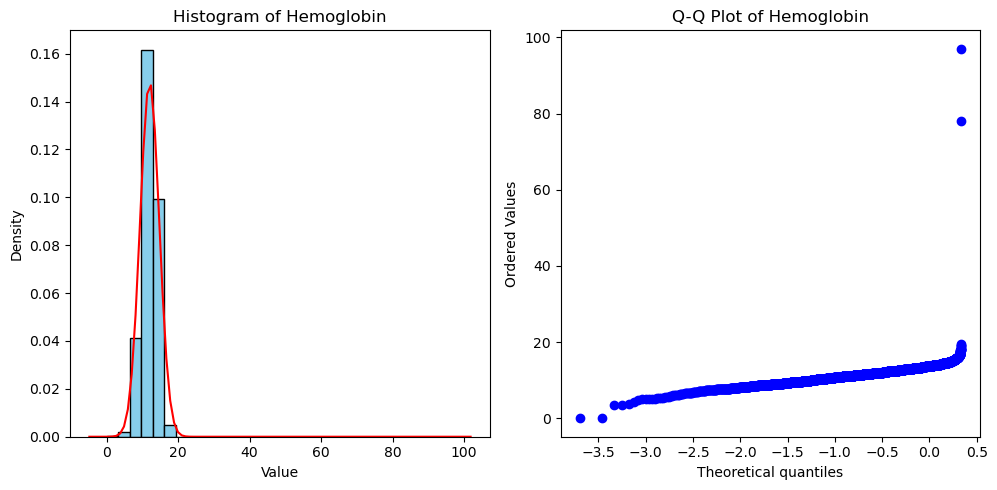

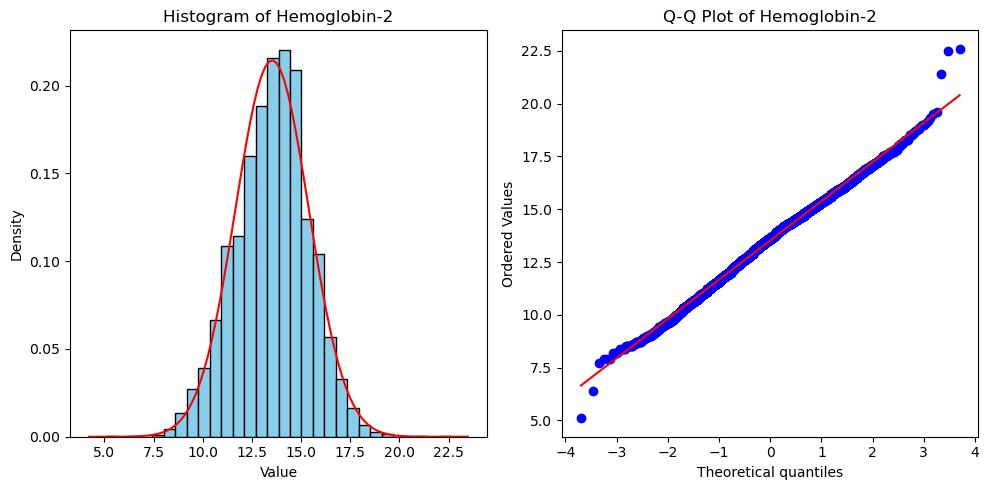

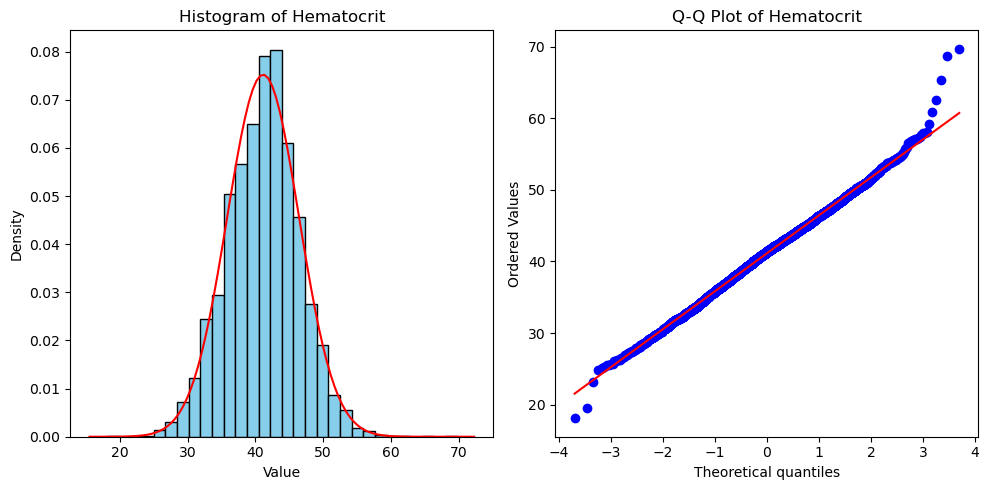

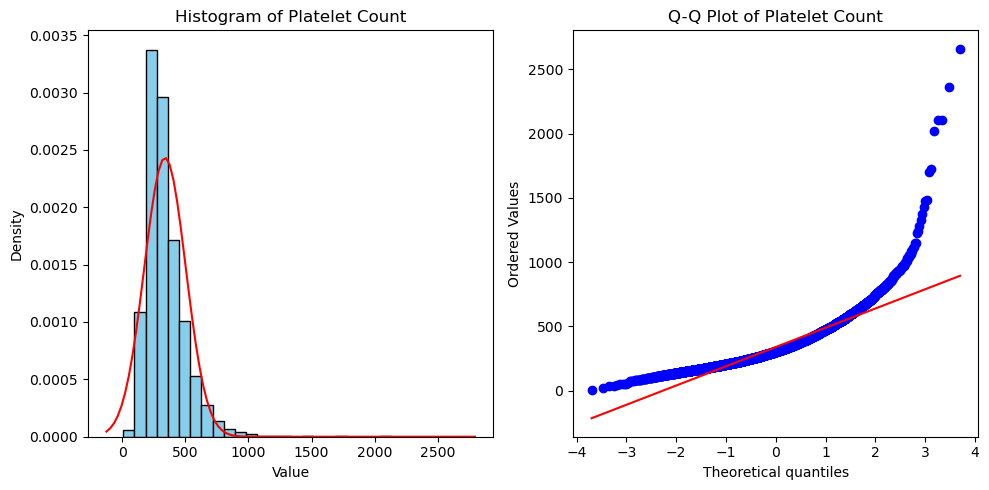

In [19]:
import scipy.stats as stats

# Loop through each variable
for var in mimic_iv_num.columns:
    # Set up the plotting area
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    # Plot a histogram for the current variable
    axes[0].hist(mimic_iv_num[var], bins=30, density=True, color='skyblue', edgecolor='black')
    axes[0].set_title(f"Histogram of {var}")
    axes[0].set_xlabel("Value")
    axes[0].set_ylabel("Density")
    
    # Add a normal distribution curve
    mu, sigma = mimic_iv_num[var].mean(), mimic_iv_num[var].std()
    xmin, xmax = axes[0].get_xlim()
    x = np.linspace(xmin, xmax, 100)
    axes[0].plot(x, stats.norm.pdf(x, mu, sigma), color='red')
    
    # Create a Q-Q plot for the current variable
    stats.probplot(mimic_iv_num[var], dist="norm", plot=axes[1], fit=True)
    axes[1].set_title(f"Q-Q Plot of {var}")
    
    plt.tight_layout()
    plt.show()


# PART 3: Outliers Handling

## **OUTLIERS ASSESSMENT**

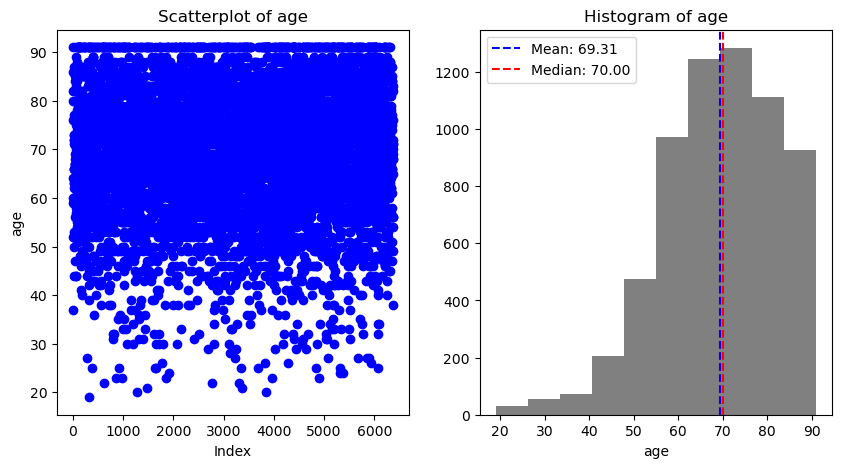

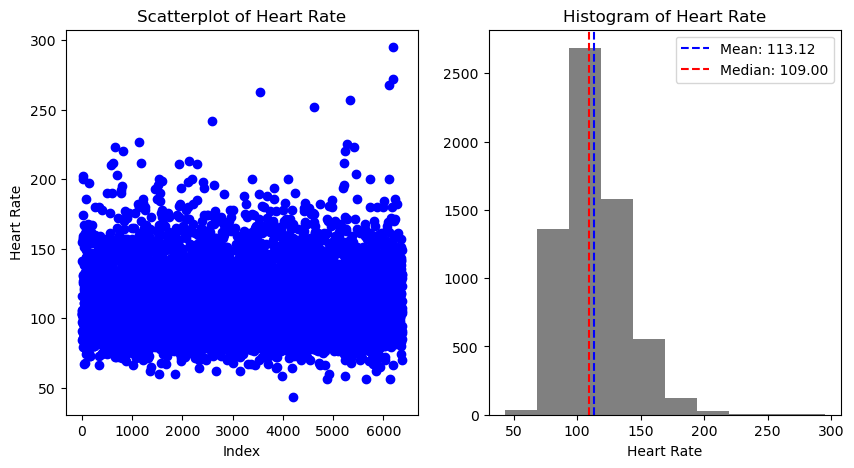

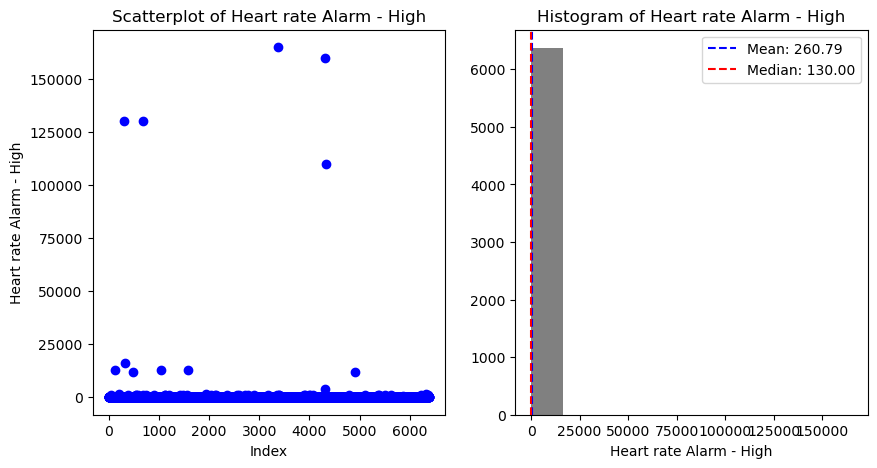

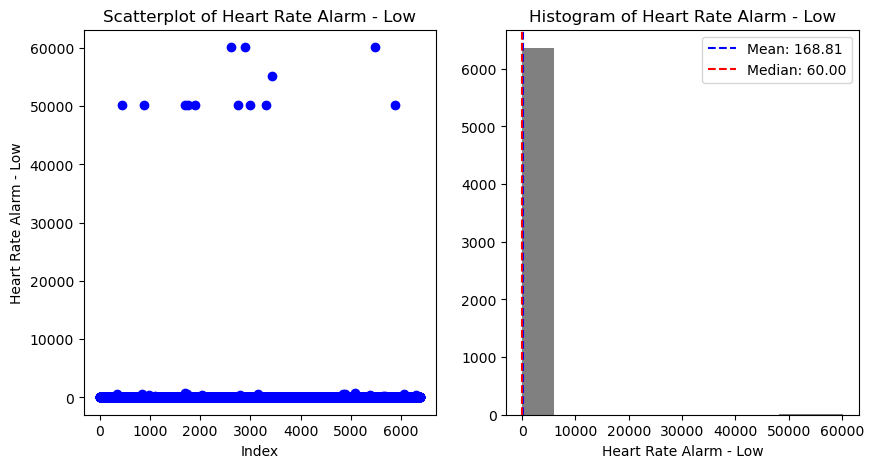

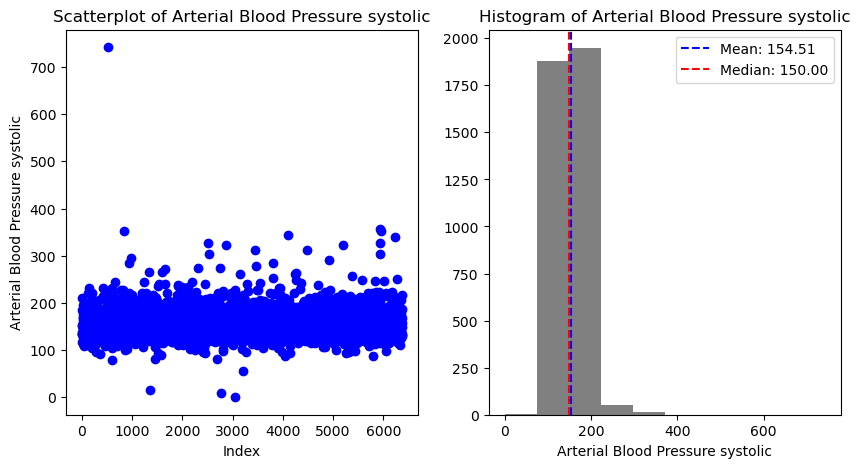

...

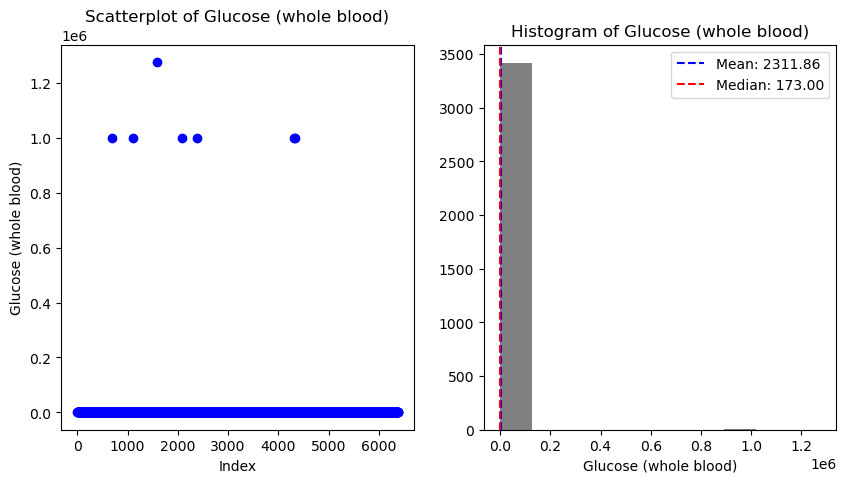

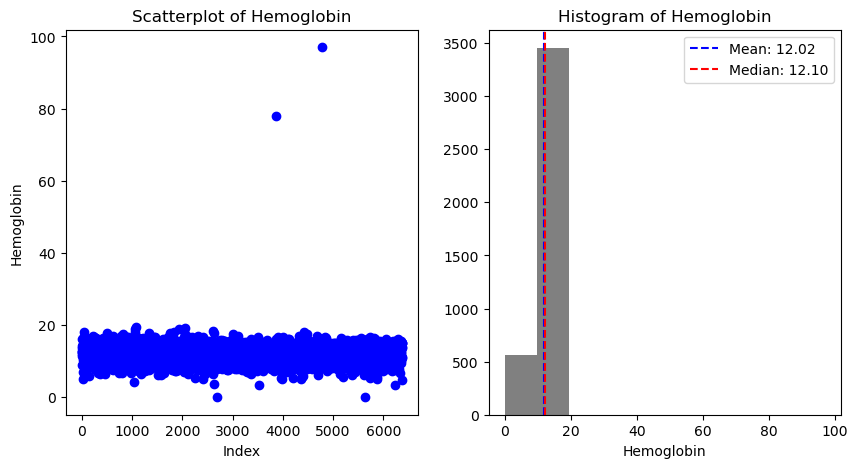

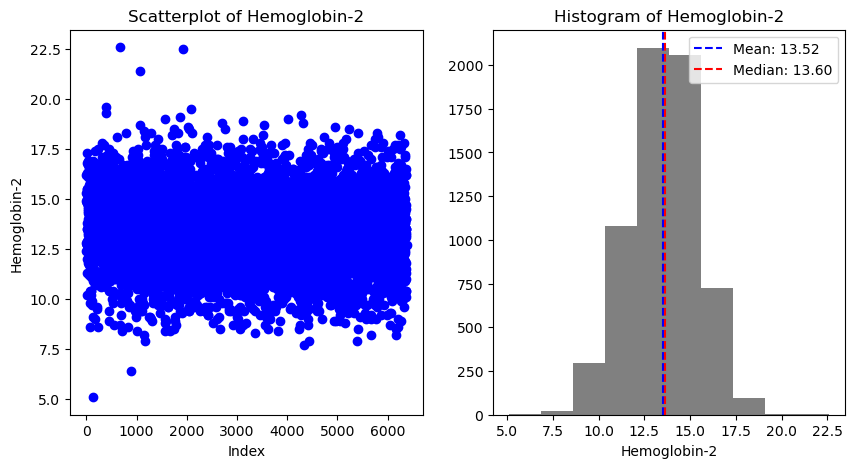

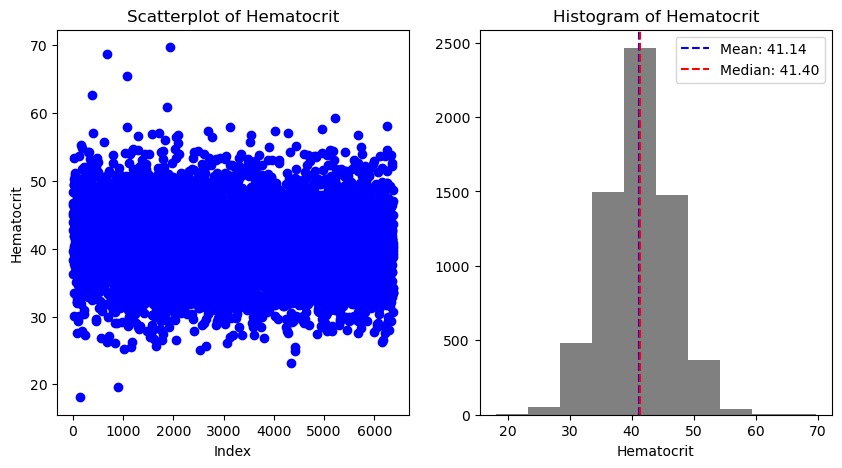

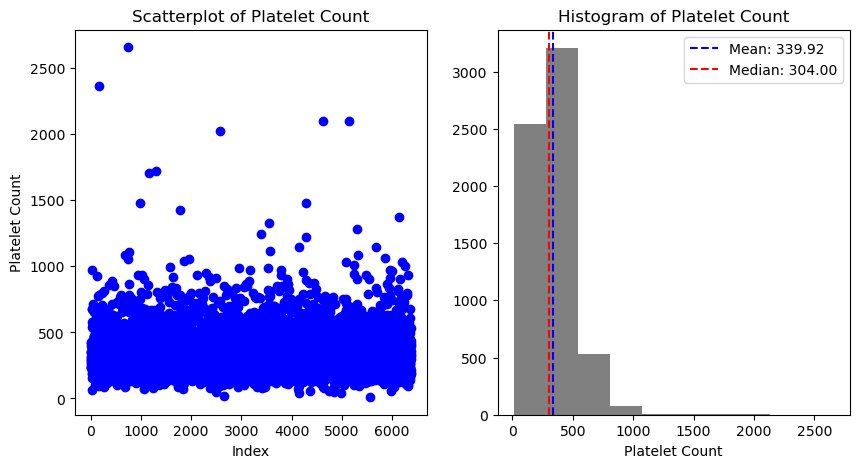

In [20]:
# Iterate over each column in the DataFrame
for col in mimic_iv_num.columns:
    # Extract column data
    col_data = mimic_iv_num[col]
    
    # Create a figure with two subplots
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    
    # Scatterplot
    plt.plot(col_data, marker='o', linestyle='None', color='blue')
    plt.title(f"Scatterplot of {col}")
    plt.xlabel("Index")
    plt.ylabel(col)
    
    # Histogram
    plt.subplot(1, 2, 2)
    plt.hist(col_data, color='gray')
    plt.title(f"Histogram of {col}")
    plt.xlabel(col)
    
    # Add vertical lines for mean and median
    mean_val = col_data.mean()
    median_val = col_data.median()
    plt.axvline(mean_val, color='blue', linestyle='--', label=f'Mean: {mean_val:.2f}')
    plt.axvline(median_val, color='red', linestyle='--', label=f'Median: {median_val:.2f}')
    plt.legend()
    
    plt.show()


## **EXTREME OUTLIERS HANDLING**

In [21]:
mimic_iv_clean1 = mimic_iv

### Heart Rate Group

Summary of Heart Rate Group
        Heart Rate  Heart rate Alarm - High  Heart Rate Alarm - Low
count  6377.000000              6374.000000             6373.000000
mean    113.117767               260.787575              168.810309
std      24.498357              3955.804690             2388.104217
min      43.000000                60.000000               40.000000
25%      95.000000               120.000000               50.000000
50%     109.000000               130.000000               60.000000
75%     128.000000               133.750000               60.000000
max     295.000000            165130.000000            60120.000000


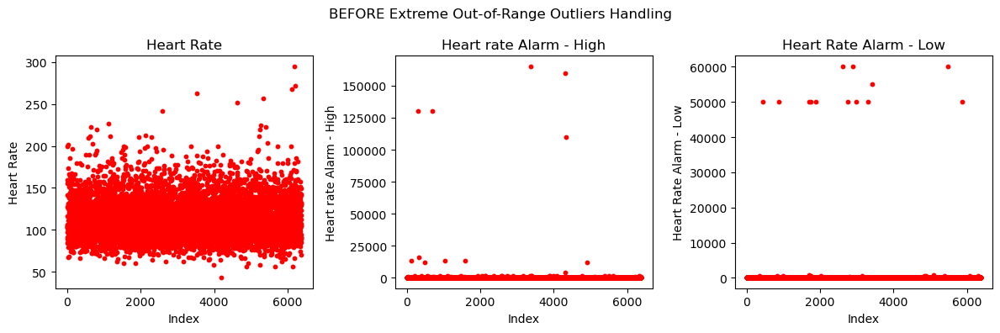


Out-of-range values Heart Rate Group
Heart Rate: 6
Heart Rate Alarm High: 65
Heart Rate Alarm Low: 27


In [22]:
# Summary of Heart Rate Group

startlim = 5
endlim = 8
diflim = endlim - startlim

print("Summary of Heart Rate Group")
print(mimic_iv.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Set the maximum heart rate threshold
max_heart_rate = 250

# Out-of-range values Heart Rate Group
oor_hr = sum(mimic_iv['Heart Rate'] > max_heart_rate)
oor_hrah = sum(mimic_iv['Heart rate Alarm - High'] > max_heart_rate)
oor_hral = sum(mimic_iv['Heart Rate Alarm - Low'] > max_heart_rate)

print("\nOut-of-range values Heart Rate Group")
print("Heart Rate:", oor_hr)
print("Heart Rate Alarm High:", oor_hrah)
print("Heart Rate Alarm Low:", oor_hral)



Summary of cleaned Heart Rate Group
        Heart Rate  Heart rate Alarm - High  Heart Rate Alarm - Low
count  6371.000000              6309.000000             6346.000000
mean    112.972061               131.109843               60.057375
std      24.041360                13.869974               14.221671
min      43.000000                60.000000               40.000000
25%      95.000000               120.000000               50.000000
50%     109.000000               130.000000               60.000000
75%     128.000000               130.000000               60.000000
max     242.000000               250.000000              180.000000


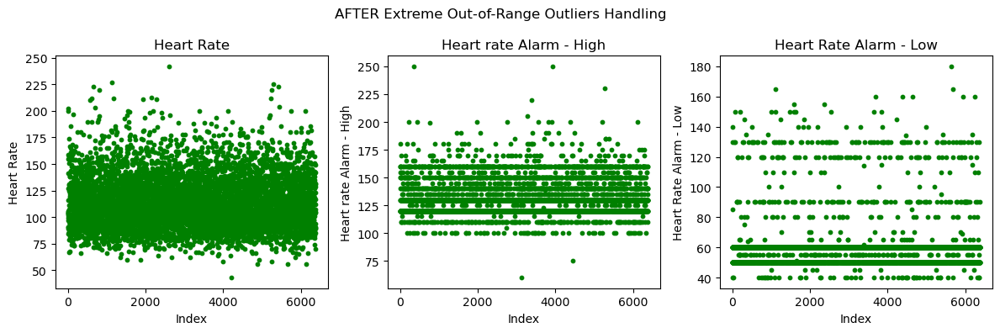

In [23]:
# Summary of cleaned Heart Rate Group

# Remove out-of-range values
mimic_iv_clean1['Heart Rate'] = np.where(mimic_iv_clean1['Heart Rate'] > max_heart_rate, np.nan, mimic_iv_clean1['Heart Rate'])
mimic_iv_clean1['Heart rate Alarm - High'] = np.where(mimic_iv_clean1['Heart rate Alarm - High'] > max_heart_rate, np.nan, mimic_iv_clean1['Heart rate Alarm - High'])
mimic_iv_clean1['Heart Rate Alarm - Low'] = np.where(mimic_iv_clean1['Heart Rate Alarm - Low'] > max_heart_rate, np.nan, mimic_iv_clean1['Heart Rate Alarm - Low'])

print("\nSummary of cleaned Heart Rate Group")
print(mimic_iv_clean1.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='green')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

### Blood Pressure Group

Summary of Blood Pressure Group
       Arterial Blood Pressure systolic  Non Invasive Blood Pressure systolic  \
count                       3899.000000                           6332.000000   
mean                         154.507053                            160.847285   
std                           29.238841                            294.861135   
min                            0.000000                             56.000000   
25%                          136.000000                            135.000000   
50%                          150.000000                            153.000000   
75%                          168.000000                            171.000000   
max                          742.000000                          15878.000000   

       Arterial Blood Pressure diastolic  \
count                        3900.000000   
mean                          174.744359   
std                          2312.412261   
min                             1.000000   
25%               

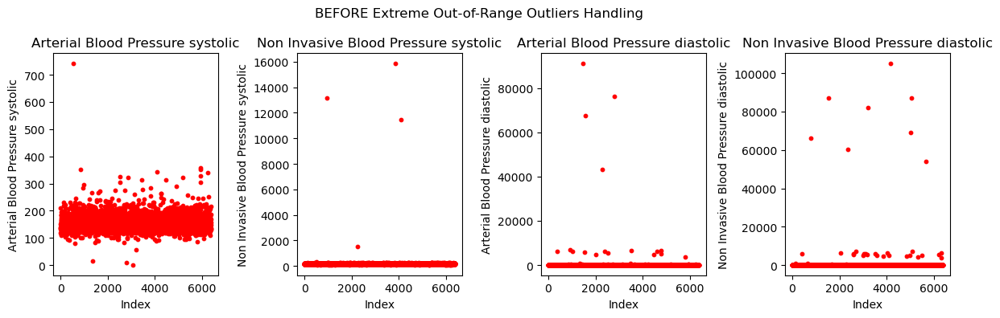


Out-of-range values Blood Pressure Group
Arterial BP syst: 1
Non Inv BP syst: 4
Arterial BP dias: 32
Non Inv BP dias: 34


In [24]:
# Summary of Blood Pressure Group

startlim = 8
endlim = 12
diflim = endlim - startlim

print("Summary of Blood Pressure Group")
print(mimic_iv.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Set the maximum blood pressure thresholds
max_abps = 400
max_nibps = 360
max_abpd = 267
max_nibpd = 240

# Out-of-range values Blood Pressure Group
oor_abps = sum(mimic_iv['Arterial Blood Pressure systolic'] > max_abps)
oor_nibps = sum(mimic_iv['Non Invasive Blood Pressure systolic'] > max_nibps)
oor_abpd = sum(mimic_iv['Arterial Blood Pressure diastolic'] > max_abpd)
oor_nibpd = sum(mimic_iv['Non Invasive Blood Pressure diastolic'] > max_nibpd)

print("\nOut-of-range values Blood Pressure Group")
print("Arterial BP syst:", oor_abps)
print("Non Inv BP syst:", oor_nibps)
print("Arterial BP dias:", oor_abpd)
print("Non Inv BP dias:", oor_nibpd)



Summary of cleaned Blood Pressure Group
       Arterial Blood Pressure systolic  Non Invasive Blood Pressure systolic  \
count                       3898.000000                           6328.000000   
mean                         154.356337                            154.306576   
std                           27.686439                             26.672162   
min                            0.000000                             56.000000   
25%                          136.000000                            135.000000   
50%                          149.500000                            153.000000   
75%                          167.750000                            171.000000   
max                          357.000000                            321.010000   

       Arterial Blood Pressure diastolic  \
count                        3868.000000   
mean                           83.431489   
std                            22.761232   
min                             1.000000   
25%      

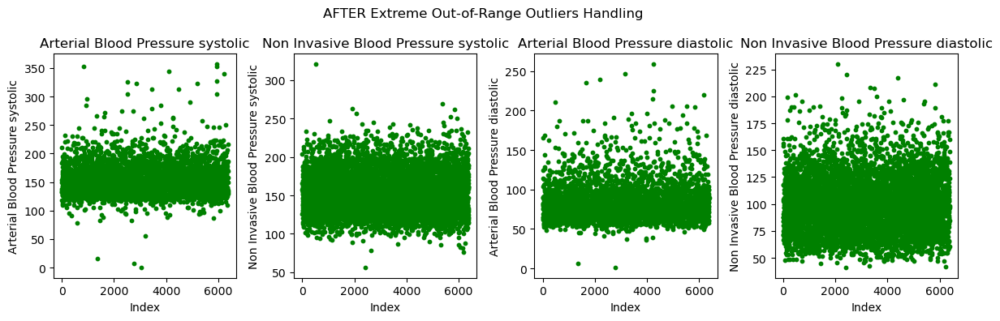

In [25]:
# Summary of cleaned Blood Pressure Group

# Remove out-of-range values
mimic_iv_clean1['Arterial Blood Pressure systolic'] = np.where(mimic_iv_clean1['Arterial Blood Pressure systolic'] > max_abps, np.nan, mimic_iv_clean1['Arterial Blood Pressure systolic'])
mimic_iv_clean1['Non Invasive Blood Pressure systolic'] = np.where(mimic_iv_clean1['Non Invasive Blood Pressure systolic'] > max_nibps, np.nan, mimic_iv_clean1['Non Invasive Blood Pressure systolic'])
mimic_iv_clean1['Arterial Blood Pressure diastolic'] = np.where(mimic_iv_clean1['Arterial Blood Pressure diastolic'] > max_abpd, np.nan, mimic_iv_clean1['Arterial Blood Pressure diastolic'])
mimic_iv_clean1['Non Invasive Blood Pressure diastolic'] = np.where(mimic_iv_clean1['Non Invasive Blood Pressure diastolic'] > max_nibpd, np.nan, mimic_iv_clean1['Non Invasive Blood Pressure diastolic'])

print("\nSummary of cleaned Blood Pressure Group")
print(mimic_iv_clean1.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='green')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

### Respiratory Rate Group

Summary of Respiratory Rate Group
       Respiratory Rate  Respiratory Rate (Set)  \
count       6375.000000             3907.000000   
mean          34.783686               20.020220   
std           35.494195               34.022791   
min           15.000000                0.000000   
25%           27.000000               16.000000   
50%           32.000000               18.000000   
75%           38.000000               20.000000   
max         2037.000000             1618.000000   

       Respiratory Rate (spontaneous)  Respiratory Rate (Total)  \
count                     4077.000000               4091.000000   
mean                        20.813834                 25.742606   
std                         36.118656                 57.922742   
min                          0.000000                  0.000000   
25%                         13.000000                 18.000000   
50%                         21.000000                 23.000000   
75%                         28.000000

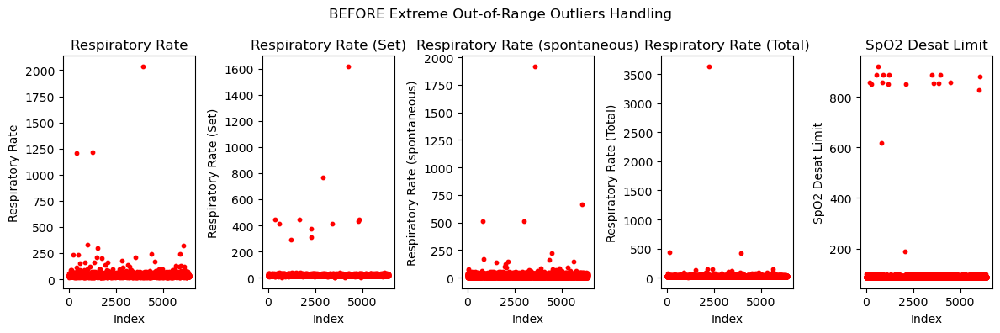


Out-of-range values Respiration Group
Respiratory rate:  25
Respiratory Rate (Set):  11
Respiratory Rate (spontaneous):  11
Respiratory Rate (Total):  7
SpO2 Desat Limit:  18


In [26]:
# Summary of Respiratory Rate Group

startlim = 12
endlim = 17
diflim = endlim - startlim

print("Summary of Respiratory Rate Group")
print(mimic_iv.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Set the maximum thresholds for Respiratory Rate and SpO2 Desat Limit
max_respiratory_rate = 120  # increased value to keep the most outliers
max_so2_desat_limit = 100

# Print out-of-range values for Respiration Group
print("\nOut-of-range values Respiration Group")
print("Respiratory rate: ", oor_rr := sum(mimic_iv['Respiratory Rate'] > max_respiratory_rate))
print("Respiratory Rate (Set): ", oor_rr_set := sum(mimic_iv['Respiratory Rate (Set)'] > max_respiratory_rate))
print("Respiratory Rate (spontaneous): ", oor_rr_spont := sum(mimic_iv['Respiratory Rate (spontaneous)'] > max_respiratory_rate))
print("Respiratory Rate (Total): ", oor_rr_total := sum(mimic_iv['Respiratory Rate (Total)'] > max_respiratory_rate))
print("SpO2 Desat Limit: ", oor_so2dl := sum(mimic_iv['SpO2 Desat Limit'] > max_so2_desat_limit))


Summary of cleaned Respiratory Rate Group
       Respiratory Rate (Set)  Respiratory Rate (spontaneous)  \
count             3896.000000                     4066.000000   
mean                18.546458                       19.710772   
std                  4.759629                       12.874738   
min                  0.000000                        0.000000   
25%                 16.000000                       13.000000   
50%                 18.000000                       21.000000   
75%                 20.000000                       28.000000   
max                 40.000000                      101.000000   

       Respiratory Rate (Total)  SpO2 Desat Limit  
count               4084.000000       6346.000000  
mean                  24.547747         87.315506  
std                    8.909451          2.569909  
min                    0.000000         85.000000  
25%                   18.000000         85.000000  
50%                   23.000000         88.000000  
75%    

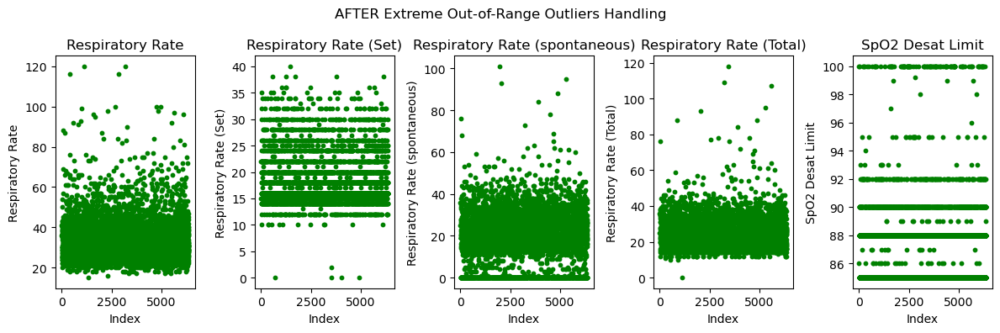

In [27]:
# Summary of cleaned Respiratory Rate Group

# Replace out-of-range values with NA
mimic_iv_clean1['Respiratory Rate'] = np.where(mimic_iv_clean1['Respiratory Rate'] > max_respiratory_rate, np.nan, mimic_iv_clean1['Respiratory Rate'])
mimic_iv_clean1['Respiratory Rate (Set)'] = np.where(mimic_iv_clean1['Respiratory Rate (Set)'] > max_respiratory_rate, np.nan, mimic_iv_clean1['Respiratory Rate (Set)'])
mimic_iv_clean1['Respiratory Rate (spontaneous)'] = np.where(mimic_iv_clean1['Respiratory Rate (spontaneous)'] > max_respiratory_rate, np.nan, mimic_iv_clean1['Respiratory Rate (spontaneous)'])
mimic_iv_clean1['Respiratory Rate (Total)'] = np.where(mimic_iv_clean1['Respiratory Rate (Total)'] > max_respiratory_rate, np.nan, mimic_iv_clean1['Respiratory Rate (Total)'])
mimic_iv_clean1['SpO2 Desat Limit'] = np.where(mimic_iv_clean1['SpO2 Desat Limit'] > max_so2_desat_limit, np.nan, mimic_iv_clean1['SpO2 Desat Limit'])


print("\nSummary of cleaned Respiratory Rate Group")
print(mimic_iv_clean1.iloc[:, 13:17].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='green')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

### Blood Clotting Group

Summary of Blood Clotting Group
                 INR  Prothrombin time
count    6141.000000       6141.000000
mean     5049.946255       4905.797069
std     70875.551022      69727.423807
min         0.900000          9.300000
25%         1.200000         13.500000
50%         1.400000         15.600000
75%         1.800000         19.900000
max    999999.000000     999999.000000


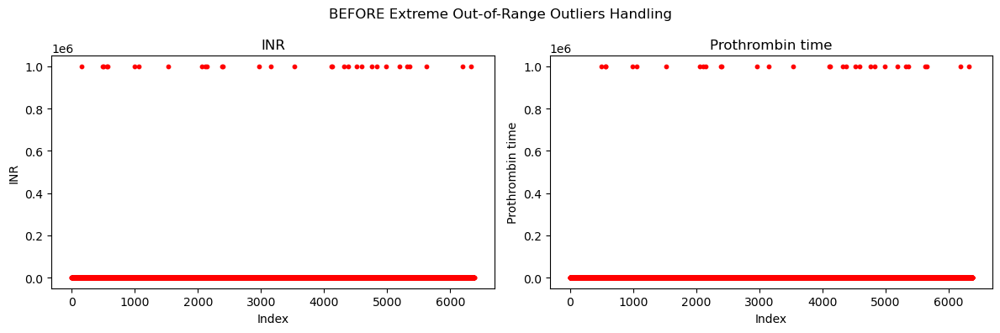


Out-of-range values Blood Clotting Group
Error Value (999999) INR:  31
Error Value (999999) PT:  30
INR:  716
Prothrombin time:  1432


In [28]:
# Summary of Blood Clotting Group

startlim = 17
endlim = 19
diflim = endlim - startlim

print("Summary of Blood Clotting Group")
print(mimic_iv.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Set the maximum thresholds for Blood Clotting variables
error = 999999
max_inr = 3
max_prothrombin_time = 20.6

# Print out-of-range values for Blood Clotting Group
print("\nOut-of-range values Blood Clotting Group")
print("Error Value (999999) INR: ", error_inr := sum(mimic_iv['INR'] == error))
print("Error Value (999999) PT: ", error_pt := sum(mimic_iv['Prothrombin time'] == error))
print("INR: ", oor_inr := sum(mimic_iv['INR'] > max_inr))
print("Prothrombin time: ", oor_pt := sum(mimic_iv['Prothrombin time'] > max_prothrombin_time))



Summary of cleaned Blood Clotting Group
               INR  Prothrombin time
count  6110.000000       6111.000000
mean      1.923232         20.705253
std       1.583399         16.017094
min       0.900000          9.300000
25%       1.200000         13.500000
50%       1.400000         15.600000
75%       1.800000         19.700000
max      27.400000        150.000000


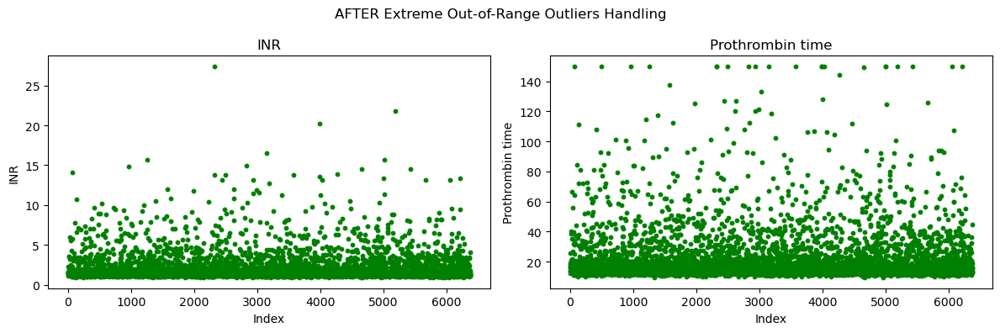

In [29]:
# Summary of cleaned Blood Clotting Group

# Replace out-of-range values with NA
mimic_iv_clean1['INR'] = np.where(mimic_iv_clean1['INR'] == error, np.nan, mimic_iv_clean1['INR'])
mimic_iv_clean1['Prothrombin time'] = np.where(mimic_iv_clean1['Prothrombin time'] == error, np.nan, mimic_iv_clean1['Prothrombin time'])

print("\nSummary of cleaned Blood Clotting Group")
print(mimic_iv_clean1.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='green')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

### Electrolytes and Acid-Base Balance Group

Summary of Electrolytes and Acid-Base Balance Group
           Anion gap  Potassium, Whole Blood-2  Potassium (whole blood)  \
count    6360.000000               4936.000000              3575.000000   
mean      174.542453                  5.123602              1403.598853   
std     12539.018181                  2.164168             37376.721593   
min         7.000000                  1.800000                 2.100000   
25%        14.000000                  4.400000                 4.300000   
50%        16.000000                  5.000000                 4.900000   
75%        20.000000                  5.600000                 5.500000   
max    999999.000000                134.000000            999999.000000   

       Sodium (whole blood)  Sodium, Whole Blood  Chloride, Whole Blood  \
count           3015.000000          4256.000000            4110.000000   
mean             800.324046           138.336701             106.143552   
std            25747.752384             4.77991

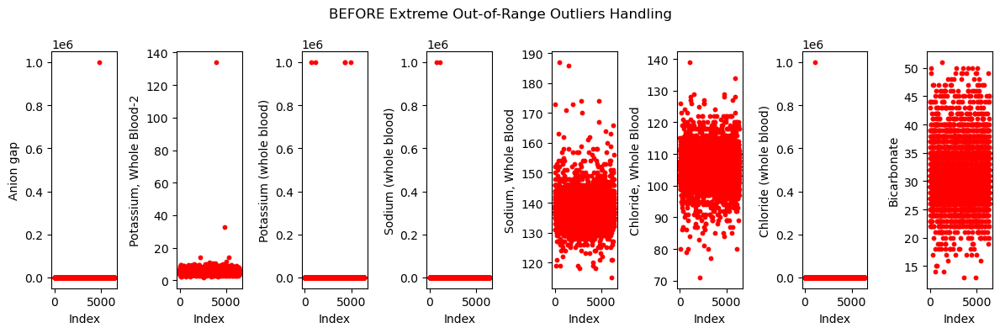

Out-of-range values Electrolytes and Acid-Base Balance Group
Error Value (999999) in Anion gap = 1
Error Value (999999) in Potassium, Whole Blood-2 = 0
Error Value (999999) in Potassium (whole blood) = 5
Error Value (999999) in Sodium (whole blood) = 2
Error Value (999999) in Sodium, Whole Blood = 0
Error Value (999999) in Chloride, Whole Blood = 0
Error Value (999999) in Chloride (whole blood) = 1
Error Value (999999) in Bicarbonate = 0


In [30]:
# Summary of Electrolytes and Acid-Base Balance Group

diflim = len([19, 22, 23, 24, 25, 26, 27, 28])

print("Summary of Electrolytes and Acid-Base Balance Group")
print(mimic_iv.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Check out-of-range values for each variable
print("Out-of-range values Electrolytes and Acid-Base Balance Group")

# Column indices corresponding to the variables of interest
col_indices = [19, 22, 23, 24, 25, 26, 27, 28]

for col_index in col_indices:
    col_name = mimic_iv.columns[col_index]
    oor_count = sum(mimic_iv.iloc[:, col_index] == error)
    print(f"Error Value (999999) in {col_name} = {oor_count}")


Replacing out-of-range values with NaN for Electrolytes and Acid-Base Balance Group

Summary of cleaned Electrolytes and Acid-Base Balance Group after replacing out-of-range values
         Anion gap  Potassium, Whole Blood-2  Potassium (whole blood)  \
count  6359.000000               4936.000000              3570.000000   
mean     17.312628                  5.123602                 5.005854   
std       5.584385                  2.164168                 2.393202   
min       7.000000                  1.800000                 2.100000   
25%      14.000000                  4.400000                 4.300000   
50%      16.000000                  5.000000                 4.900000   
75%      20.000000                  5.600000                 5.500000   
max     157.000000                134.000000               134.000000   

       Sodium (whole blood)  Sodium, Whole Blood  Chloride, Whole Blood  \
count           3013.000000          4256.000000            4110.000000   
mean      

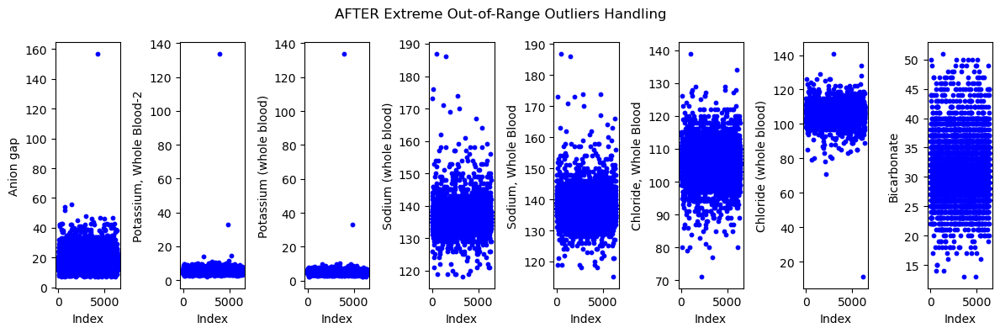

In [31]:
# Summary of cleaned Electrolytes and Acid-Base Balance Group

# Replace out-of-range values with NaN for Electrolytes and Acid-Base Balance Group
print("\nReplacing out-of-range values with NaN for Electrolytes and Acid-Base Balance Group")

for col_index in col_indices:
    col_name = mimic_iv_clean1.columns[col_index]
    oor_count = sum(mimic_iv_clean1.iloc[:, col_index] == error)
    if oor_count > 0:
        mimic_iv_clean1[col_name] = np.where(mimic_iv_clean1[col_name] == error, np.nan, mimic_iv_clean1[col_name])

# Summary after replacing out-of-range values with NaN
print("\nSummary of cleaned Electrolytes and Acid-Base Balance Group after replacing out-of-range values")
print(mimic_iv_clean1.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='blue')
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()



Summary of cleaned Electrolytes and Acid-Base Balance Group after replacing out-of-range values
         Anion gap  Potassium, Whole Blood-2  Potassium (whole blood)  \
count  6358.000000               4934.000000              3568.000000   
mean     17.290657                  5.091832                 4.961855   
std       5.302859                  1.077052                 0.918776   
min       7.000000                  1.800000                 2.100000   
25%      14.000000                  4.400000                 4.300000   
50%      16.000000                  5.000000                 4.900000   
75%      20.000000                  5.600000                 5.500000   
max      56.000000                 14.200000                10.400000   

       Sodium (whole blood)  Sodium, Whole Blood  Chloride, Whole Blood  \
count           3013.000000          4256.000000            4110.000000   
mean             137.065715           138.336701             106.143552   
std                4

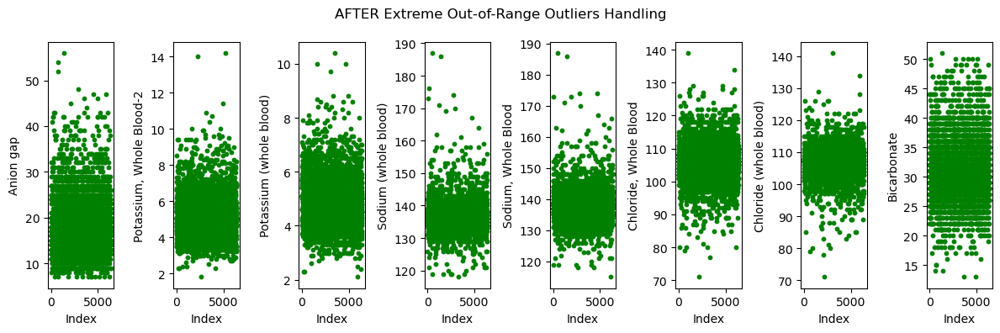

In [32]:
# Summary of cleaned Electrolytes and Acid-Base Balance Group continuation

# Set the thresholds for Electrolytes and Acid-Base Balance variables
max_anion_gap = 100
max_potassium_whole_blood = 30
min_chloride_whole_blood = 50

# Replace out-of-range values with NaN
mimic_iv_clean1['Anion gap'] = np.where(mimic_iv_clean1['Anion gap'] > max_anion_gap, np.nan, mimic_iv_clean1['Anion gap'])
mimic_iv_clean1['Potassium, Whole Blood-2'] = np.where(mimic_iv_clean1['Potassium, Whole Blood-2'] > max_potassium_whole_blood, np.nan, mimic_iv_clean1['Potassium, Whole Blood-2'])
mimic_iv_clean1['Potassium (whole blood)'] = np.where(mimic_iv_clean1['Potassium (whole blood)'] > max_potassium_whole_blood, np.nan, mimic_iv_clean1['Potassium (whole blood)'])
mimic_iv_clean1['Chloride (whole blood)'] = np.where(mimic_iv_clean1['Chloride (whole blood)'] < min_chloride_whole_blood, np.nan, mimic_iv_clean1['Chloride (whole blood)'])

# Summary after replacing out-of-range values with NaN
print("\nSummary of cleaned Electrolytes and Acid-Base Balance Group after replacing out-of-range values")
print(mimic_iv_clean1.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, [19, 22, 23, 24, 25, 26, 27, 28]].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='green')
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()


### Metabolic Parameters Group

Summary of Metabolic Parameters Group
       Creatinine (serum)  Temperature  Glucose (whole blood)
count         6363.000000  2537.000000           3.424000e+03
mean           944.929593    37.391210           2.311856e+03
std          30695.353796     0.931146           4.715157e+04
min              0.300000    32.200000           3.500000e+01
25%              0.900000    36.800000           1.470000e+02
50%              1.200000    37.200000           1.730000e+02
75%              2.100000    37.900000           2.100000e+02
max         999999.000000    40.700000           1.276100e+06


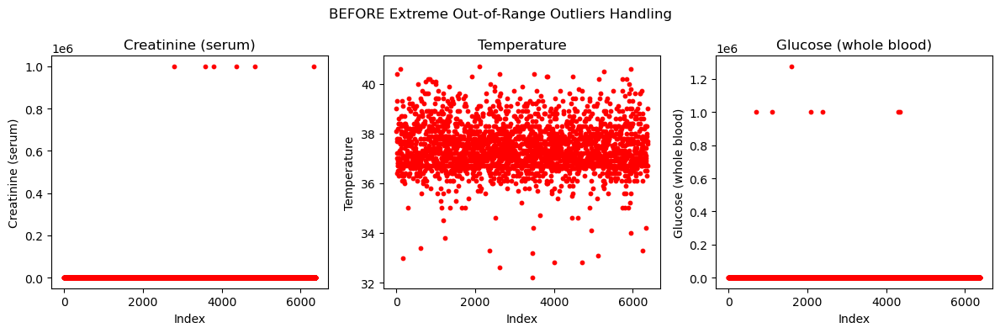


Out-of-range values for Creatinine (serum), Glucose (Whole Blood), and Temperature
Error Value (999999) Creatinine Serum: 6
Creatinine (serum): 7
Glucose (whole blood): 7


In [33]:
# Summary of Metabolic Parameters Group

diflim = len([20, 21, 29])

print("Summary of Metabolic Parameters Group")
print(mimic_iv_clean1.iloc[:, [20, 21, 29]].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, [20, 21, 29]].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, [20, 21, 29]].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Set the thresholds for Creatinine (serum), Glucose (Whole Blood), and Temperature variables
max_creatinine_serum = 40
max_glucose_whole_blood = 3000

# Print out-of-range values for specified variables
print("\nOut-of-range values for Creatinine (serum), Glucose (Whole Blood), and Temperature")
error_cs = sum(mimic_iv_clean1['Creatinine (serum)'] == error)
oor_creatinine_serum = sum(mimic_iv_clean1['Creatinine (serum)'] > max_creatinine_serum)
oor_glucose_whole_blood = sum(mimic_iv_clean1['Glucose (whole blood)'] > max_glucose_whole_blood)
print("Error Value (999999) Creatinine Serum:", error_cs)
print("Creatinine (serum):", oor_creatinine_serum)
print("Glucose (whole blood):", oor_glucose_whole_blood)


Summary of cleaned Metabolic Parameters Group
       Creatinine (serum)  Temperature  Glucose (whole blood)
count         6356.000000  2537.000000            3417.000000
mean             1.968691    37.391210             187.211589
std              2.016245     0.931146              71.610415
min              0.300000    32.200000              35.000000
25%              0.900000    36.800000             147.000000
50%              1.200000    37.200000             173.000000
75%              2.100000    37.900000             210.000000
max             23.000000    40.700000            1183.000000


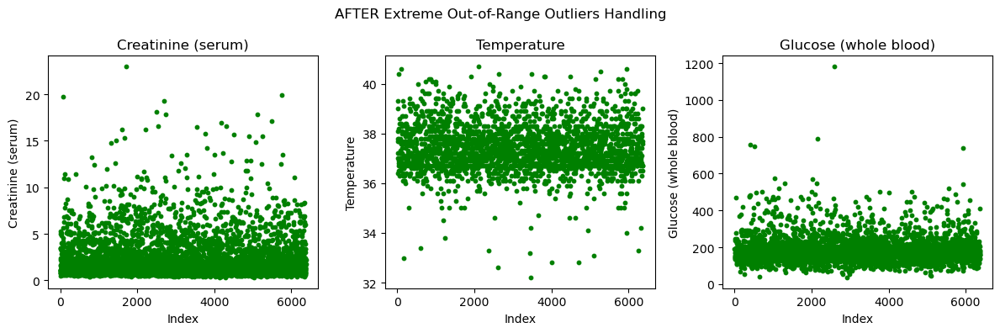

In [34]:
# Summary of cleaned Metabolic Parameters Group

# Replace out-of-range values with NA
mimic_iv_clean1.loc[mimic_iv_clean1['Creatinine (serum)'] > max_creatinine_serum, 'Creatinine (serum)'] = np.nan
mimic_iv_clean1.loc[mimic_iv_clean1['Glucose (whole blood)'] > max_glucose_whole_blood, 'Glucose (whole blood)'] = np.nan

print("\nSummary of cleaned Metabolic Parameters Group")
print(mimic_iv_clean1.iloc[:, [20, 21, 29]].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, [20, 21, 29]].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, [20, 21, 29]].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='green')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

### Hematology Group

Summary of Metabolic Parameters Group
        Hemoglobin  Hemoglobin-2   Hematocrit  Platelet Count
count  4020.000000   6377.000000  6377.000000     6377.000000
mean     12.021866     13.524557    41.140254      339.921907
std       2.692671      1.860455     5.303291      164.069124
min       0.000000      5.100000    18.100000        9.000000
25%      10.700000     12.300000    37.600000      231.000000
50%      12.100000     13.600000    41.400000      304.000000
75%      13.400000     14.800000    44.600000      408.000000
max      97.000000     22.600000    69.700000     2660.000000


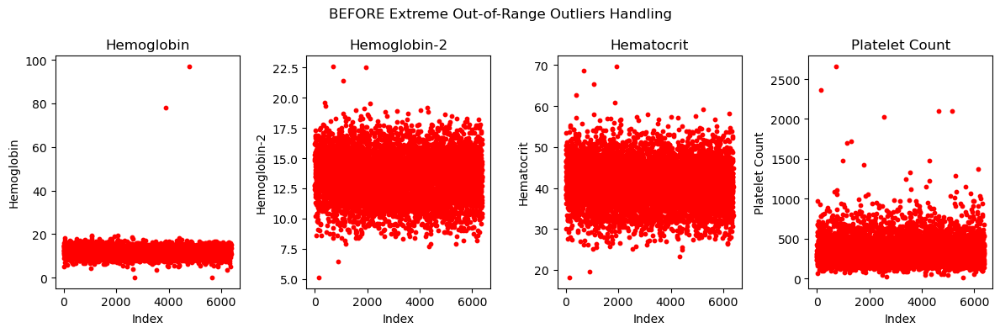


Out-of-range values for Hemoglobin, Hemoglobin.2, Hematocrit, and Platelet Count
Hemoglobin: 2
Platelet Count: 11


In [35]:
# Summary of Hematology Group

startlim = 31
endlim = 35
diflim = endlim - startlim

print("Summary of Metabolic Parameters Group")
print(mimic_iv.iloc[:, startlim:endlim].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv.index, mimic_iv[col], marker='o', s=10, color='red')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("BEFORE Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

# Set the thresholds for Hemoglobin, Hemoglobin-2, Hematocrit, and Platelet Count variables
max_hemoglobin = 40
max_platelet_count = 1350

# Print out-of-range values for specified variables
print("\nOut-of-range values for Hemoglobin, Hemoglobin.2, Hematocrit, and Platelet Count")
oor_hemoglobin = sum(mimic_iv['Hemoglobin'] > max_hemoglobin)
oor_platelet_count = sum(mimic_iv['Platelet Count'] > max_platelet_count)
print("Hemoglobin:", oor_hemoglobin)
print("Platelet Count:", oor_platelet_count)


Summary of cleaned variables
        Hemoglobin  Hemoglobin-2   Hematocrit  Platelet Count
count  4018.000000   6377.000000  6377.000000     6366.000000
mean     11.984296     13.524557    41.140254      337.298932
std       2.090771      1.860455     5.303291      150.644855
min       0.000000      5.100000    18.100000        9.000000
25%      10.700000     12.300000    37.600000      231.000000
50%      12.100000     13.600000    41.400000      304.000000
75%      13.400000     14.800000    44.600000      407.000000
max      19.400000     22.600000    69.700000     1328.000000


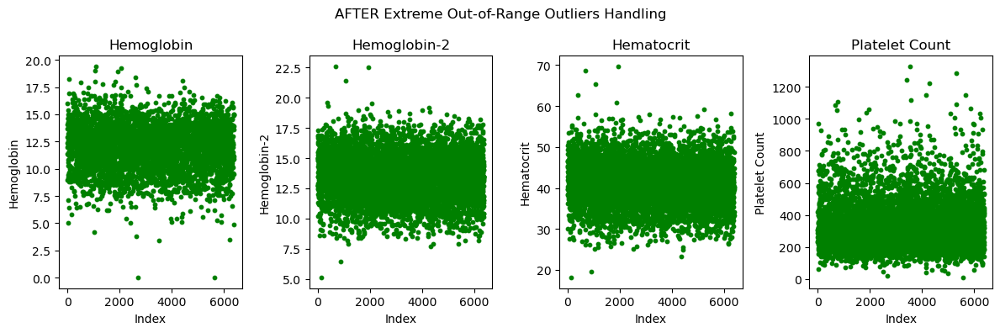

In [36]:
# Summary of cleaned Hematology Group

# Replace out-of-range values with NA
mimic_iv_clean1.loc[mimic_iv_clean1['Hemoglobin'] > max_hemoglobin, 'Hemoglobin'] = np.nan
mimic_iv_clean1.loc[mimic_iv_clean1['Platelet Count'] > max_platelet_count, 'Platelet Count'] = np.nan

print("\nSummary of cleaned variables")
print(mimic_iv_clean1.iloc[:, 31:35].describe())

# Scatter plots using matplotlib
plt.figure(figsize=(12, 4))
num_plots = len(mimic_iv_clean1.iloc[:, startlim:endlim].columns)
num_rows = (num_plots // diflim) + (1 if num_plots % diflim != 0 else 0)

for i, col in enumerate(mimic_iv_clean1.iloc[:, startlim:endlim].columns):
    plt.subplot(num_rows, diflim, i+1)
    plt.scatter(mimic_iv_clean1.index, mimic_iv_clean1[col], marker='o', s=10, color='green')
    plt.title(col)
    plt.xlabel("Index")
    plt.ylabel(col)

plt.suptitle("AFTER Extreme Out-of-Range Outliers Handling")
plt.tight_layout()
plt.show()

In [37]:
# missing values column-wise
na_count = mimic_iv_clean1.isnull().sum() # total count
na_pct = (na_count/len(mimic_iv_clean1))*100 # percentage

na_mimic_iv_c1 = pd.DataFrame({'Count': na_count.values,
                      'Percentage (%)': na_pct}).reset_index().rename(columns = {'index': 'Feature'})

print(f'The total number of missing values is: {na_count.sum()}')
print(na_mimic_iv_c1.sort_values(by='Percentage (%)', ascending=False))

The total number of missing values is: 37685
                                               Feature  Count  Percentage (%)
21                                         Temperature   3840       60.216403
27                              Chloride (whole blood)   3571       55.998118
24                                Sodium (whole blood)   3364       52.752078
29                               Glucose (whole blood)   2960       46.416810
23                             Potassium (whole blood)   2809       44.048926
10                   Arterial Blood Pressure diastolic   2509       39.344519
13                              Respiratory Rate (Set)   2481       38.905441
8                     Arterial Blood Pressure systolic   2479       38.874079
31                                          Hemoglobin   2359       36.992316
14                      Respiratory Rate (spontaneous)   2311       36.239611
15                            Respiratory Rate (Total)   2293       35.957347
26                 

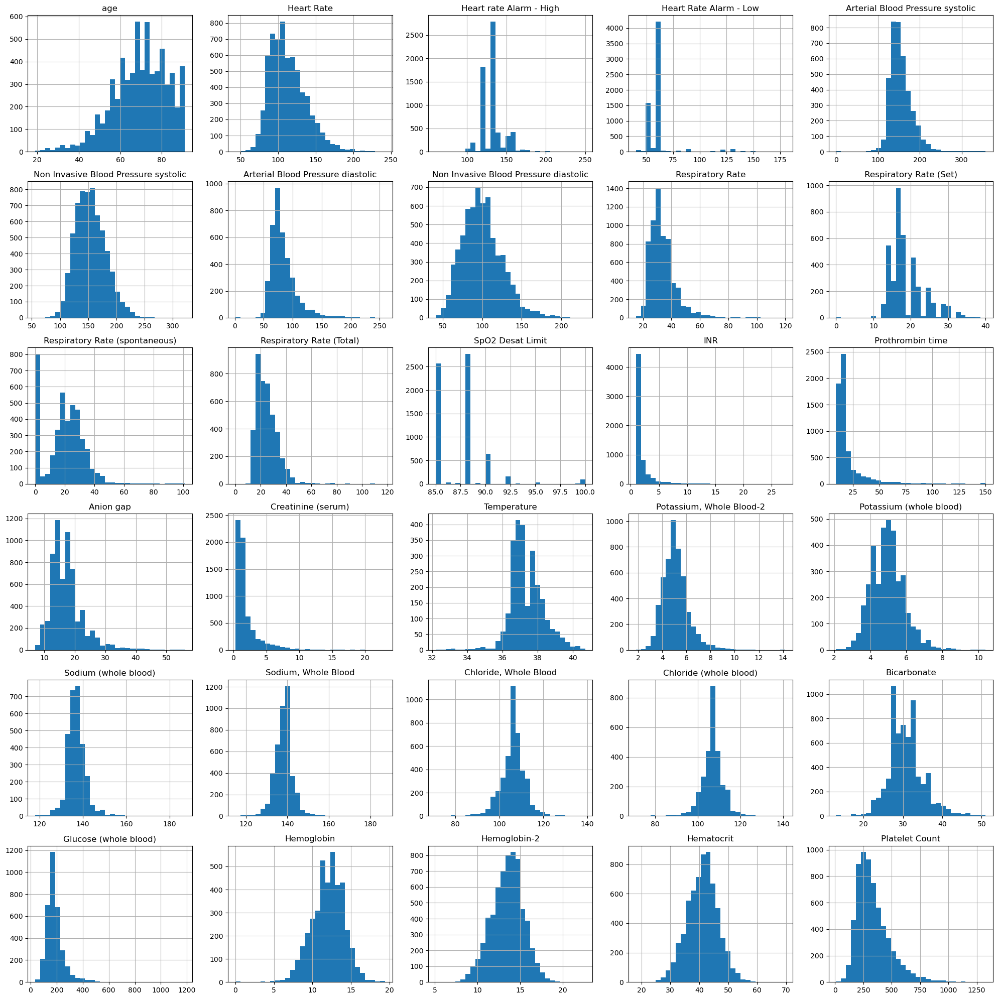

In [38]:
mimic_iv_clean1.select_dtypes(include=['int64', 'float64']).iloc[:, 1:].hist(bins=30, figsize=(20, 20))

plt.tight_layout()
plt.show()

# PART 4: Missing Values Handling

## Aproach N°1

In [39]:
# Drop any missing values
mimic_iv_clean1_nona = mimic_iv_clean1.dropna() # Dataset deep cleaned

# Create the scatter plot matrix with correlations
#sns.pairplot(mimic_iv_clean1_nona.select_dtypes(include=['int64', 'float64']).iloc[:, 1:], kind='scatter', diag_kind='kde')

# Display the plot
#plt.show()

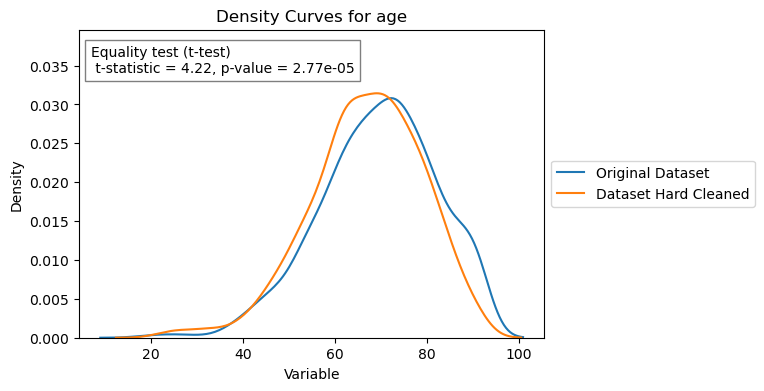

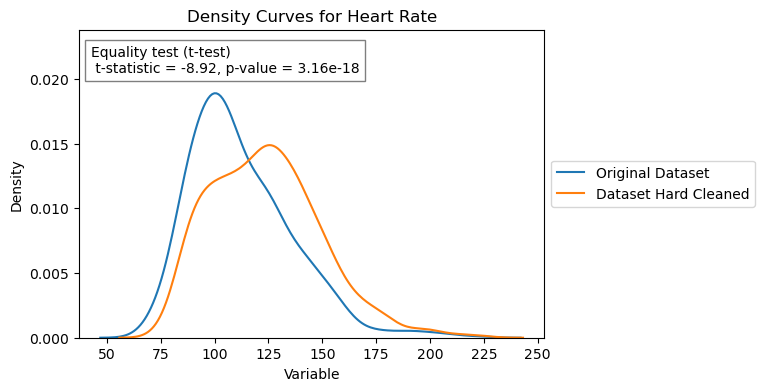

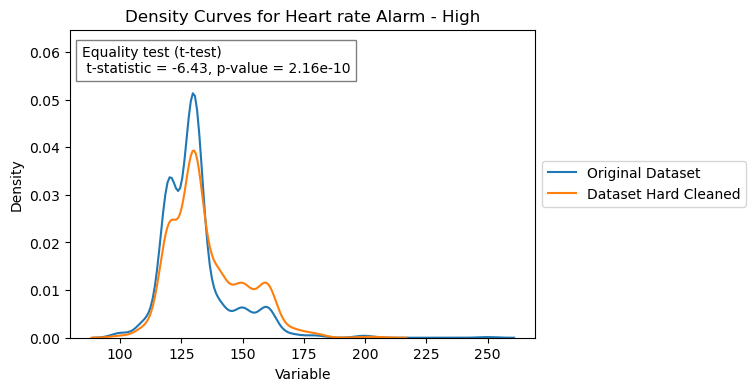

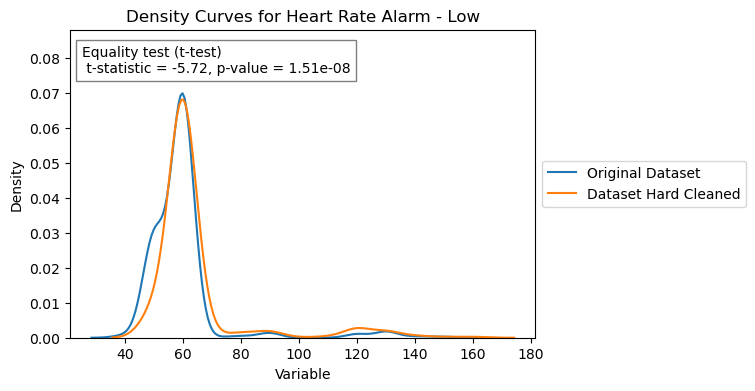

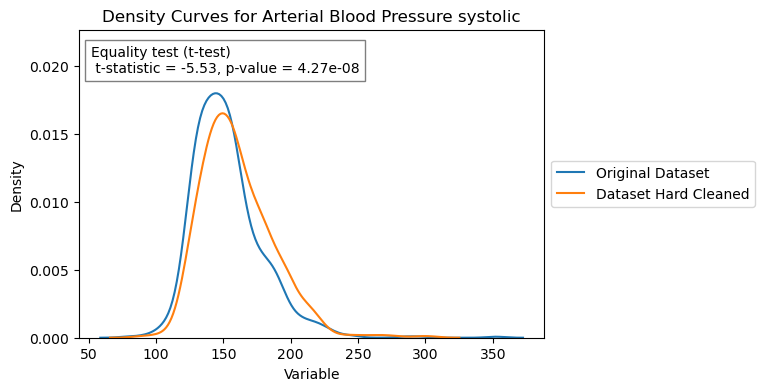

...

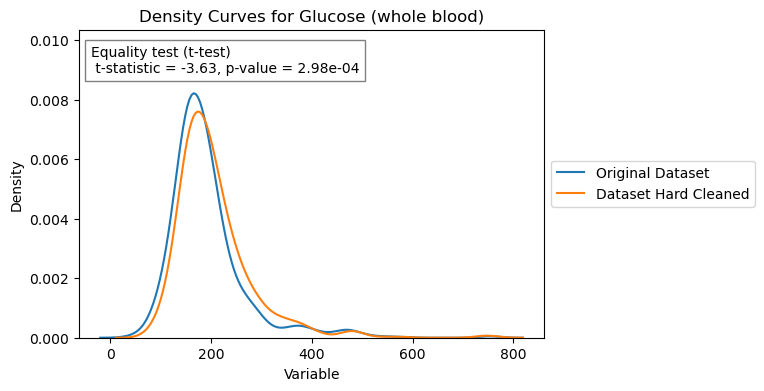

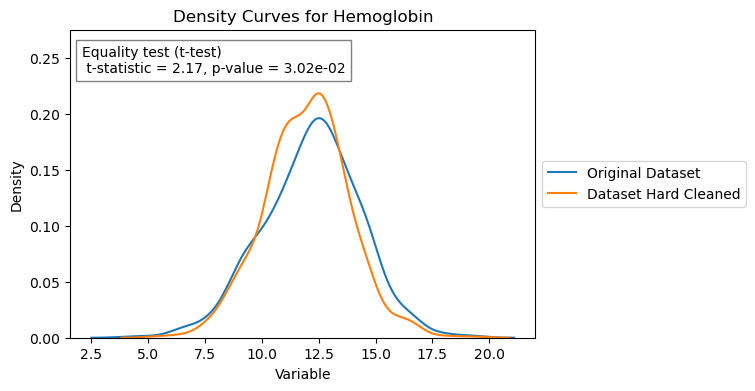

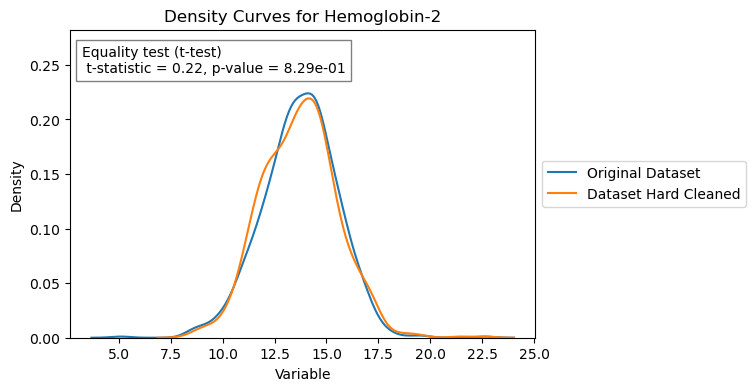

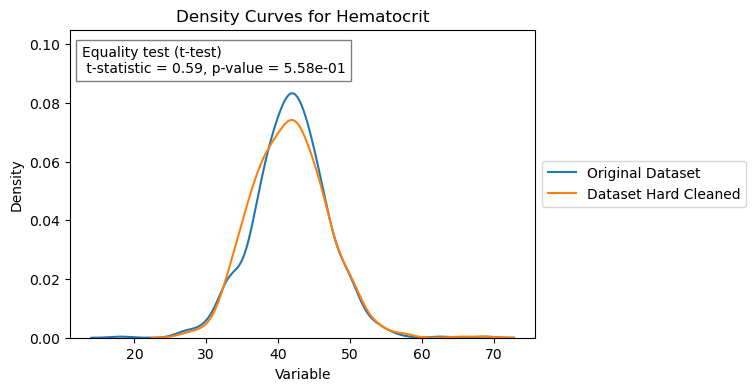

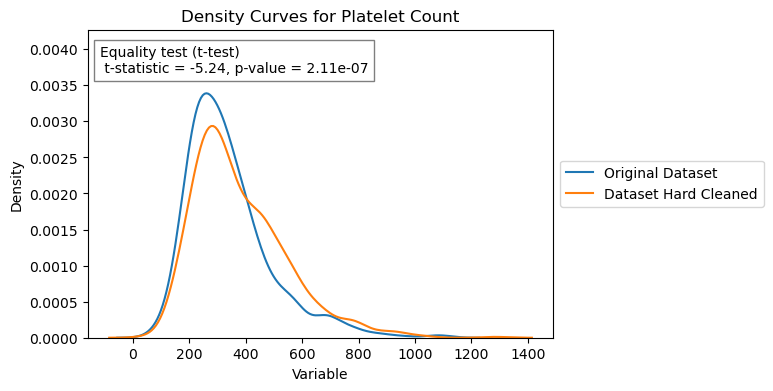

In [40]:
df1 = mimic_iv_clean1.select_dtypes(include=['int64', 'float64']).iloc[:, 1:]
df2 = mimic_iv_clean1_nona.select_dtypes(include=['int64', 'float64']).iloc[:, 1:]

# Check if both datasets have the same number of variables
if len(df1.columns) != len(df2.columns):
    print("Number of variables in both datasets are not equal!")
    exit()

# Iterate through each variable
for i, (var1, var2) in enumerate(zip(df1.columns, df2.columns)):
    plt.figure(figsize=(6, 4))
    
    # Drop observations with missing values in both datasets
    df1_dropna = df1[[var1]].dropna()
    df2_dropna = df2[[var2]].dropna()
    
    # Ensure both variables have the same length
    min_length = min(len(df1_dropna), len(df2_dropna))
    df1_dropna = df1_dropna.head(min_length)
    df2_dropna = df2_dropna.head(min_length)

    # Generate density plot for variable from dataset 1
    sns.kdeplot(df1_dropna[var1], label='Original Dataset')

    # Generate density plot for variable from dataset 2
    sns.kdeplot(df2_dropna[var2], label='Dataset Hard Cleaned')

    # Add labels and title
    plt.xlabel('Variable')
    plt.ylabel('Density')
    plt.title(f'Density Curves for {var1}')
    
    # Adjust y-axis limits
    plt.ylim(0, plt.ylim()[1] * 1.2)

    # Test for equality
    t_stat, p_val_ttest = ttest_rel(df1_dropna[var1], df2_dropna[var2])
    w_stat, p_val_wilcoxon = wilcoxon(df1_dropna[var1], df2_dropna[var2])
    
    # Add equality test results (t-test) to the plot
    textstr = f"Equality test (t-test)\n t-statistic = {t_stat:.2f}, p-value = {p_val_ttest:.2e}"
    plt.text(0.025, 0.95, textstr, transform=plt.gca().transAxes, fontsize=10,
             verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

    # Place legend on the right-hand side
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    # Show the plot
    plt.show()

## Aproach N°2

In [41]:
# Filter variables with more than 20% missing values
variables_to_drop = na_mimic_iv_c1[na_mimic_iv_c1['Percentage (%)'] > 20]['Feature']

# Drop these variables from mimic_iv_clean1
mimic_iv_clean1_colDrop = mimic_iv_clean1.drop(variables_to_drop, axis=1)

# Now mimic_iv_clean1 contains only the variables with less than or equal to 20% missing values

# Drop any missing values
mimic_iv_clean1_colDrop_nona = mimic_iv_clean1_colDrop.dropna() # Dataset deep cleaned

# Create the scatter plot matrix with correlations
#sns.pairplot(mimic_iv_clean1_colDrop_nona.select_dtypes(include=['int64', 'float64']).iloc[:, 1:], kind='scatter', diag_kind='kde')

# Display the plot
#plt.show()

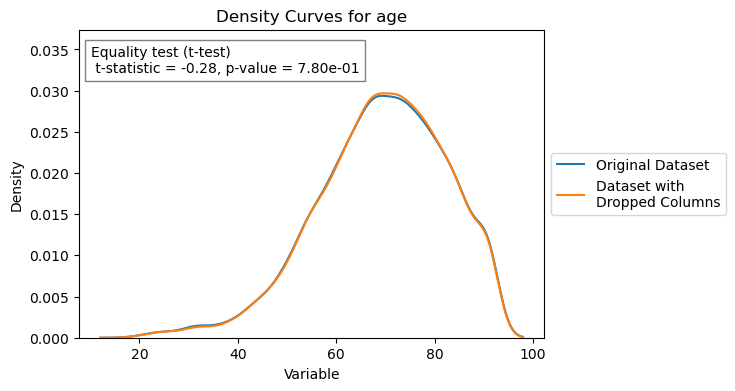

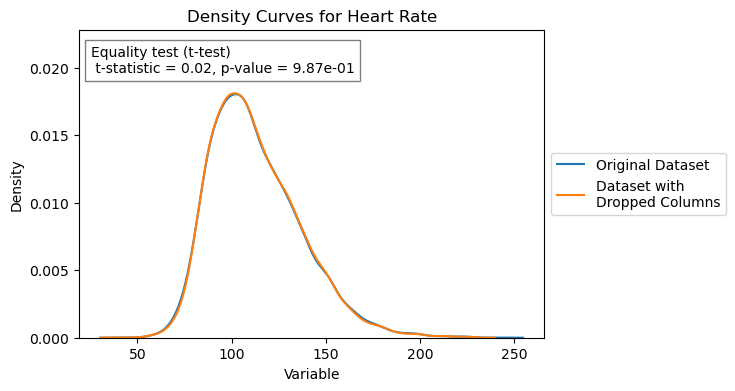

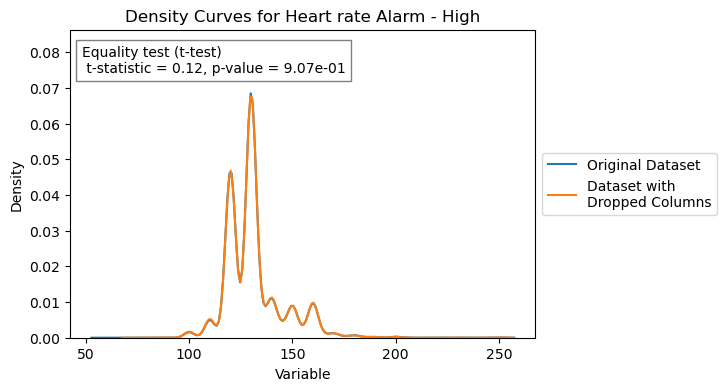

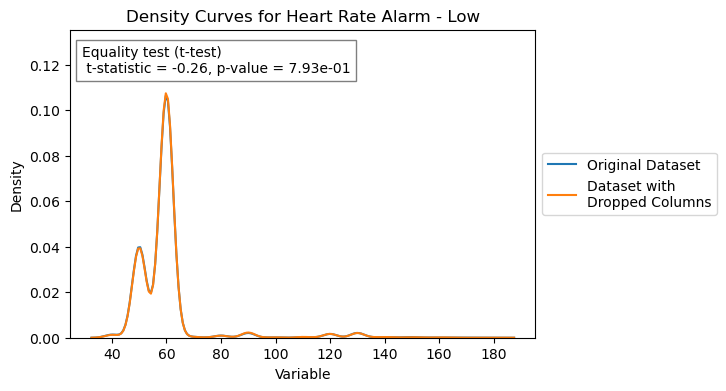

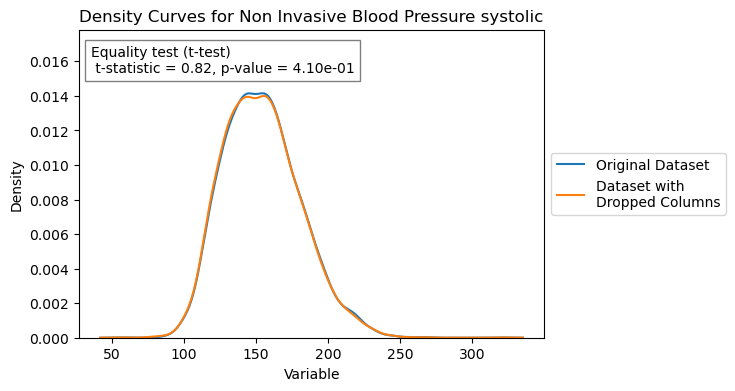

...

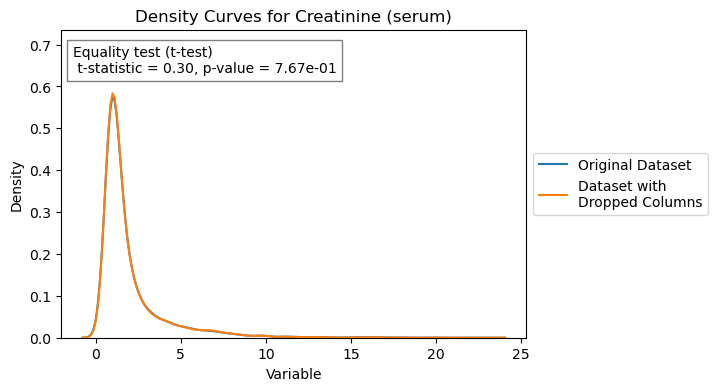

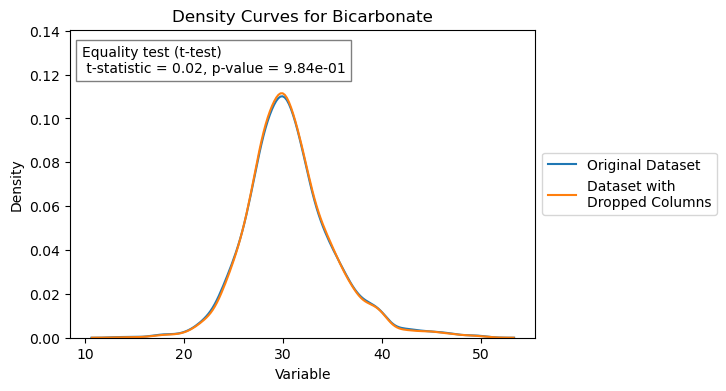

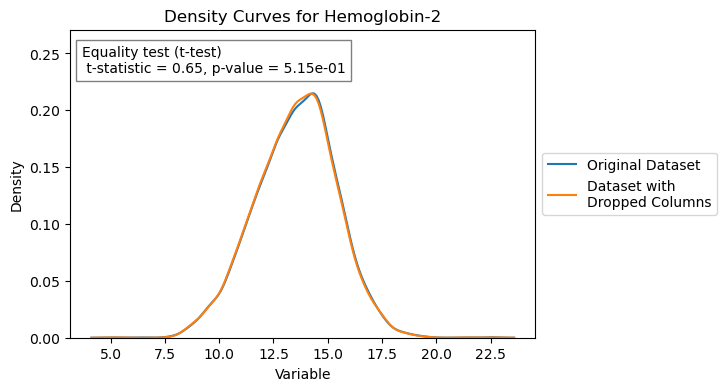

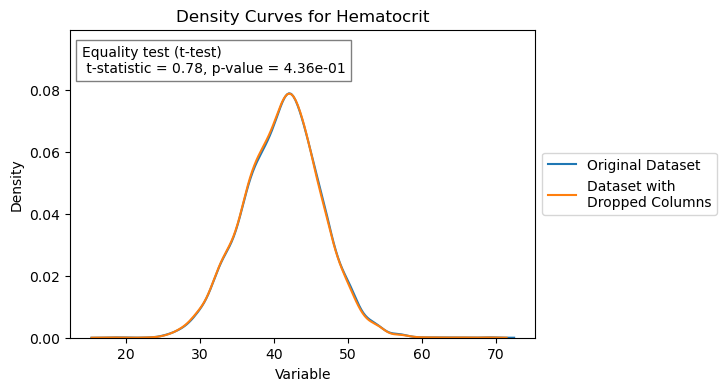

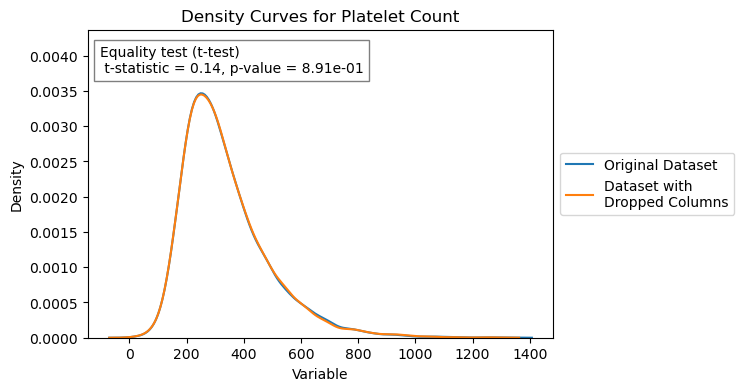

In [42]:
df1 = mimic_iv_clean1.select_dtypes(include=['int64', 'float64']).iloc[:, 1:]
df2 = mimic_iv_clean1_colDrop_nona.select_dtypes(include=['int64', 'float64']).iloc[:, 1:]

features = df2.columns

df1 = df1[features]

# Check if both datasets have the same number of variables
if len(df1.columns) != len(df2.columns):
    print("Number of variables in both datasets are not equal!")
    exit()

# Iterate through each variable
for i, (var1, var2) in enumerate(zip(df1.columns, df2.columns)):
    plt.figure(figsize=(6, 4))
    
    # Drop observations with missing values in both datasets
    df1_dropna = df1[[var1]].dropna()
    df2_dropna = df2[[var2]].dropna()
    
    # Ensure both variables have the same length
    min_length = min(len(df1_dropna), len(df2_dropna))
    df1_dropna = df1_dropna.head(min_length)
    df2_dropna = df2_dropna.head(min_length)

    # Generate density plot for variable from dataset 1
    sns.kdeplot(df1_dropna[var1], label='Original Dataset')

    # Generate density plot for variable from dataset 2
    sns.kdeplot(df2_dropna[var2], label='Dataset with\nDropped Columns')

    # Add labels and title
    plt.xlabel('Variable')
    plt.ylabel('Density')
    plt.title(f'Density Curves for {var1}')
    
    # Adjust y-axis limits
    plt.ylim(0, plt.ylim()[1] * 1.2)

    # Test for equality
    t_stat, p_val_ttest = ttest_rel(df1_dropna[var1], df2_dropna[var2])
    w_stat, p_val_wilcoxon = wilcoxon(df1_dropna[var1], df2_dropna[var2])
    
    # Add equality test results (t-test) to the plot
    textstr = f"Equality test (t-test)\n t-statistic = {t_stat:.2f}, p-value = {p_val_ttest:.2e}"
    plt.text(0.025, 0.95, textstr, transform=plt.gca().transAxes, fontsize=10,
             verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

    # Place legend on the right-hand side
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    # Show the plot
    plt.show()

## Aproach N°3

### **Blood Pressure Systolic**

In [43]:
Var1 = mimic_iv_clean1['Arterial Blood Pressure systolic']
Var2 = mimic_iv_clean1['Non Invasive Blood Pressure systolic']

# Assuming Var1 and Var2 are Series objects containing your variables

# Drop missing values from both variables
Var1_dropna = Var1.dropna()
Var2_dropna = Var2.dropna()

# Align the indices of Var1 and Var2
Var1_aligned, Var2_aligned = Var1_dropna.align(Var2_dropna, join='inner')

# Test for correlation
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var2_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var2_aligned)

print(f"Pearson correlation coefficient: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient: {corr_coef_spearman}, p-value = {p_val_spearman}")


Pearson correlation coefficient: 0.5041982652938904, p-value = 1.3266817100598243e-247
Spearman correlation coefficient: 0.5390937339232027, p-value = 1.746480682288025e-289


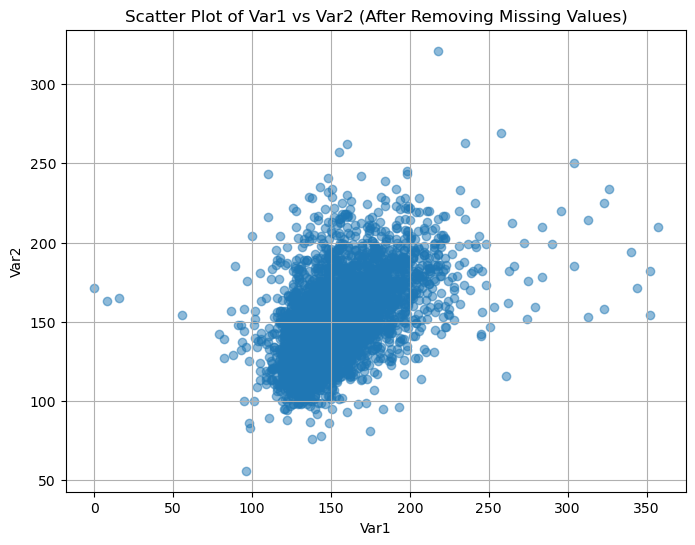

In [44]:
plt.figure(figsize=(8, 6))
plt.scatter(Var1_aligned, Var2_aligned, alpha=0.5)  # Plot Var1 on x-axis and Var2 on y-axis
plt.xlabel('Var1')
plt.ylabel('Var2')
plt.title('Scatter Plot of Var1 vs Var2 (After Removing Missing Values)')
plt.grid(True)
plt.show()

In [45]:
Var1 = mimic_iv_clean1['Arterial Blood Pressure systolic']
Var2 = mimic_iv_clean1['Non Invasive Blood Pressure systolic']

# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')
#print(na_mimic_iv_c1.sort_values(by='Percentage (%)', ascending=False))

The total number of missing values in Var1 is: 2479 and the percentage is: 38.87%
The total number of missing values in Var2 is: 49 and the percentage is: 0.77%


In [46]:
mimic_iv_clean2 = mimic_iv_clean1

mimic_iv_clean2 = mimic_iv_clean2.drop('Arterial Blood Pressure systolic', axis=1)

Because the p-value in the Spearman correlation is less than 0.05 we can say that the correlation between the two variables is statistically significant, and having more than 30% missing values in one of them, we decide to erase that incomplete variable and continue with the other, assuming that with just one we can have enough information for that group of variables.

### **Blood Pressure Diastolic**

In [47]:
Var1 = mimic_iv_clean1['Arterial Blood Pressure diastolic']
Var2 = mimic_iv_clean1['Non Invasive Blood Pressure diastolic']

# Assuming Var1 and Var2 are Series objects containing your variables

# Drop missing values from both variables
Var1_dropna = Var1.dropna()
Var2_dropna = Var2.dropna()

# Align the indices of Var1 and Var2
Var1_aligned, Var2_aligned = Var1_dropna.align(Var2_dropna, join='inner')

# Test for correlation
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var2_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var2_aligned)

print(f"Pearson correlation coefficient: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient: {corr_coef_spearman}, p-value = {p_val_spearman}")

Pearson correlation coefficient: 0.31979486661503825, p-value = 2.9294010096886045e-91
Spearman correlation coefficient: 0.336925165827634, p-value = 1.0587943316787877e-101


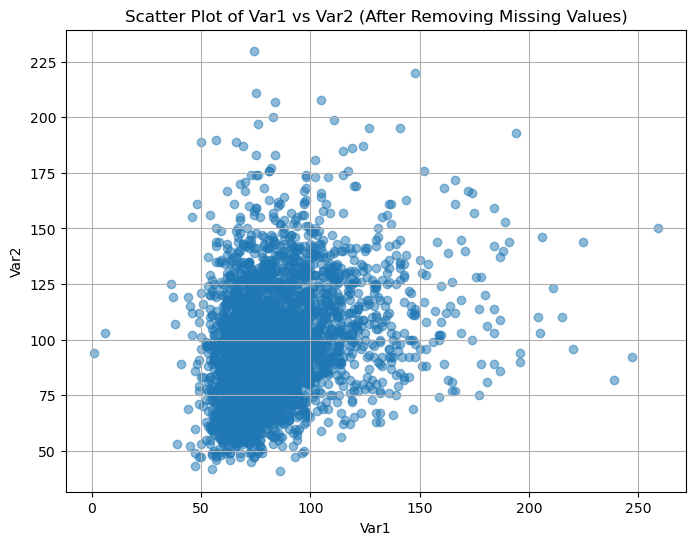

In [48]:
plt.figure(figsize=(8, 6))
plt.scatter(Var1_aligned, Var2_aligned, alpha=0.5)  # Plot Var1 on x-axis and Var2 on y-axis
plt.xlabel('Var1')
plt.ylabel('Var2')
plt.title('Scatter Plot of Var1 vs Var2 (After Removing Missing Values)')
plt.grid(True)
plt.show()

In [49]:
# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')

The total number of missing values in Var1 is: 2509 and the percentage is: 39.34%
The total number of missing values in Var2 is: 79 and the percentage is: 1.24%


In [50]:
mimic_iv_clean2 = mimic_iv_clean2.drop('Arterial Blood Pressure diastolic', axis=1)

Because the p-value in the Spearman correlation is less than 0.05 we can say that the correlation between the two variables is statistically significant, and having more than 30% missing values in one of them, we decide to erase that incomplete variable and continue with the other, assuming that with just one we can have enough information for that group of variables.

### **Respiratory Rate**

In [51]:
Var1 = mimic_iv_clean1['Respiratory Rate']
Var2 = mimic_iv_clean1['Respiratory Rate (Set)']
Var3 = mimic_iv_clean1['Respiratory Rate (spontaneous)']
Var4 = mimic_iv_clean1['Respiratory Rate (Total)']

# Drop missing values from all variables
Var1_dropna = Var1.dropna()
Var2_dropna = Var2.dropna()
Var3_dropna = Var3.dropna()
Var4_dropna = Var4.dropna()

# Align the indices of all variables
Var1_aligned, Var2_aligned = Var1_dropna.align(Var2_dropna, join='inner')

# Test for correlation
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var2_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var2_aligned)

print(f"Pearson correlation coefficient between Var1 and Var2: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var1 and Var2: {corr_coef_spearman}, p-value = {p_val_spearman}")

Var1_aligned, Var3_aligned = Var1_dropna.align(Var3_dropna, join='inner')

# Test for correlation between Var1 and Var3
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var3_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var3_aligned)

print(f"Pearson correlation coefficient between Var1 and Var3: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var1 and Var3: {corr_coef_spearman}, p-value = {p_val_spearman}")

Var1_aligned, Var4_aligned = Var1_dropna.align(Var4_dropna, join='inner')

# Test for correlation between Var1 and Var4
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var4_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var4_aligned)

print(f"Pearson correlation coefficient between Var1 and Var4: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var1 and Var4: {corr_coef_spearman}, p-value = {p_val_spearman}")

Pearson correlation coefficient between Var1 and Var2: 0.3150281419246368, p-value = 6.273261076562369e-90
Spearman correlation coefficient between Var1 and Var2: 0.3408913601570055, p-value = 6.164211216742779e-106
Pearson correlation coefficient between Var1 and Var3: 0.35677665708585626, p-value = 1.3581069030952781e-121
Spearman correlation coefficient between Var1 and Var3: 0.43989375978477796, p-value = 6.845734489425297e-191
Pearson correlation coefficient between Var1 and Var4: 0.3985157797467404, p-value = 1.378572761155603e-154
Spearman correlation coefficient between Var1 and Var4: 0.49289144813374136, p-value = 1.6528653713225318e-247


In [52]:
# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var3
Var3_na_count = Var3.isnull().sum() # Total count
Var3_na_pct = (Var3_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var4
Var4_na_count = Var4.isnull().sum() # Total count
Var4_na_pct = (Var4_na_count / len(mimic_iv_clean1)) * 100 # Percentage

print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')
print(f'The total number of missing values in Var3 is: {Var3_na_count} and the percentage is: {Var3_na_pct:.2f}%')
print(f'The total number of missing values in Var4 is: {Var4_na_count} and the percentage is: {Var4_na_pct:.2f}%')

The total number of missing values in Var1 is: 27 and the percentage is: 0.42%
The total number of missing values in Var2 is: 2481 and the percentage is: 38.91%
The total number of missing values in Var3 is: 2311 and the percentage is: 36.24%
The total number of missing values in Var4 is: 2293 and the percentage is: 35.96%


In [53]:
mimic_iv_clean2 = mimic_iv_clean2.drop('Respiratory Rate (Set)', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Respiratory Rate (spontaneous)', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Respiratory Rate (Total)', axis=1)

Because the p-value in the Spearman correlation is less than 0.05 in the last 3 variables, we can say that the correlation between the 4 variables is statistically significant, and having more than 30% missing values in the last 3 of them, we decide to erase those with high amount of data missing and continue with the first one, assuming that with just one we can have enough information for that group of variables.

### **Duplicated Variables**

In [54]:
Var1 = mimic_iv_clean1['Potassium (whole blood)']
Var2 = mimic_iv_clean1['Potassium, Whole Blood-2']
Var3 = mimic_iv_clean1['Sodium (whole blood)']
Var4 = mimic_iv_clean1['Sodium, Whole Blood']
Var5 = mimic_iv_clean1['Chloride (whole blood)']
Var6 = mimic_iv_clean1['Chloride, Whole Blood']
Var7 = mimic_iv_clean1['Hemoglobin']
Var8 = mimic_iv_clean1['Hemoglobin-2']


# Drop missing values from all variables
Var1_dropna = Var1.dropna()
Var2_dropna = Var2.dropna()
Var3_dropna = Var3.dropna()
Var4_dropna = Var4.dropna()
Var5_dropna = Var5.dropna()
Var6_dropna = Var6.dropna()
Var7_dropna = Var7.dropna()
Var8_dropna = Var8.dropna()

# Align the indices of all variables
Var1_aligned, Var2_aligned = Var1_dropna.align(Var2_dropna, join='inner')

# Test for correlation
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var2_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var2_aligned)

print(f"Pearson correlation coefficient between Var1 and Var2: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var1 and Var2: {corr_coef_spearman}, p-value = {p_val_spearman}")

Var3_aligned, Var4_aligned = Var3_dropna.align(Var4_dropna, join='inner')

# Test for correlation between Var3 and Var4
corr_coef_pearson, p_val_pearson = pearsonr(Var3_aligned, Var4_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var3_aligned, Var4_aligned)

print(f"Pearson correlation coefficient between Var3 and Var4: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var3 and Var4: {corr_coef_spearman}, p-value = {p_val_spearman}")

Var5_aligned, Var6_aligned = Var5_dropna.align(Var6_dropna, join='inner')

# Test for correlation between Var5 and Var6
corr_coef_pearson, p_val_pearson = pearsonr(Var5_aligned, Var6_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var5_aligned, Var6_aligned)

print(f"Pearson correlation coefficient between Var5 and Var6: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var5 and Var6: {corr_coef_spearman}, p-value = {p_val_spearman}")

Var7_aligned, Var8_aligned = Var7_dropna.align(Var8_dropna, join='inner')

# Test for correlation between Var7 and Var8
corr_coef_pearson, p_val_pearson = pearsonr(Var7_aligned, Var8_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var7_aligned, Var8_aligned)

print(f"Pearson correlation coefficient between Var7 and Var8: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var7 and Var8: {corr_coef_spearman}, p-value = {p_val_spearman}")

Pearson correlation coefficient between Var1 and Var2: 0.7317677043374683, p-value = 0.0
Spearman correlation coefficient between Var1 and Var2: 0.7838186268476319, p-value = 0.0
Pearson correlation coefficient between Var3 and Var4: 0.8607112038965613, p-value = 0.0
Spearman correlation coefficient between Var3 and Var4: 0.7867712159635801, p-value = 0.0
Pearson correlation coefficient between Var5 and Var6: 0.917147542935421, p-value = 0.0
Spearman correlation coefficient between Var5 and Var6: 0.93929630671401, p-value = 0.0
Pearson correlation coefficient between Var7 and Var8: 0.6103088406089308, p-value = 0.0
Spearman correlation coefficient between Var7 and Var8: 0.6271998157461605, p-value = 0.0


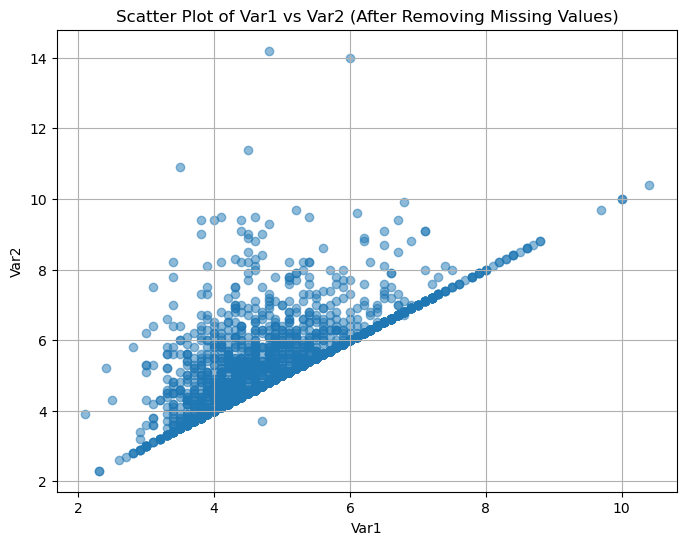

In [55]:
plt.figure(figsize=(8, 6))
plt.scatter(Var1_aligned, Var2_aligned, alpha=0.5)  # Plot Var1 on x-axis and Var2 on y-axis
plt.xlabel('Var1')
plt.ylabel('Var2')
plt.title('Scatter Plot of Var1 vs Var2 (After Removing Missing Values)')
plt.grid(True)
plt.show()

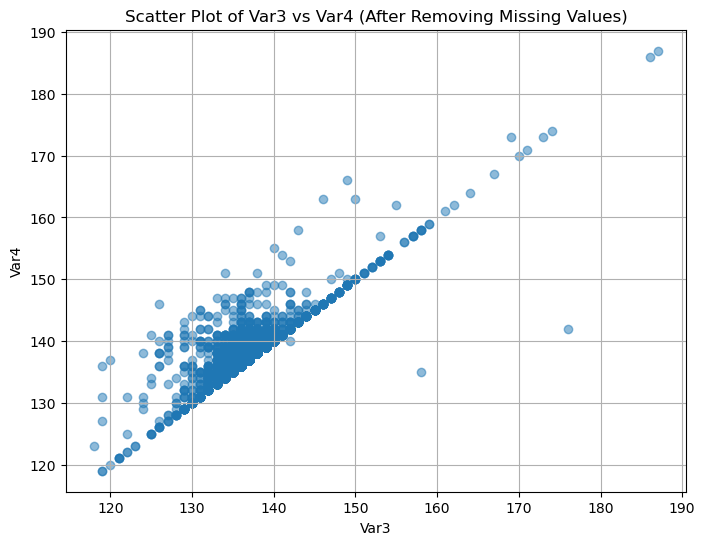

In [56]:
plt.figure(figsize=(8, 6))
plt.scatter(Var3_aligned, Var4_aligned, alpha=0.5)  # Plot Var1 on x-axis and Var2 on y-axis
plt.xlabel('Var3')
plt.ylabel('Var4')
plt.title('Scatter Plot of Var3 vs Var4 (After Removing Missing Values)')
plt.grid(True)
plt.show()

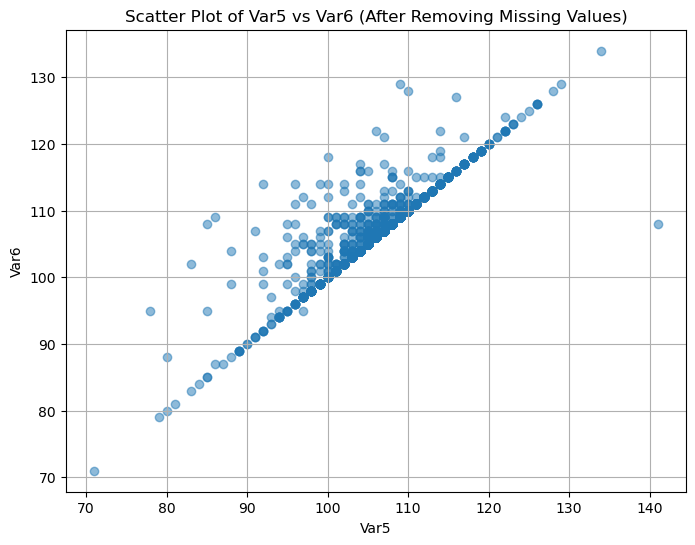

In [57]:
plt.figure(figsize=(8, 6))
plt.scatter(Var5_aligned, Var6_aligned, alpha=0.5)  # Plot Var1 on x-axis and Var2 on y-axis
plt.xlabel('Var5')
plt.ylabel('Var6')
plt.title('Scatter Plot of Var5 vs Var6 (After Removing Missing Values)')
plt.grid(True)
plt.show()

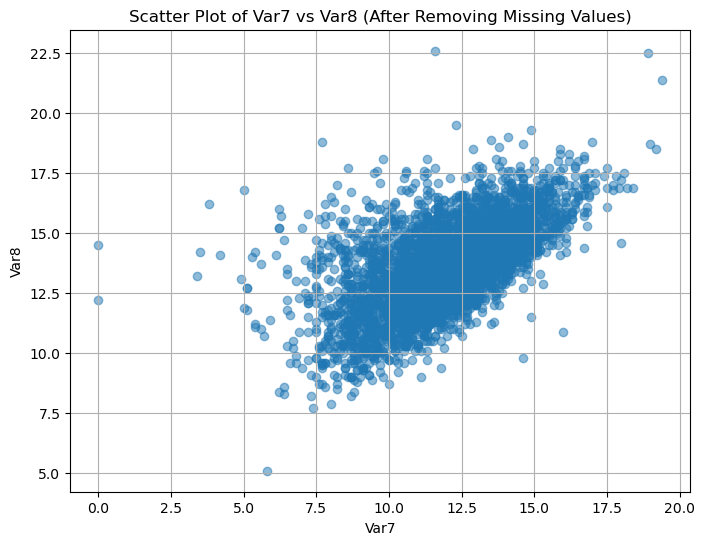

In [58]:
plt.figure(figsize=(8, 6))
plt.scatter(Var7_aligned, Var8_aligned, alpha=0.5)  # Plot Var1 on x-axis and Var2 on y-axis
plt.xlabel('Var7')
plt.ylabel('Var8')
plt.title('Scatter Plot of Var7 vs Var8 (After Removing Missing Values)')
plt.grid(True)
plt.show()

In [59]:
# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var3
Var3_na_count = Var3.isnull().sum() # Total count
Var3_na_pct = (Var3_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var4
Var4_na_count = Var4.isnull().sum() # Total count
Var4_na_pct = (Var4_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var5
Var5_na_count = Var5.isnull().sum() # Total count
Var5_na_pct = (Var5_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var6
Var6_na_count = Var6.isnull().sum() # Total count
Var6_na_pct = (Var6_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var7
Var7_na_count = Var7.isnull().sum() # Total count
Var7_na_pct = (Var7_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var8
Var8_na_count = Var8.isnull().sum() # Total count
Var8_na_pct = (Var8_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Print results for all variables
print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')
print(f'The total number of missing values in Var3 is: {Var3_na_count} and the percentage is: {Var3_na_pct:.2f}%')
print(f'The total number of missing values in Var4 is: {Var4_na_count} and the percentage is: {Var4_na_pct:.2f}%')
print(f'The total number of missing values in Var5 is: {Var5_na_count} and the percentage is: {Var5_na_pct:.2f}%')
print(f'The total number of missing values in Var6 is: {Var6_na_count} and the percentage is: {Var6_na_pct:.2f}%')
print(f'The total number of missing values in Var7 is: {Var7_na_count} and the percentage is: {Var7_na_pct:.2f}%')
print(f'The total number of missing values in Var8 is: {Var8_na_count} and the percentage is: {Var8_na_pct:.2f}%')

The total number of missing values in Var1 is: 2809 and the percentage is: 44.05%
The total number of missing values in Var2 is: 1443 and the percentage is: 22.63%
The total number of missing values in Var3 is: 3364 and the percentage is: 52.75%
The total number of missing values in Var4 is: 2121 and the percentage is: 33.26%
The total number of missing values in Var5 is: 3571 and the percentage is: 56.00%
The total number of missing values in Var6 is: 2267 and the percentage is: 35.55%
The total number of missing values in Var7 is: 2359 and the percentage is: 36.99%
The total number of missing values in Var8 is: 0 and the percentage is: 0.00%


In [60]:
# Calculate average Potassium
mimic_iv_clean2['AvgPotassium'] = mimic_iv_clean1[['Potassium (whole blood)', 'Potassium, Whole Blood-2']].mean(axis=1, skipna=True)

# Calculate average Sodium
mimic_iv_clean2['AvgSodium'] = mimic_iv_clean1[['Sodium (whole blood)', 'Sodium, Whole Blood']].mean(axis=1, skipna=True)

# Calculate average Chloride
mimic_iv_clean2['AvgChloride'] = mimic_iv_clean1[['Chloride (whole blood)', 'Chloride, Whole Blood']].mean(axis=1, skipna=True)

# Calculate average Hemoglobin
mimic_iv_clean2['AvgHemoglobin'] = mimic_iv_clean1[['Hemoglobin', 'Hemoglobin-2']].mean(axis=1, skipna=True)


Var1 = mimic_iv_clean2['AvgPotassium']
Var2 = mimic_iv_clean2['AvgSodium']
Var3 = mimic_iv_clean2['AvgChloride']
Var4 = mimic_iv_clean2['AvgHemoglobin']


# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var3
Var3_na_count = Var3.isnull().sum() # Total count
Var3_na_pct = (Var3_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var3
Var4_na_count = Var4.isnull().sum() # Total count
Var4_na_pct = (Var4_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Print results for all variables
print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')
print(f'The total number of missing values in Var3 is: {Var3_na_count} and the percentage is: {Var3_na_pct:.2f}%')
print(f'The total number of missing values in Var4 is: {Var4_na_count} and the percentage is: {Var4_na_pct:.2f}%')


The total number of missing values in Var1 is: 1443 and the percentage is: 22.63%
The total number of missing values in Var2 is: 2119 and the percentage is: 33.23%
The total number of missing values in Var3 is: 2265 and the percentage is: 35.52%
The total number of missing values in Var4 is: 0 and the percentage is: 0.00%


In [61]:
mimic_iv_clean2 = mimic_iv_clean2.drop('Potassium (whole blood)', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Potassium, Whole Blood-2', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Sodium (whole blood)', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Sodium, Whole Blood', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Chloride (whole blood)', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Chloride, Whole Blood', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Hemoglobin', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Hemoglobin-2', axis=1)

In [62]:
# Specify the columns where you want to impute missing values with the median
columns_to_impute = ['AvgPotassium', 'AvgSodium', 'AvgChloride']

# Impute missing values with the median for the specified columns
for column in columns_to_impute:
    mimic_iv_clean2[column].fillna(mimic_iv_clean2[column].median(), inplace=True)

Var1 = mimic_iv_clean2['AvgPotassium']
Var2 = mimic_iv_clean2['AvgSodium']
Var3 = mimic_iv_clean2['AvgChloride']

# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var3
Var3_na_count = Var3.isnull().sum() # Total count
Var3_na_pct = (Var3_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Print results for all variables
print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')
print(f'The total number of missing values in Var3 is: {Var3_na_count} and the percentage is: {Var3_na_pct:.2f}%')

The total number of missing values in Var1 is: 0 and the percentage is: 0.00%
The total number of missing values in Var2 is: 0 and the percentage is: 0.00%
The total number of missing values in Var3 is: 0 and the percentage is: 0.00%


**ADJUST THIS PART**: Because the p-value in the Spearman correlation is less than 0.05 in the last 7 variables, we can say that the correlation between the 8 variables is statistically significant, and having more than 30% missing values for the variables 2, 4, 5, 6 and 7, we decide to erase those with high amount of data missing and continue with the rest, assuming that with the variables left we can have enough information for that group of variables.

### **Metabolic Parameters**

In [63]:
Var1 = mimic_iv_clean1['Creatinine (serum)']
Var2 = mimic_iv_clean1['Temperature']
Var3 = mimic_iv_clean1['Glucose (whole blood)']

# Drop missing values from all variables
Var1_dropna = Var1.dropna()
Var2_dropna = Var2.dropna()
Var3_dropna = Var3.dropna()

# Align the indices of all variables
Var1_aligned, Var2_aligned = Var1_dropna.align(Var2_dropna, join='inner')

# Test for correlation
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var2_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var2_aligned)

print(f"Pearson correlation coefficient between Var1 and Var2: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var1 and Var2: {corr_coef_spearman}, p-value = {p_val_spearman}")

Var1_aligned, Var3_aligned = Var1_dropna.align(Var3_dropna, join='inner')

# Test for correlation between Var1 and Var3
corr_coef_pearson, p_val_pearson = pearsonr(Var1_aligned, Var3_aligned)
corr_coef_spearman, p_val_spearman = spearmanr(Var1_aligned, Var3_aligned)

print(f"Pearson correlation coefficient between Var1 and Var3: {corr_coef_pearson}, p-value = {p_val_pearson}")
print(f"Spearman correlation coefficient between Var1 and Var3: {corr_coef_spearman}, p-value = {p_val_spearman}")


Pearson correlation coefficient between Var1 and Var2: 0.09465655111172068, p-value = 1.8296293385342378e-06
Spearman correlation coefficient between Var1 and Var2: 0.14698140009537528, p-value = 1.0640076565851844e-13
Pearson correlation coefficient between Var1 and Var3: 0.16559002385682864, p-value = 2.1122560230051195e-22
Spearman correlation coefficient between Var1 and Var3: 0.13815877169234847, p-value = 5.226226232170995e-16


In [64]:
# Missing values count and percentage for Var1
Var1_na_count = Var1.isnull().sum() # Total count
Var1_na_pct = (Var1_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var2
Var2_na_count = Var2.isnull().sum() # Total count
Var2_na_pct = (Var2_na_count / len(mimic_iv_clean1)) * 100 # Percentage

# Missing values count and percentage for Var3
Var3_na_count = Var3.isnull().sum() # Total count
Var3_na_pct = (Var3_na_count / len(mimic_iv_clean1)) * 100 # Percentage

print(f'The total number of missing values in Var1 is: {Var1_na_count} and the percentage is: {Var1_na_pct:.2f}%')
print(f'The total number of missing values in Var2 is: {Var2_na_count} and the percentage is: {Var2_na_pct:.2f}%')
print(f'The total number of missing values in Var3 is: {Var3_na_count} and the percentage is: {Var3_na_pct:.2f}%')

The total number of missing values in Var1 is: 21 and the percentage is: 0.33%
The total number of missing values in Var2 is: 3840 and the percentage is: 60.22%
The total number of missing values in Var3 is: 2960 and the percentage is: 46.42%


In [65]:
mimic_iv_clean2 = mimic_iv_clean2.drop('Temperature', axis=1)
mimic_iv_clean2 = mimic_iv_clean2.drop('Glucose (whole blood)', axis=1)

Because the p-value in the Spearman correlation is less than 0.05 in the last 2 variables, we can say that the correlation between the 3 variables is statistically significant, and having more than 30% missing values for the variables 2 and 3, we decide to erase both with high amount of data missing and continue with the first one, assuming that with that variables left we can have enough information for that group of variables.

### Checking and handling missing left

In [66]:
# missing values column-wise
na_count_c2 = mimic_iv_clean2.isnull().sum() # total count
na_pct_c2 = (na_count_c2/len(mimic_iv_clean2))*100 # percentage

na_mimic_iv_c2 = pd.DataFrame({'Count': na_count_c2.values,
                      'Percentage (%)': na_pct_c2}).reset_index().rename(columns = {'index': 'Feature'})

print(f'The total number of missing values is: {na_count_c2.sum()}')
print(na_mimic_iv_c2.sort_values(by='Percentage (%)', ascending=False))

The total number of missing values is: 878
                                               Feature  Count  Percentage (%)
12                                                 INR    267        4.186922
13                                    Prothrombin time    266        4.171240
9                Non Invasive Blood Pressure diastolic     79        1.238827
6                              Heart rate Alarm - High     68        1.066332
8                 Non Invasive Blood Pressure systolic     49        0.768386
7                               Heart Rate Alarm - Low     31        0.486122
11                                    SpO2 Desat Limit     31        0.486122
10                                    Respiratory Rate     27        0.423397
15                                  Creatinine (serum)     21        0.329308
14                                           Anion gap     19        0.297946
19                                      Platelet Count     11        0.172495
5                    

In [67]:
mimic_iv_clean2_nona = mimic_iv_clean2.dropna() # Dataset deep cleaned

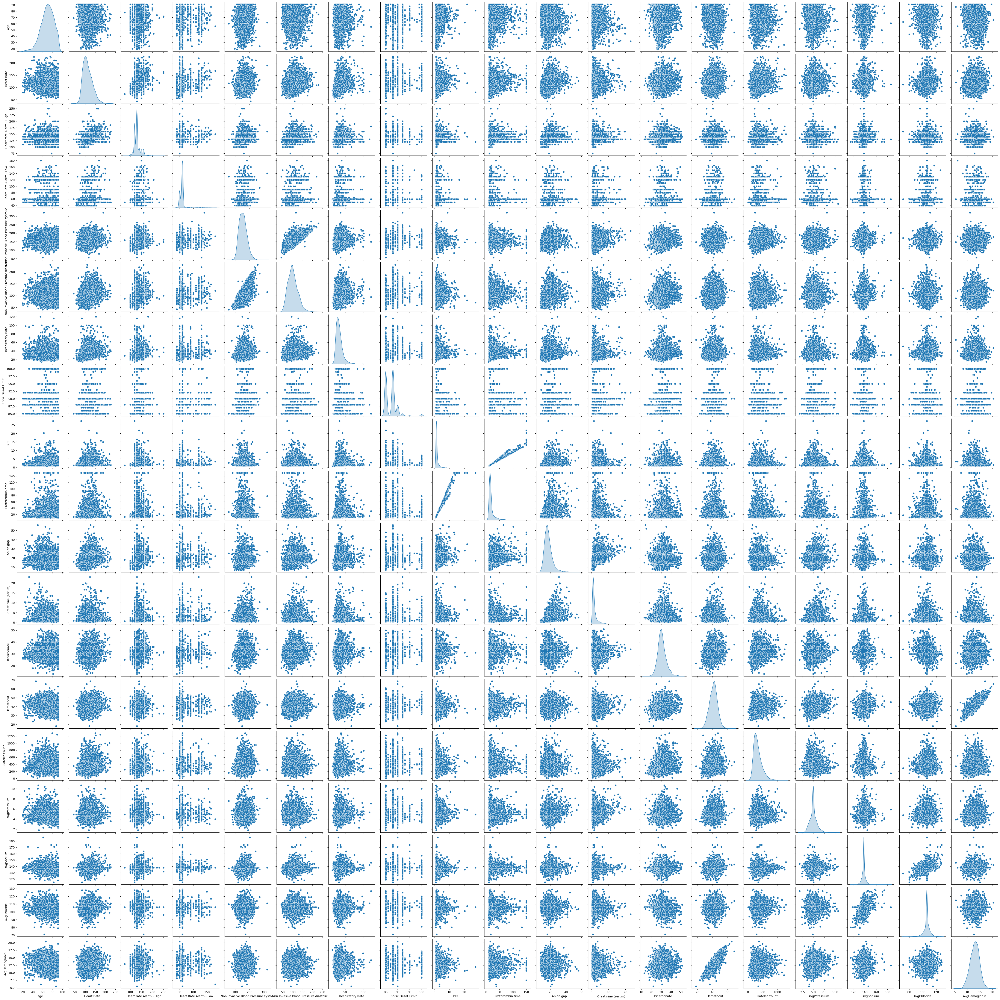

In [68]:
# Create the scatter plot matrix with correlations
sns.pairplot(mimic_iv_clean2_nona.dropna().select_dtypes(include=['int64', 'float64']).iloc[:, 1:], kind='scatter', diag_kind='kde')

# Display the plot
plt.show()

# PART 5: Binary Variables Handling

In [69]:
mimic_iv_binaryCom = mimic_iv_clean2_nona.copy()

In [70]:
myocardial_indices = list(range(20, 82))

systolic_indices = list(range(82, 89))

diastolic_indices = list(range(89, 94))

com_sys_dias_indices = list(range(94, 99))

fibrillation_indices = list(range(99, 110))

pulmonary_disease_indices = list(range(110, 114)) + list(range(142, 146))

stroke_indices = list(range(114, 136))

hyperlipidemia_indices = list(range(136, 142))

dementia_indices = list(range(146, 191))

mimic_iv_binaryCom['Myocardial'] = mimic_iv_clean2_nona.iloc[:,myocardial_indices].sum(axis=1)
                                                                                                 
mimic_iv_binaryCom['Systolic'] = mimic_iv_clean2_nona.iloc[:,systolic_indices].sum(axis=1)
                                                                                                 
mimic_iv_binaryCom['Diastolic'] = mimic_iv_clean2_nona.iloc[:,diastolic_indices].sum(axis=1)
                                                                                                 
mimic_iv_binaryCom['CombSysDias'] = mimic_iv_clean2_nona.iloc[:,com_sys_dias_indices].sum(axis=1)

mimic_iv_binaryCom['Fibrillation'] = mimic_iv_clean2_nona.iloc[:,fibrillation_indices].sum(axis=1)

mimic_iv_binaryCom['PulmonaryDisease'] = mimic_iv_clean2_nona.iloc[:,pulmonary_disease_indices].sum(axis=1)

mimic_iv_binaryCom['Stroke'] = mimic_iv_clean2_nona.iloc[:,stroke_indices].sum(axis=1)

mimic_iv_binaryCom['Hyperlipidemia'] = mimic_iv_clean2_nona.iloc[:,hyperlipidemia_indices].sum(axis=1)

mimic_iv_binaryCom['Dementia'] = mimic_iv_clean2_nona.iloc[:,dementia_indices].sum(axis=1)

In [71]:
start_index = 20  # Start index of the range to drop
end_index = 191   # End index (inclusive) of the range to drop

# Drop the columns within the specified range of column indices
mimic_iv_binaryCom = mimic_iv_binaryCom.drop(mimic_iv_clean2.columns[start_index:end_index], axis=1)


In [72]:
mimic_iv_binaryCom.head(5)

,subject_id,gender,age,mortality,ethnicity,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Non Invasive Blood Pressure systolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,SpO2 Desat Limit,INR,Prothrombin time,Anion gap,Creatinine (serum),Bicarbonate,GCS - Eye Opening,Hematocrit,Platelet Count,Age Group,AvgPotassium,AvgSodium,AvgChloride,AvgHemoglobin,Myocardial,Systolic,Diastolic,CombSysDias,Fibrillation,PulmonaryDisease,Stroke,Hyperlipidemia,Dementia
0,10002430,M,86,0,WHITE,103.0,140.0,60.0,126.0,91.0,36.0,86.0,1.3,13.9,20.0,2.4,31.0,4,45.0,231.0,66-100,4.9,138.0,106.0,15.30,0,1,1,0,1,2,0,2,0
1,10004401,M,82,1,WHITE,104.0,120.0,60.0,166.0,154.0,41.0,100.0,1.7,18.9,21.0,3.5,34.0,4,39.6,290.0,66-100,5.1,133.0,105.0,10.90,0,1,0,0,1,0,0,0,0
2,10004606,F,64,0,WHITE,116.0,130.0,130.0,204.0,161.0,41.0,88.0,1.1,12.2,20.0,0.9,30.0,4,48.4,306.0,51-65,4.5,138.0,106.0,16.20,0,0,0,0,0,2,0,1,0
3,10005348,M,76,0,WHITE,103.0,160.0,85.0,157.0,88.0,25.0,88.0,1.3,13.8,12.0,1.0,29.0,4,38.3,310.0,66-100,5.7,137.0,104.5,11.90,0,0,0,0,1,0,0,1,0
4,10010058,M,80,1,ASIAN - SOUTH EAST ASIAN,155.0,130.0,50.0,121.0,88.0,35.0,85.0,1.5,16.1,20.0,5.0,29.0,2,46.5,260.0,66-100,7.1,142.0,115.0,13.65,4,3,0,0,3,0,0,1,0


In [73]:
mimic_iv_binaryCom.shape

(5868, 34)

# PART 6: Transforming Categorical into Numerical

In [74]:
mimic_iv_catTransform = mimic_iv_binaryCom.copy()

In [75]:
# Define gender mappings
gender_map = {
    'F': 0,
    'M': 1
}

# Map the age groups to numbers
mimic_iv_catTransform['gender_number'] = mimic_iv_catTransform['gender'].map(gender_map)

In [76]:
# mimic_iv_catTransform['gender'] = pd.get_dummies(mimic_iv_catTransform['gender'], drop_first = True)

In [77]:
# Count the frequency of each level in the current column
level_counts = mimic_iv_catTransform['ethnicity'].value_counts()

# Calculate the number of distinct values
num_distinct_values = len(level_counts)

# Print the results
print("Column: ethnicity")
print(f"a) Number of distinct values: {num_distinct_values}")
print("b) Frequency of each level:")
print(level_counts)
print()

Column: ethnicity
a) Number of distinct values: 33
b) Frequency of each level:
ethnicity
WHITE                                        3930
UNKNOWN                                       646
BLACK/AFRICAN AMERICAN                        386
OTHER                                         168
WHITE - OTHER EUROPEAN                        154
WHITE - RUSSIAN                                88
HISPANIC/LATINO - PUERTO RICAN                 70
ASIAN - CHINESE                                57
UNABLE TO OBTAIN                               47
ASIAN                                          47
HISPANIC/LATINO - DOMINICAN                    39
PATIENT DECLINED TO ANSWER                     36
BLACK/CARIBBEAN ISLAND                         27
BLACK/CAPE VERDEAN                             21
WHITE - EASTERN EUROPEAN                       20
HISPANIC OR LATINO                             17
PORTUGUESE                                     15
ASIAN - ASIAN INDIAN                           14
BLACK/AFRIC

In [78]:
# Define categories
categories = {
    'ASIAN': ['ASIAN', 'ASIAN - CHINESE', 'ASIAN - ASIAN INDIAN', 'ASIAN - SOUTH EAST ASIAN'],
    'WHITE': ['WHITE', 'WHITE - OTHER EUROPEAN', 'WHITE - RUSSIAN', 'WHITE - EASTERN EUROPEAN'],
    'HISPANIC': ['HISPANIC', 'HISPANIC/LATINO - PUERTO RICAN', 'HISPANIC/LATINO - DOMINICAN', 'HISPANIC OR LATINO', 
                 'HISPANIC/LATINO - CENTRAL AMERICAN'],
    'BLACK': ['BLACK', 'BLACK/AFRICAN AMERICAN', 'BLACK/CARIBBEAN ISLAND', 'BLACK/CAPE VERDEAN', 'BLACK/AFRICAN'],
    'OTHERS': ['UNKNOWN', 'OTHER', 'UNABLE TO OBTAIN', 'PATIENT DECLINED TO ANSWER', 'PORTUGUESE', 'AMERICAN INDIAN/ALASKA NATIVE', 'MULTIPLE RACE/ETHNICITY']
}

# Function to categorize ethnicity
def categorize_ethnicity(ethnicity):
    for category, subcategories in categories.items():
        if any(subcategory in ethnicity for subcategory in subcategories):
            return category
    return "OTHERS"

# Apply categorization function
mimic_iv_catTransform['ethnicity'] = mimic_iv_catTransform['ethnicity'].apply(categorize_ethnicity)

# Count the frequency of each level in the current column
level_counts = mimic_iv_catTransform['ethnicity'].value_counts()

# Sort the categories by frequency
sorted_categories = level_counts.index.tolist()

# Assign numbers from 1 to 5 based on frequency
category_map = {category: i+1 for i, category in enumerate(sorted_categories)}

# Map the categories to numbers
mimic_iv_catTransform['ethnicity_number'] = mimic_iv_catTransform['ethnicity'].map(category_map)

# Create DataFrame for the additional table
additional_table = pd.DataFrame({'ethnicity': sorted_categories, 'ethnicity_number': range(1, len(sorted_categories)+1), 'count': level_counts})

# Set index name to None
additional_table.index.name = None

print("\nAdditional Table:")
print(additional_table)


Additional Table:
         ethnicity  ethnicity_number  count
WHITE        WHITE                 1   4199
OTHERS      OTHERS                 2    936
BLACK        BLACK                 3    448
HISPANIC  HISPANIC                 4    151
ASIAN        ASIAN                 5    134


In [79]:
# Count the frequency of each level in the current column
level_counts = mimic_iv_catTransform['Age Group'].value_counts()

# Calculate the number of distinct values
num_distinct_values = len(level_counts)

# Print the results
print("Column: Age Group")
print(f"a) Number of distinct values: {num_distinct_values}")
print("b) Frequency of each level:")
print(level_counts)
print()

Column: Age Group
a) Number of distinct values: 4
b) Frequency of each level:
Age Group
66-100    3768
51-65     1628
36-50      385
19-35       87
Name: count, dtype: int64



In [80]:
# Define age group mappings
age_group_map = {
    '19-35': 1,
    '36-50': 2,
    '51-65': 3,
    '66-100': 4
}

# Map the age groups to numbers
mimic_iv_catTransform['age_group_number'] = mimic_iv_catTransform['Age Group'].map(age_group_map)

In [81]:
mimic_iv_catTransform = mimic_iv_catTransform.drop('gender', axis=1)
mimic_iv_catTransform = mimic_iv_catTransform.drop('ethnicity', axis=1)
mimic_iv_catTransform = mimic_iv_catTransform.drop('Age Group', axis=1)

In [82]:
mimic_iv_catTransform.head(10)

,subject_id,age,mortality,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Non Invasive Blood Pressure systolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,SpO2 Desat Limit,INR,Prothrombin time,Anion gap,Creatinine (serum),Bicarbonate,GCS - Eye Opening,Hematocrit,Platelet Count,AvgPotassium,AvgSodium,AvgChloride,AvgHemoglobin,Myocardial,Systolic,Diastolic,CombSysDias,Fibrillation,PulmonaryDisease,Stroke,Hyperlipidemia,Dementia,gender_number,ethnicity_number,age_group_number
0,10002430,86,0,103.0,140.0,60.0,126.0,91.0,36.0,86.0,1.3,13.9,20.0,2.4,31.0,4,45.0,231.0,4.9,138.0,106.0,15.30,0,1,1,0,1,2,0,2,0,1,1,4
1,10004401,82,1,104.0,120.0,60.0,166.0,154.0,41.0,100.0,1.7,18.9,21.0,3.5,34.0,4,39.6,290.0,5.1,133.0,105.0,10.90,0,1,0,0,1,0,0,0,0,1,1,4
2,10004606,64,0,116.0,130.0,130.0,204.0,161.0,41.0,88.0,1.1,12.2,20.0,0.9,30.0,4,48.4,306.0,4.5,138.0,106.0,16.20,0,0,0,0,0,2,0,1,0,0,1,3
3,10005348,76,0,103.0,160.0,85.0,157.0,88.0,25.0,88.0,1.3,13.8,12.0,1.0,29.0,4,38.3,310.0,5.7,137.0,104.5,11.90,0,0,0,0,1,0,0,1,0,1,1,4
4,10010058,80,1,155.0,130.0,50.0,121.0,88.0,35.0,85.0,1.5,16.1,20.0,5.0,29.0,2,46.5,260.0,7.1,142.0,115.0,13.65,4,3,0,0,3,0,0,1,0,1,5,4
5,10011189,59,0,102.0,155.0,40.0,134.0,72.0,20.0,85.0,1.5,16.3,13.0,0.8,27.0,4,44.0,235.0,4.9,138.0,106.0,14.80,0,0,0,0,0,0,0,1,0,1,2,3
6,10012853,91,0,106.0,130.0,50.0,164.0,88.0,30.0,90.0,2.3,25.9,15.0,1.0,38.0,4,42.8,419.0,3.5,146.0,106.0,12.35,0,1,0,0,3,2,0,2,0,0,3,4
7,10013049,52,0,91.0,120.0,50.0,127.0,71.0,22.0,85.0,1.6,16.5,12.0,0.8,30.0,4,45.3,272.0,5.6,138.5,107.0,14.25,0,0,0,0,0,0,0,0,0,1,1,3
8,10014354,60,0,141.0,160.0,50.0,187.0,156.0,54.0,90.0,1.6,17.6,17.0,2.2,36.0,4,36.3,348.0,5.4,138.0,103.0,12.00,2,1,2,0,3,2,0,1,1,1,1,3
9,10018423,37,0,105.0,120.0,50.0,128.0,67.0,36.0,85.0,1.6,17.8,13.0,1.0,29.0,4,46.7,350.0,5.0,137.0,107.0,14.50,0,0,0,0,0,0,0,0,0,1,1,2


In [83]:
mimic_iv_FINAL = mimic_iv_catTransform.copy()

In [84]:
mimic_iv_FINAL.head(5)

,subject_id,age,mortality,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Non Invasive Blood Pressure systolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,SpO2 Desat Limit,INR,Prothrombin time,Anion gap,Creatinine (serum),Bicarbonate,GCS - Eye Opening,Hematocrit,Platelet Count,AvgPotassium,AvgSodium,AvgChloride,AvgHemoglobin,Myocardial,Systolic,Diastolic,CombSysDias,Fibrillation,PulmonaryDisease,Stroke,Hyperlipidemia,Dementia,gender_number,ethnicity_number,age_group_number
0,10002430,86,0,103.0,140.0,60.0,126.0,91.0,36.0,86.0,1.3,13.9,20.0,2.4,31.0,4,45.0,231.0,4.9,138.0,106.0,15.30,0,1,1,0,1,2,0,2,0,1,1,4
1,10004401,82,1,104.0,120.0,60.0,166.0,154.0,41.0,100.0,1.7,18.9,21.0,3.5,34.0,4,39.6,290.0,5.1,133.0,105.0,10.90,0,1,0,0,1,0,0,0,0,1,1,4
2,10004606,64,0,116.0,130.0,130.0,204.0,161.0,41.0,88.0,1.1,12.2,20.0,0.9,30.0,4,48.4,306.0,4.5,138.0,106.0,16.20,0,0,0,0,0,2,0,1,0,0,1,3
3,10005348,76,0,103.0,160.0,85.0,157.0,88.0,25.0,88.0,1.3,13.8,12.0,1.0,29.0,4,38.3,310.0,5.7,137.0,104.5,11.90,0,0,0,0,1,0,0,1,0,1,1,4
4,10010058,80,1,155.0,130.0,50.0,121.0,88.0,35.0,85.0,1.5,16.1,20.0,5.0,29.0,2,46.5,260.0,7.1,142.0,115.0,13.65,4,3,0,0,3,0,0,1,0,1,5,4


# PART 7: Univariate Data Distributions

In [85]:
mimic_iv_FINAL.shape

(5868, 34)

In [97]:
mimic_iv_FINAL['GCS - Eye Opening'] = mimic_iv_FINAL['GCS - Eye Opening'].astype('int64')

for col in mimic_iv_FINAL.columns[22:32]:
    mimic_iv_FINAL[col] = mimic_iv_FINAL[col].astype('float64')

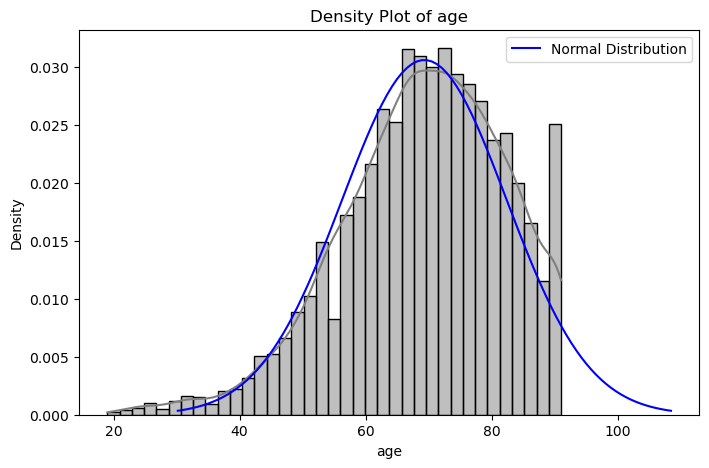

Shapiro-Wilk test for age:
  Test Statistic: 0.9754637479782104
  p-value: 1.3045217829436854e-30
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for age:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



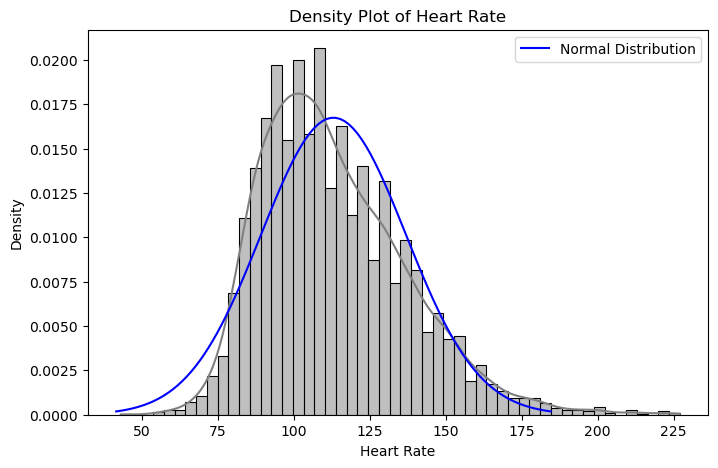

Shapiro-Wilk test for Heart Rate:
  Test Statistic: 0.9619584679603577
  p-value: 1.0930044616448977e-36
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Heart Rate:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



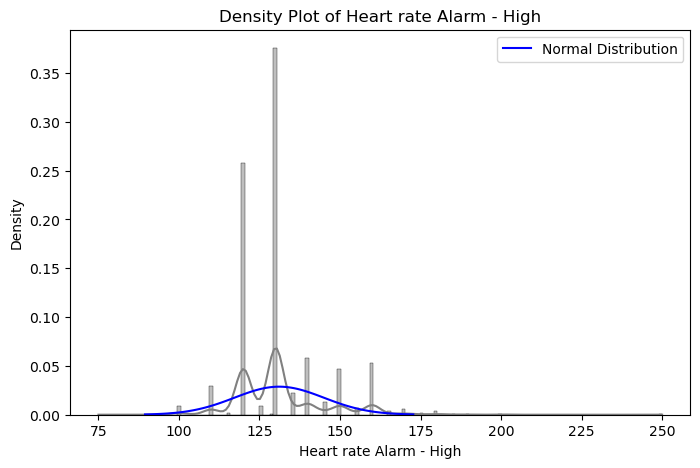

Shapiro-Wilk test for Heart rate Alarm - High:
  Test Statistic: 0.8443231582641602
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Heart rate Alarm - High:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



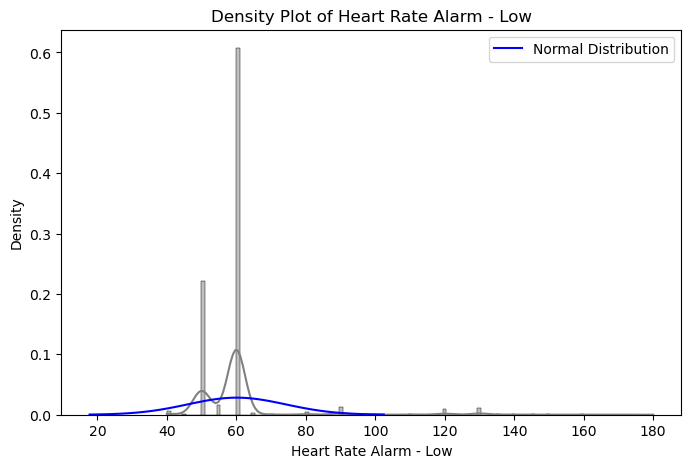

Shapiro-Wilk test for Heart Rate Alarm - Low:
  Test Statistic: 0.4619264006614685
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Heart Rate Alarm - Low:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



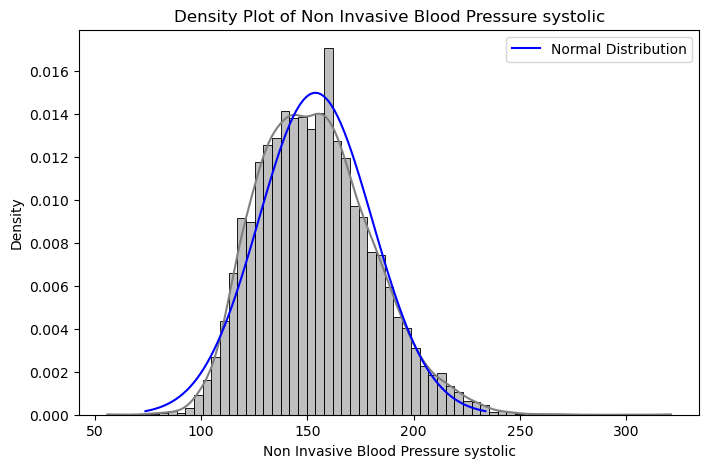

Shapiro-Wilk test for Non Invasive Blood Pressure systolic:
  Test Statistic: 0.9872870445251465
  p-value: 1.4039946967086728e-22
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Non Invasive Blood Pressure systolic:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



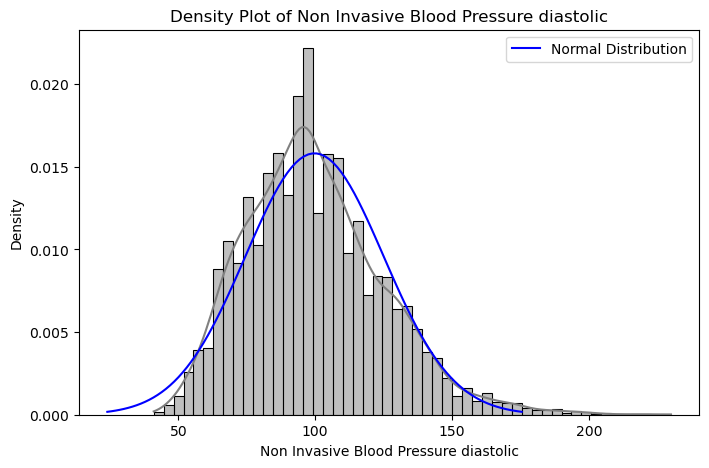

Shapiro-Wilk test for Non Invasive Blood Pressure diastolic:
  Test Statistic: 0.9771631956100464
  p-value: 1.135529574148568e-29
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Non Invasive Blood Pressure diastolic:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



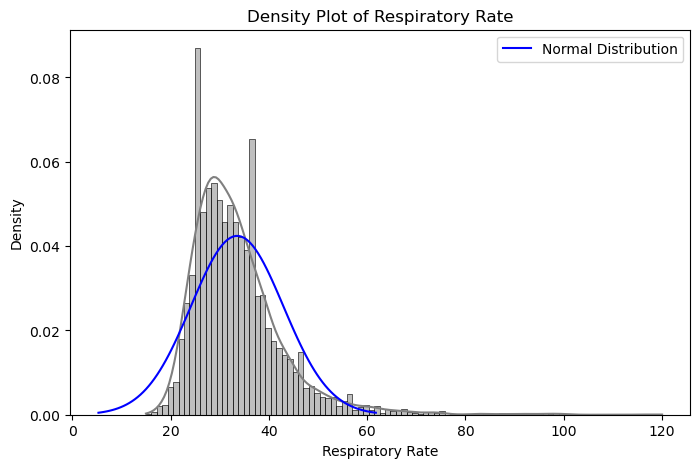

Shapiro-Wilk test for Respiratory Rate:
  Test Statistic: 0.8561781048774719
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Respiratory Rate:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



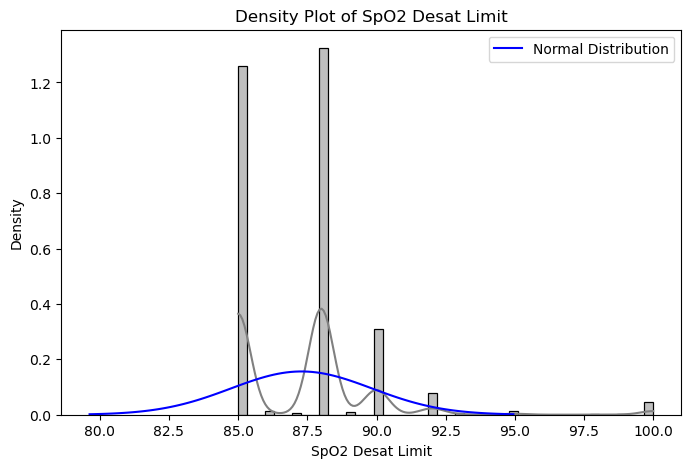

Shapiro-Wilk test for SpO2 Desat Limit:
  Test Statistic: 0.7257684469223022
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for SpO2 Desat Limit:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



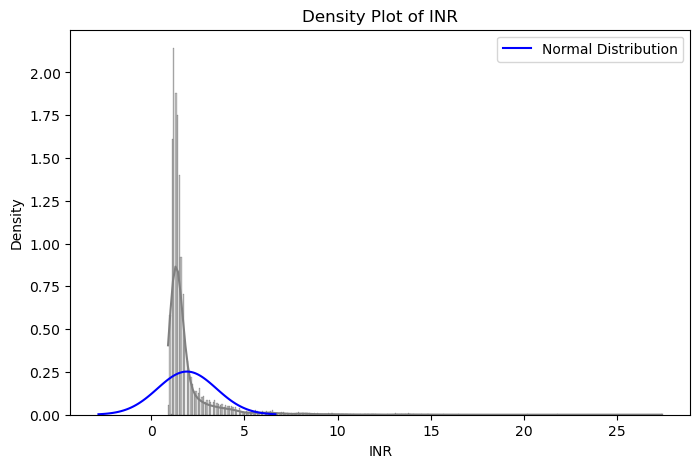

Shapiro-Wilk test for INR:
  Test Statistic: 0.5047265291213989
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for INR:
  Test Statistic: 0.8374251823330283
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



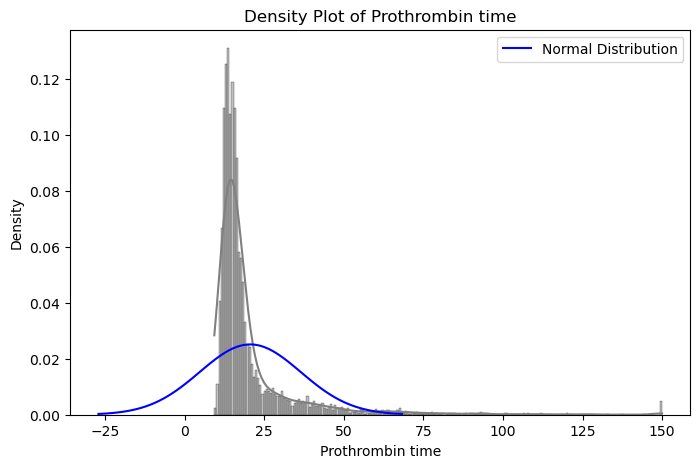

Shapiro-Wilk test for Prothrombin time:
  Test Statistic: 0.5275113582611084
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Prothrombin time:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



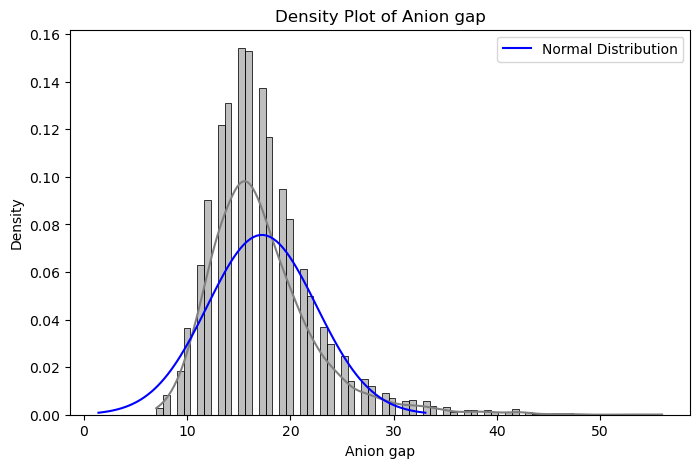

Shapiro-Wilk test for Anion gap:
  Test Statistic: 0.8982256650924683
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Anion gap:
  Test Statistic: 0.9999999999987201
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



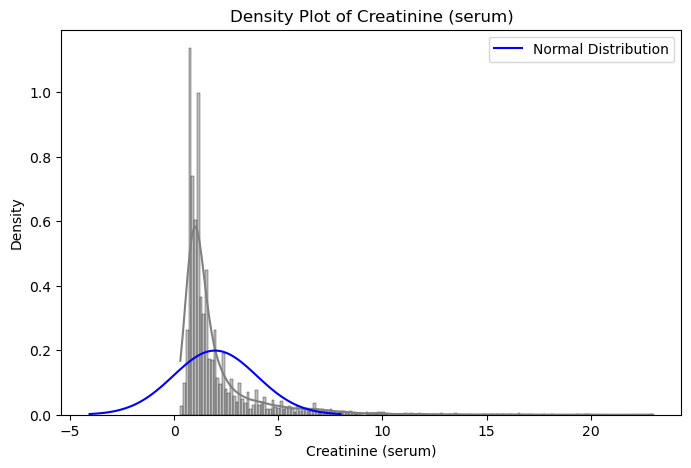

Shapiro-Wilk test for Creatinine (serum):
  Test Statistic: 0.6257439851760864
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Creatinine (serum):
  Test Statistic: 0.7093869640495174
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



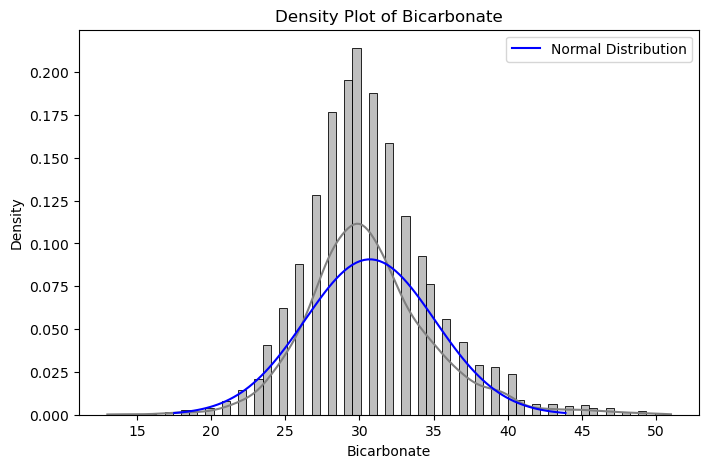

Shapiro-Wilk test for Bicarbonate:
  Test Statistic: 0.9651785492897034
  p-value: 2.0448754512026214e-35
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Bicarbonate:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



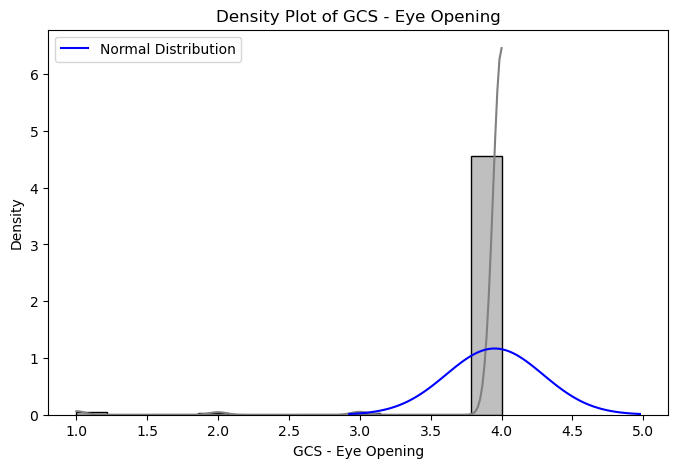

Shapiro-Wilk test for GCS - Eye Opening:
  Test Statistic: 0.12693309783935547
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for GCS - Eye Opening:
  Test Statistic: 0.9824605995825485
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



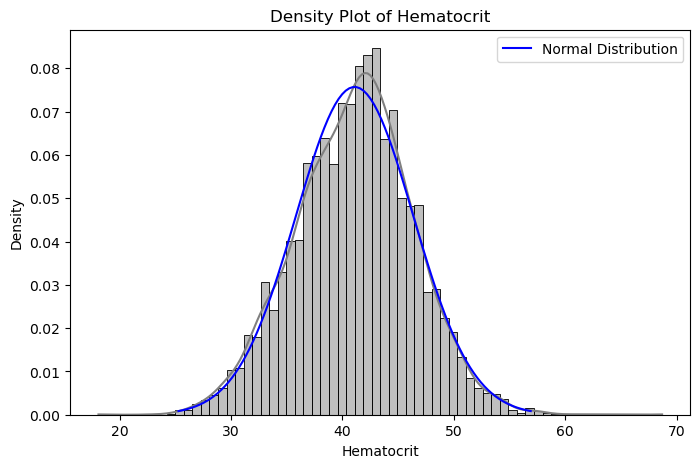

Shapiro-Wilk test for Hematocrit:
  Test Statistic: 0.9983446598052979
  p-value: 7.389046913885977e-06
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Hematocrit:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



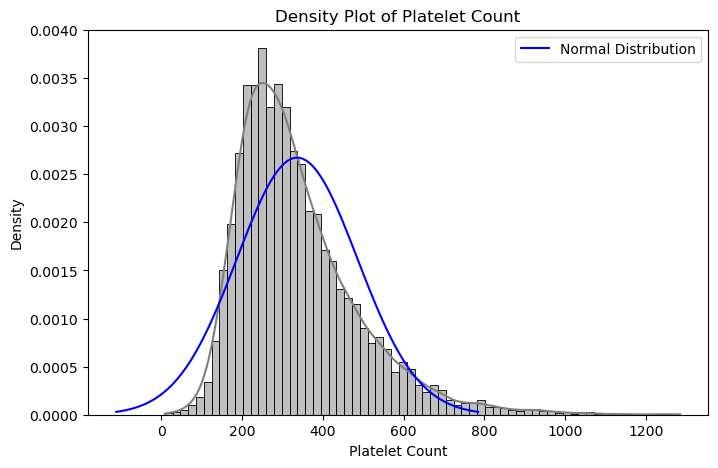

Shapiro-Wilk test for Platelet Count:
  Test Statistic: 0.9083859920501709
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Platelet Count:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



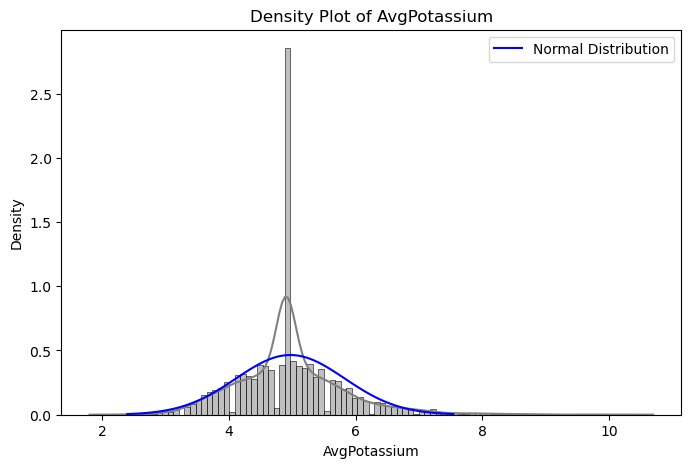

Shapiro-Wilk test for AvgPotassium:
  Test Statistic: 0.9332745671272278
  p-value: 2.802596928649634e-45
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for AvgPotassium:
  Test Statistic: 0.995577949480802
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



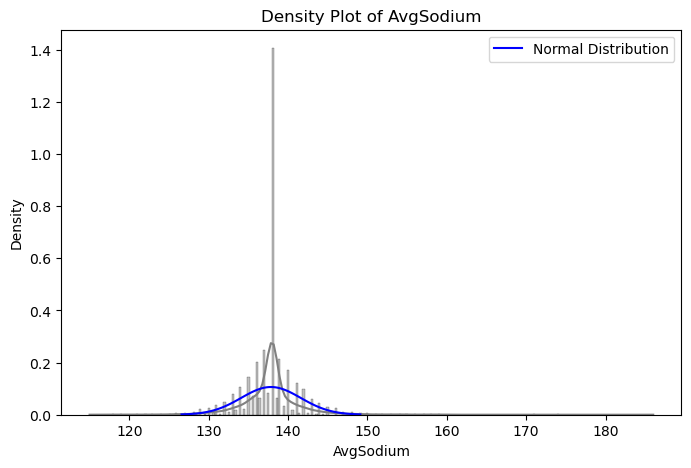

Shapiro-Wilk test for AvgSodium:
  Test Statistic: 0.814526379108429
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for AvgSodium:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



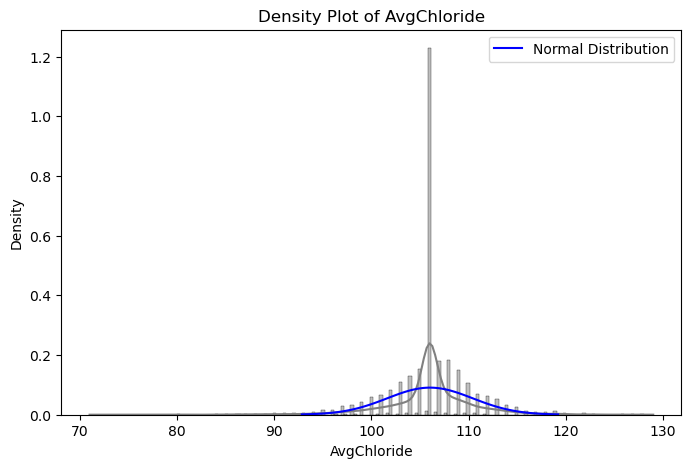

Shapiro-Wilk test for AvgChloride:
  Test Statistic: 0.8738106489181519
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for AvgChloride:
  Test Statistic: 1.0
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



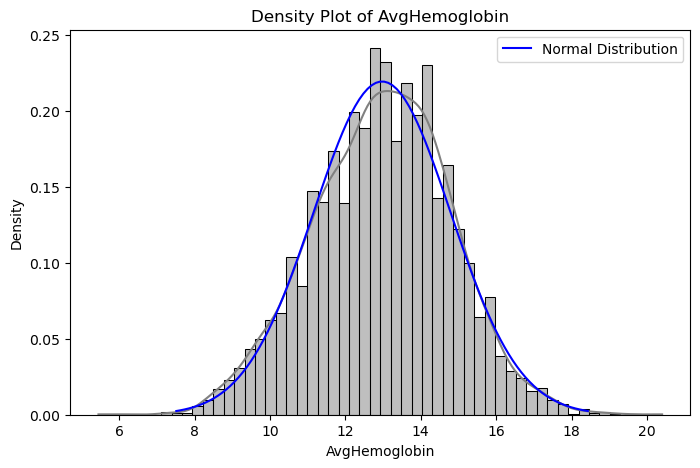

Shapiro-Wilk test for AvgHemoglobin:
  Test Statistic: 0.9986594915390015
  p-value: 7.976417691679671e-05
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for AvgHemoglobin:
  Test Statistic: 0.99999997481509
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



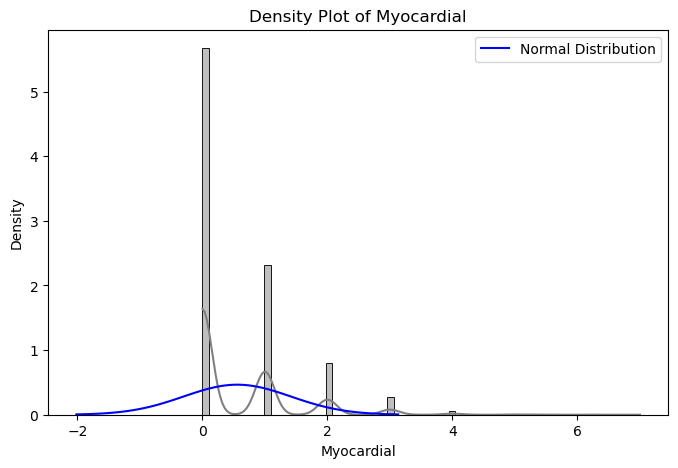

Shapiro-Wilk test for Myocardial:
  Test Statistic: 0.678012490272522
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Myocardial:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



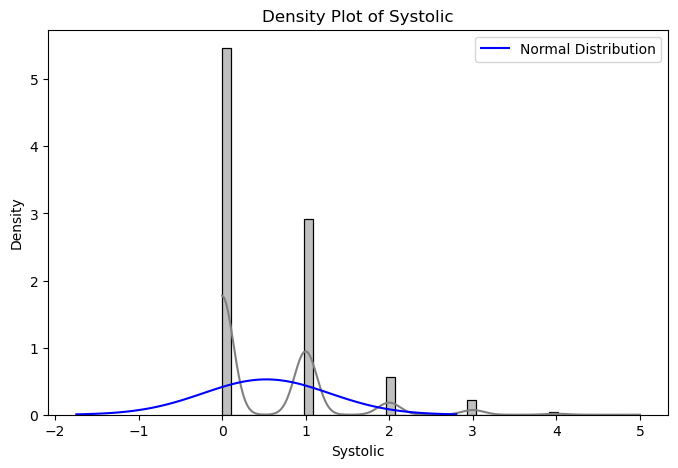

Shapiro-Wilk test for Systolic:
  Test Statistic: 0.691300630569458
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Systolic:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



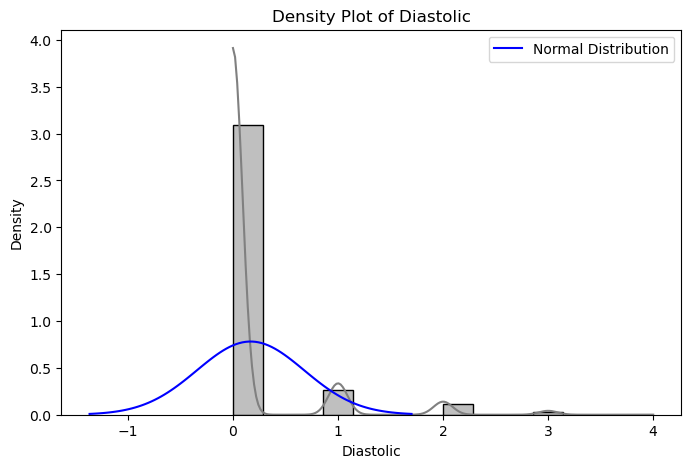

Shapiro-Wilk test for Diastolic:
  Test Statistic: 0.3695753216743469
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Diastolic:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



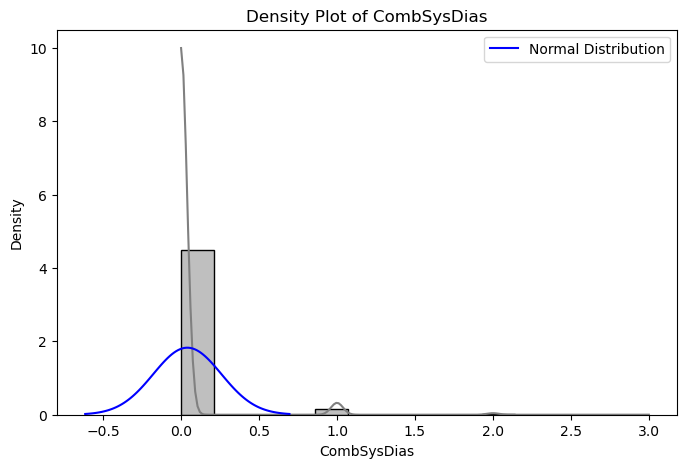

Shapiro-Wilk test for CombSysDias:
  Test Statistic: 0.17603743076324463
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for CombSysDias:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



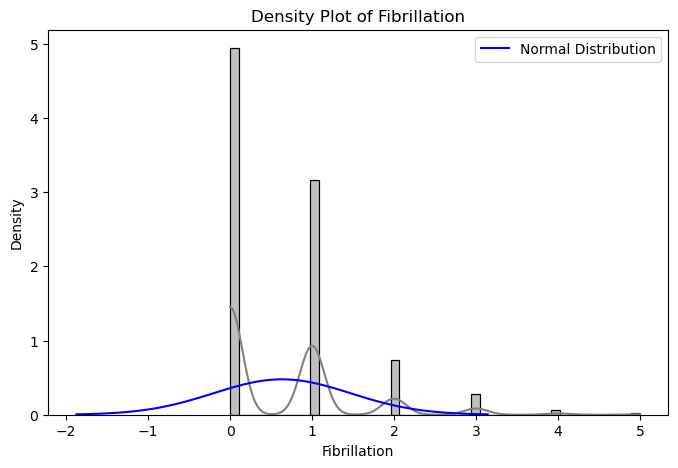

Shapiro-Wilk test for Fibrillation:
  Test Statistic: 0.7255825400352478
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Fibrillation:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



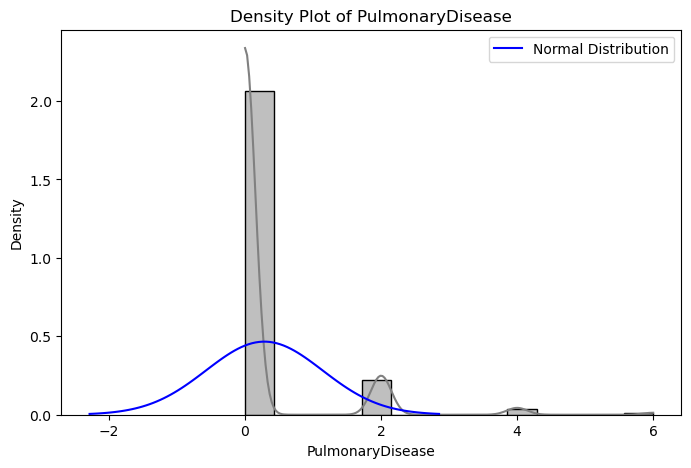

Shapiro-Wilk test for PulmonaryDisease:
  Test Statistic: 0.3679957985877991
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for PulmonaryDisease:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



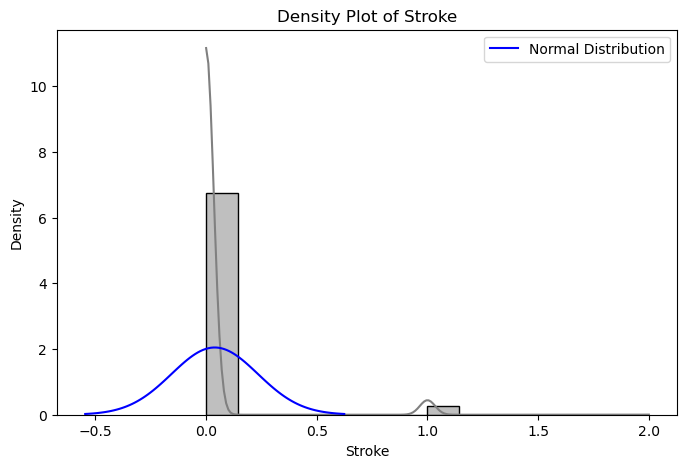

Shapiro-Wilk test for Stroke:
  Test Statistic: 0.189172625541687
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Stroke:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



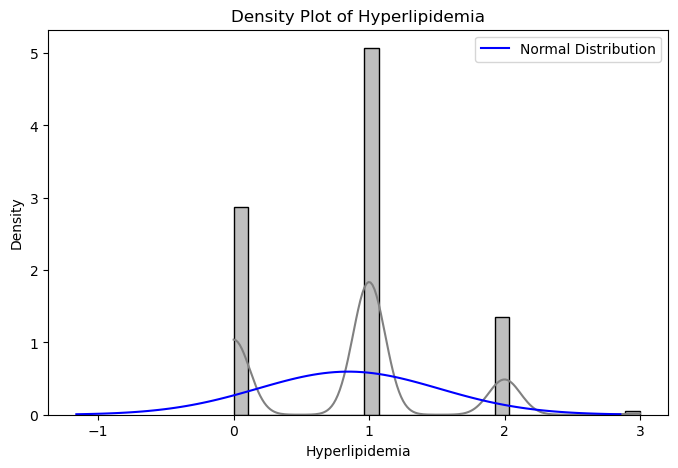

Shapiro-Wilk test for Hyperlipidemia:
  Test Statistic: 0.7987034320831299
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Hyperlipidemia:
  Test Statistic: 0.5339146165525238
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



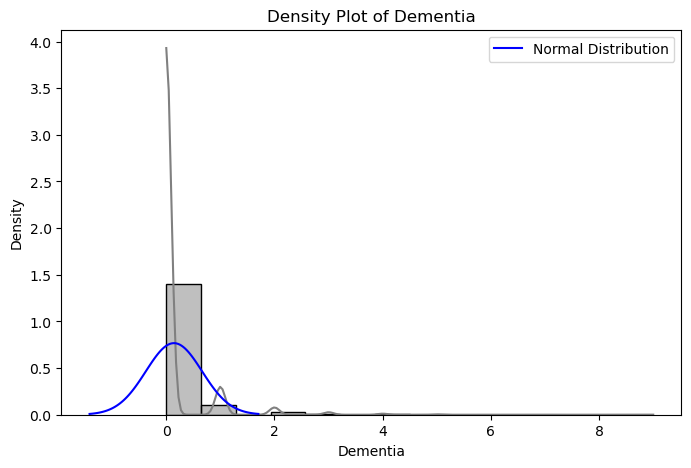

Shapiro-Wilk test for Dementia:
  Test Statistic: 0.3000473976135254
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for Dementia:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



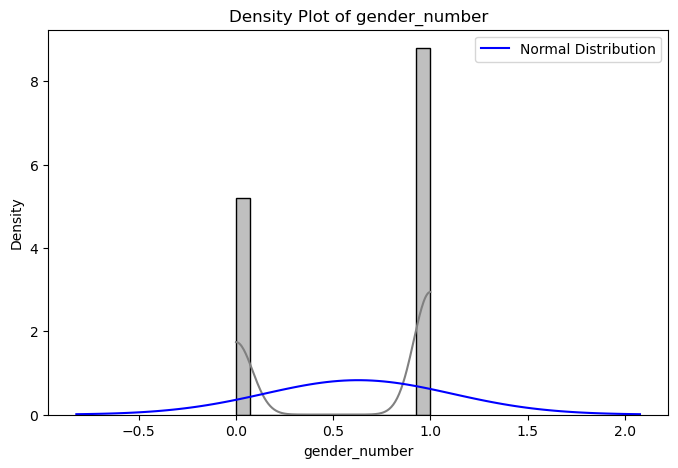

Shapiro-Wilk test for gender_number:
  Test Statistic: 0.6121234893798828
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for gender_number:
  Test Statistic: 0.5
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



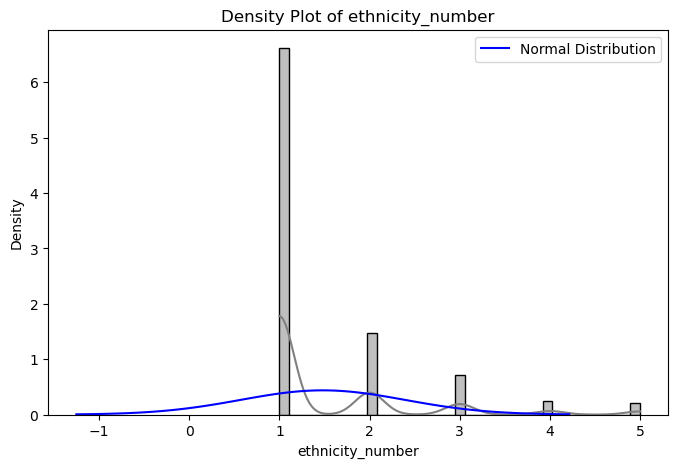

Shapiro-Wilk test for ethnicity_number:
  Test Statistic: 0.5895470380783081
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for ethnicity_number:
  Test Statistic: 0.8413447460685429
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



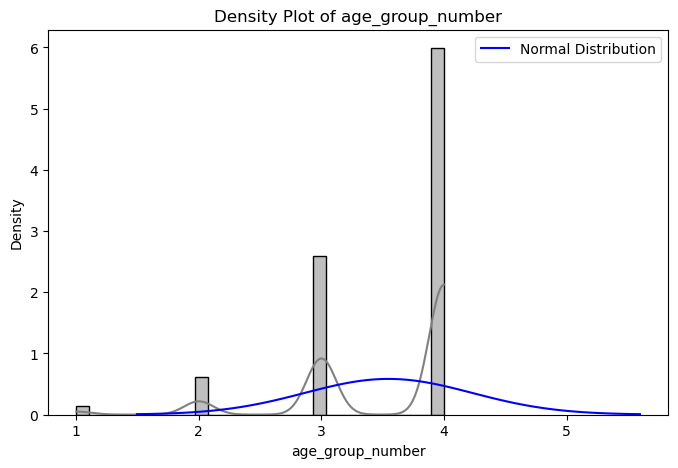

Shapiro-Wilk test for age_group_number:
  Test Statistic: 0.6702992916107178
  p-value: 0.0
  The data does not appear to be normally distributed (reject H0)

Kolmogorov-Smirnov test for age_group_number:
  Test Statistic: 0.9624236921827002
  p-value: 0.0
  The data may not come from a normal distribution (reject H0)



In [98]:
# Select numerical columns
numerical_cols = mimic_iv_FINAL.select_dtypes(include=['int64', 'float64']).iloc[:, 1:].columns

for col in numerical_cols:
    # Create density plot
    plt.figure(figsize=(8, 5))
    sns.histplot(mimic_iv_FINAL[col], kde=True, color='gray', stat='density')
    plt.title(f'Density Plot of {col}')
    plt.xlabel(col)
    plt.ylabel('Density')
    
    # Overlay normal distribution curve
    mu, sigma = mimic_iv_FINAL[col].mean(), mimic_iv_FINAL[col].std()
    x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
    plt.plot(x, norm.pdf(x, mu, sigma), color='blue', label='Normal Distribution')
    plt.legend()
    
    plt.show()
    
    # Shapiro-Wilk test for normality
    stat_sw, p_value_sw = shapiro(mimic_iv_FINAL[col].dropna())
    print(f"Shapiro-Wilk test for {col}:")
    print(f"  Test Statistic: {stat_sw}")
    print(f"  p-value: {p_value_sw}")
    if p_value_sw > 0.05:
        print("  The data appears to be normally distributed (fail to reject H0)")
    else:
        print("  The data does not appear to be normally distributed (reject H0)")
    print()
    
    # Kolmogorov-Smirnov test for normality
    kstest_result = kstest(mimic_iv_FINAL[col].dropna(), 'norm')
    print(f"Kolmogorov-Smirnov test for {col}:")
    print(f"  Test Statistic: {kstest_result.statistic}")
    print(f"  p-value: {kstest_result.pvalue}")
    if kstest_result.pvalue > 0.05:
        print("  The data may come from a normal distribution (fail to reject H0)")
    else:
        print("  The data may not come from a normal distribution (reject H0)")
    print()

# PART 8: 

In [99]:
mimic_iv_FINAL.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5868 entries, 0 to 6376
Data columns (total 34 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   subject_id                             5868 non-null   int64  
 1   age                                    5868 non-null   int64  
 2   mortality                              5868 non-null   object 
 3   Heart Rate                             5868 non-null   float64
 4   Heart rate Alarm - High                5868 non-null   float64
 5   Heart Rate Alarm - Low                 5868 non-null   float64
 6   Non Invasive Blood Pressure systolic   5868 non-null   float64
 7   Non Invasive Blood Pressure diastolic  5868 non-null   float64
 8   Respiratory Rate                       5868 non-null   float64
 9   SpO2 Desat Limit                       5868 non-null   float64
 10  INR                                    5868 non-null   float64
 11  Prothromb

In [100]:
mimic_iv_FINAL.describe()

,subject_id,age,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Non Invasive Blood Pressure systolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,SpO2 Desat Limit,INR,Prothrombin time,Anion gap,Creatinine (serum),Bicarbonate,GCS - Eye Opening,Hematocrit,Platelet Count,AvgPotassium,AvgSodium,AvgChloride,AvgHemoglobin,Myocardial,Systolic,Diastolic,CombSysDias,Fibrillation,PulmonaryDisease,Stroke,Hyperlipidemia,Dementia,gender_number,ethnicity_number,age_group_number
count,5.868000e+03,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000,5868.000000
mean,1.497930e+07,69.310498,113.012100,131.100375,60.096302,153.847991,99.760566,33.556578,87.288378,1.913727,20.580215,17.241990,1.965593,30.699216,3.950579,41.095637,336.697853,4.970245,137.845262,106.025392,12.972418,0.556578,0.529141,0.167519,0.040048,0.632754,0.283231,0.038855,0.846796,0.142127,0.628494,1.480743,3.546864
std,2.859783e+06,13.044445,23.836212,13.883662,14.114384,26.638998,25.233400,9.404334,2.552628,1.581760,15.895422,5.276897,2.007199,4.396028,0.341860,5.269699,149.301739,0.858262,3.753255,4.395613,1.819222,0.858113,0.757668,0.510722,0.218299,0.836526,0.856230,0.195021,0.669437,0.519841,0.483249,0.911531,0.684150
min,1.000243e+07,19.000000,43.000000,75.000000,40.000000,56.000000,41.000000,15.000000,85.000000,0.900000,9.300000,7.000000,0.300000,13.000000,1.000000,18.100000,9.000000,1.800000,115.000000,71.000000,5.450000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,1.251433e+07,61.000000,95.750000,120.000000,50.000000,134.000000,82.000000,27.000000,85.000000,1.200000,13.400000,14.000000,0.900000,28.000000,4.000000,37.600000,231.000000,4.500000,136.500000,105.000000,11.700000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000
50%,1.498202e+07,70.000000,109.000000,130.000000,60.000000,152.000000,97.000000,32.000000,88.000000,1.400000,15.600000,16.000000,1.200000,30.000000,4.000000,41.300000,304.000000,4.900000,138.000000,106.000000,13.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,4.000000
75%,1.743484e+07,79.000000,128.000000,130.000000,60.000000,171.000000,115.000000,37.000000,88.000000,1.800000,19.500000,20.000000,2.100000,33.000000,4.000000,44.600000,407.000000,5.300000,139.000000,108.000000,14.200000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000,2.000000,4.000000
max,1.999729e+07,91.000000,227.000000,250.000000,180.000000,321.010000,230.000000,120.000000,100.000000,27.400000,150.000000,56.000000,23.000000,51.000000,4.000000,68.700000,1284.000000,10.700000,186.000000,129.000000,20.400000,7.000000,5.000000,4.000000,3.000000,5.000000,6.000000,2.000000,3.000000,9.000000,1.000000,5.000000,4.000000


In [101]:
file_path = "MIMIC_IV_FINAL_V2.csv"

mimic_iv_FINAL.to_csv(file_path, index=False)

In [102]:
# Create the scatter plot matrix with correlations
sns.pairplot(mimic_iv_FINAL.select_dtypes(include=['int64', 'float64']).iloc[:, 1:], kind='scatter', diag_kind='kde')

# Display the plot
plt.show()

In [110]:
features_selected = ['subject_id', 'mortality', 'age', 'Heart Rate', 'Non Invasive Blood Pressure systolic', 'Non Invasive Blood Pressure diastolic',
                     'Respiratory Rate', 'INR', 'Prothrombin time', 'Anion gap', 'Creatinine (serum)', 'Bicarbonate',
                     'Hematocrit', 'Platelet Count', 'AvgPotassium', 'AvgSodium', 'AvgChloride', 'AvgHemoglobin']

In [111]:
mimic_iv_FINAL_Red = mimic_iv_FINAL.copy()

In [112]:
mimic_iv_FINAL_Red = mimic_iv_FINAL_Red[features_selected]

In [113]:
file_path = "MIMIC_IV_FINAL_V2_ReducedFeatures.csv"

mimic_iv_FINAL_Red.to_csv(file_path, index=False)